In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
data = pd.read_csv('/content/drive/MyDrive/EP_Battery_Thing_HMD8310.csv', parse_dates=['time'])
data

<ipython-input-5-d6476e7e02cd>:1: DtypeWarning: Columns (4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,107) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('/content/drive/MyDrive/EP_Battery_Thing_HMD8310.csv', parse_dates=['time'])
/usr/local/lib/python3.10/dist-packages/IPython/lib/pretty.py:700: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  output = repr(obj)
/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  df_html=dataframe._repr_html_(),  # pylint: disable=protected-access


,time,AVG_PACK_SOC,AvgSOC,AvgSOH,BATT_PACK_1_DISCONN,BATT_PACK_1_FAULT,BATT_PACK_1_WARN,BATT_PACK_2_DISCONN,BATT_PACK_2_FAULT,BATT_PACK_2_WARN,...,PACK_1_STATUS,PACK_2_STATUS,PACK_3_STATUS,PACK_4_STATUS,PACK_5_STATUS,PACK_6_STATUS,PACK_7_STATUS,RunningState,Voltage,valuestreamname
0,2022-08-30 00:00:00+00:00,NaN,77.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,900.0,ISS.Onshore.Model.VS
1,2022-08-30 00:01:00+00:00,NaN,77.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,900.0,ISS.Onshore.Model.VS
2,2022-08-30 00:02:00+00:00,NaN,77.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,900.0,ISS.Onshore.Model.VS
3,2022-08-30 00:03:00+00:00,NaN,77.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,900.0,ISS.Onshore.Model.VS
4,2022-08-30 00:04:00+00:00,NaN,77.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,900.0,ISS.Onshore.Model.VS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273956,2023-03-20 02:28:00+00:00,86.0,85.0,100.0,False,False,False,False,False,False,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True,921.0,ISS.Onshore.Model.VS
273957,2023-03-20 02:29:00+00:00,86.0,85.0,100.0,False,False,False,False,False,False,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True,921.0,ISS.Onshore.Model.VS
273958,2023-03-20 02:30:00+00:00,86.0,85.0,100.0,False,False,False,False,False,False,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True,921.0,ISS.Onshore.Model.VS
273959,2023-03-20 02:31:00+00:00,86.0,85.0,100.0,False,False,False,False,False,False,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True,920.0,ISS.Onshore.Model.VS


# FAULT

In [54]:
from functools import reduce

a = data['BATT_PACK_1_FAULT'].fillna(False)
b = data['BATT_PACK_2_FAULT'].fillna(False)
c = data['BATT_PACK_3_FAULT'].fillna(False)
d = data['BATT_PACK_4_FAULT'].fillna(False)
e = data['BATT_PACK_5_FAULT'].fillna(False)
f = data['BATT_PACK_6_FAULT'].fillna(False)
g = data['BATT_PACK_7_FAULT'].fillna(False)

lists = [a, b, c, d, e, f, g]

result = reduce(lambda x, y: [x_i or y_i for x_i, y_i in zip(x, y)], lists)

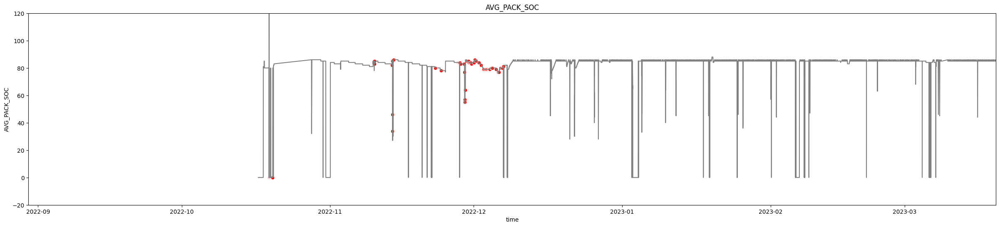

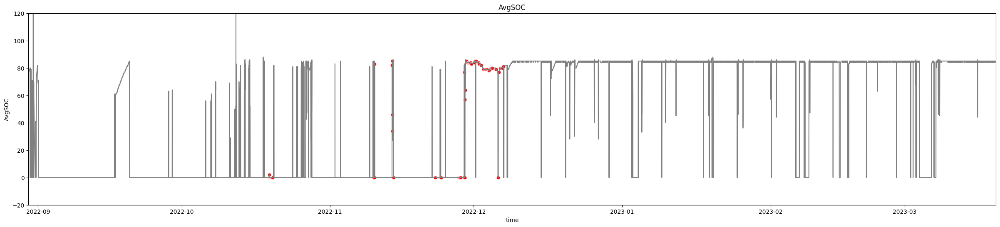

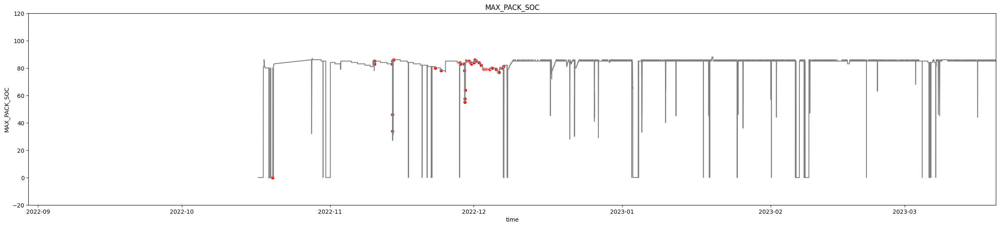

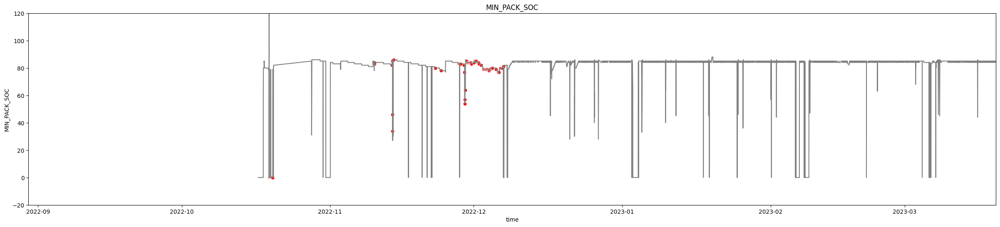

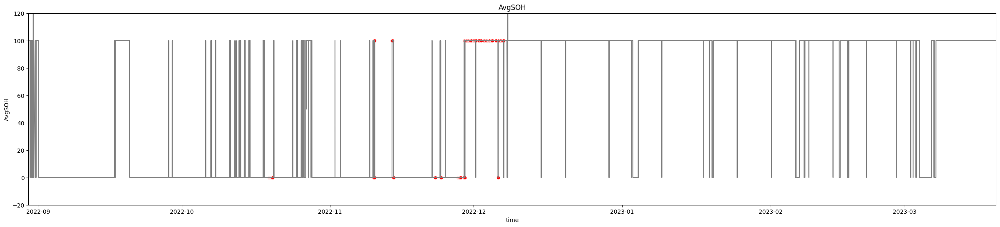

...

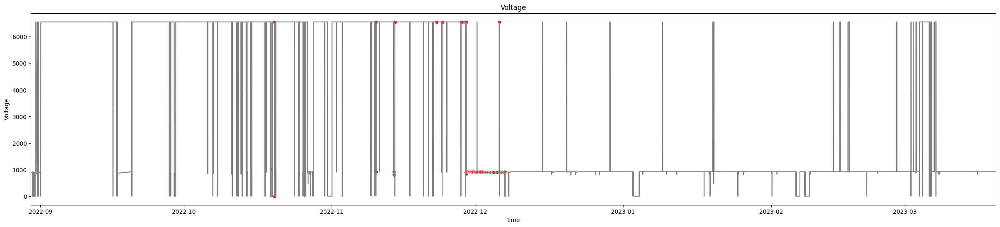

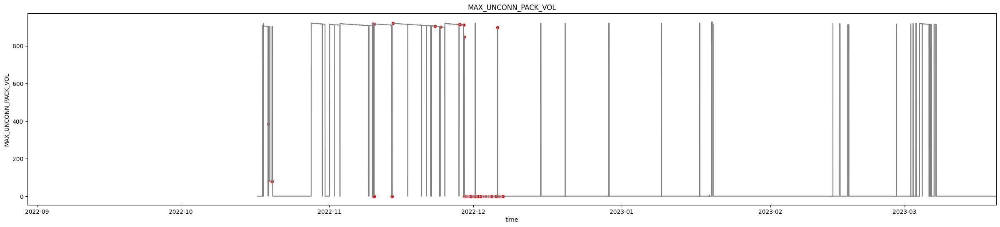

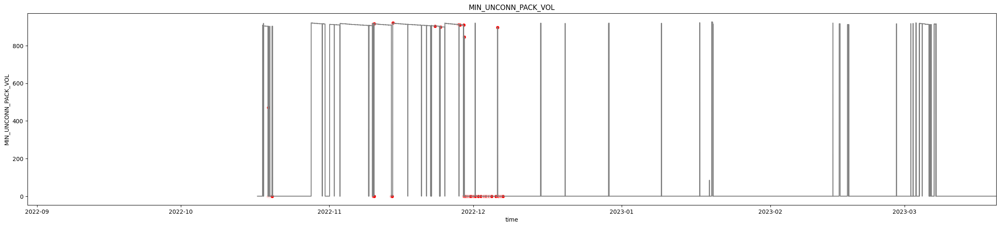

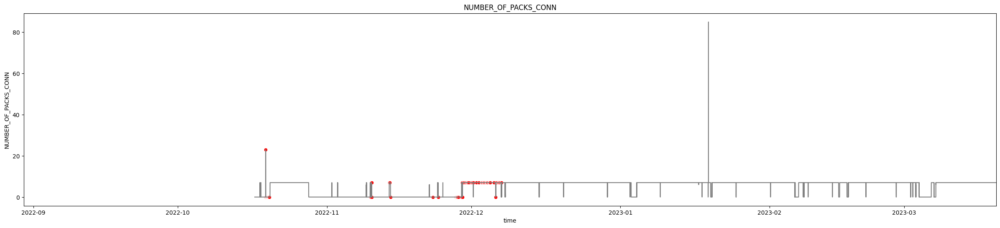

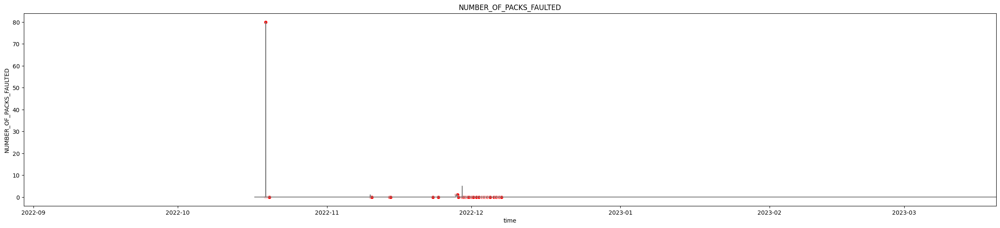

In [56]:
packs_list = ['AVG_PACK_SOC',
 'AvgSOC',
 'MAX_PACK_SOC', 'MIN_PACK_SOC',
 'AvgSOH',
 'BATT_ROOM_TEMP',
 'MAX_CELL_TEMP', 'MIN_CELL_TEMP',
 'Current',

 'MAX_CELL_VOL', 'MIN_CELL_VOL',
 'Voltage',
 'MAX_UNCONN_PACK_VOL', 'MIN_UNCONN_PACK_VOL',




 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED']

for i in range(len(packs_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=packs_list[i], color='grey')
  sns.scatterplot(data=data[result], x='time', y=packs_list[i], color='red', marker='o')
  y_range = data[packs_list[i]].max() - data[packs_list[i]].min()
  if packs_list[i] == 'Current':
    plt.ylim(-2000, 2000)
  elif packs_list[i] == 'AVG_PACK_SOC' or packs_list[i] == 'AvgSOC' or packs_list[i] == 'AvgSOH' or packs_list[i] == 'MAX_PACK_SOC' or packs_list[i] == 'MIN_PACK_SOC':
    plt.ylim(-20, 120)
  else:
    pass
  # plt.xlim(data['time'][90400], data['time'][130000])
  plt.xlim(data['time'][0], data['time'][273960])
  plt.title(packs_list[i])
  plt.show()

In [24]:
a = data['BATT_PACK_1_FAULT'].fillna(False)
b = data['BATT_PACK_2_FAULT'].fillna(False)
c = data['BATT_PACK_3_FAULT'].fillna(False)
d = data['BATT_PACK_4_FAULT'].fillna(False)
e = data['BATT_PACK_5_FAULT'].fillna(False)
f = data['BATT_PACK_6_FAULT'].fillna(False)
g = data['BATT_PACK_7_FAULT'].fillna(False)

lists = [a, b, c, d, e, f, g]
sum_of_trues = [sum(1 for x in sublist if x) for sublist in zip(*lists)]

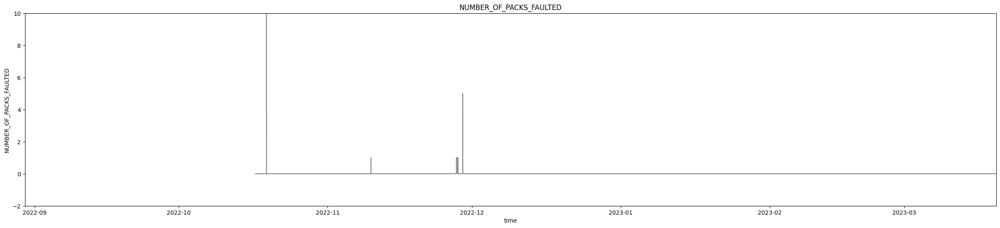

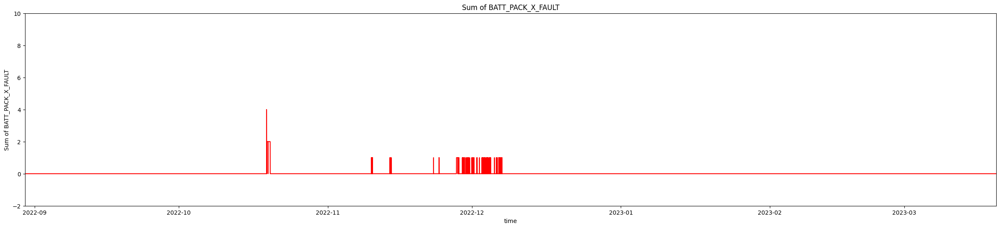

In [30]:
packs_list = ['NUMBER_OF_PACKS_FAULTED']

for i in range(len(packs_list)):
  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=packs_list[i], color='grey')
  plt.ylim(-2, 10)
  # plt.xlim(data['time'][90400], data['time'][130000])
  plt.xlim(data['time'][0], data['time'][273960])
  plt.title(packs_list[i])
  plt.show()

plt.figure(figsize=(30, 6))
sns.lineplot(x=data['time'], y=sum_of_trues, color='red')
plt.ylim(-2, 10)
# plt.xlim(data['time'][90400], data['time'][130000])
plt.xlim(data['time'][0], data['time'][273960])
plt.title('Sum of BATT_PACK_X_FAULT')
plt.ylabel('Sum of BATT_PACK_X_FAULT')
plt.show()

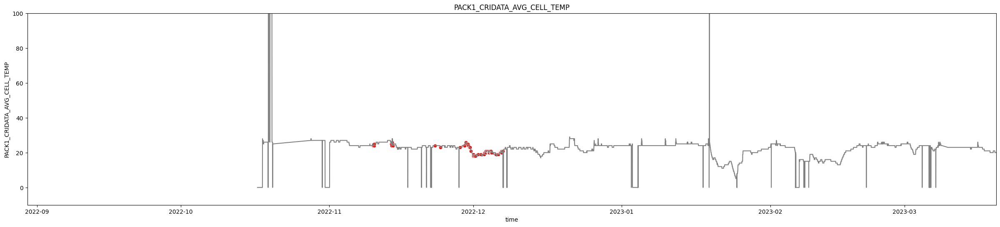

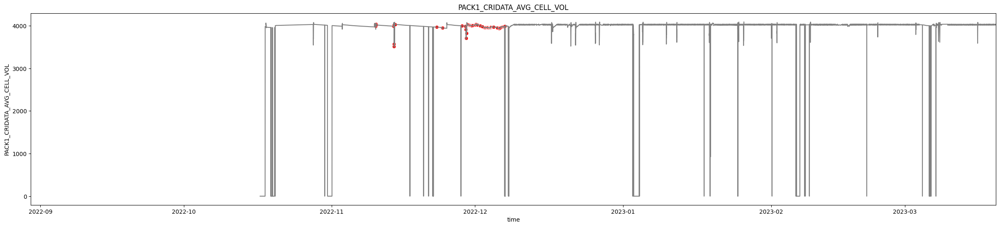

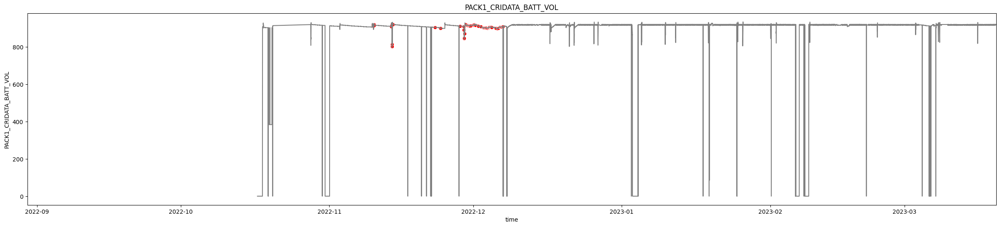

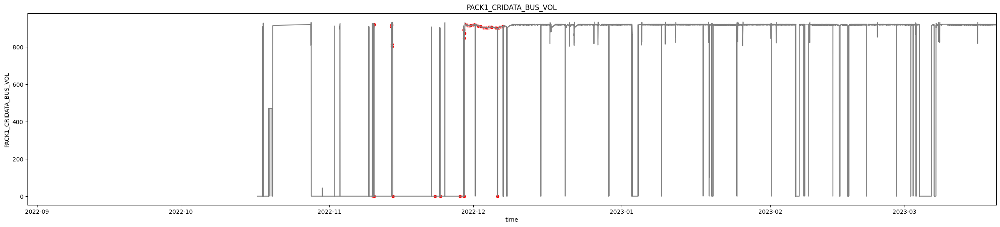

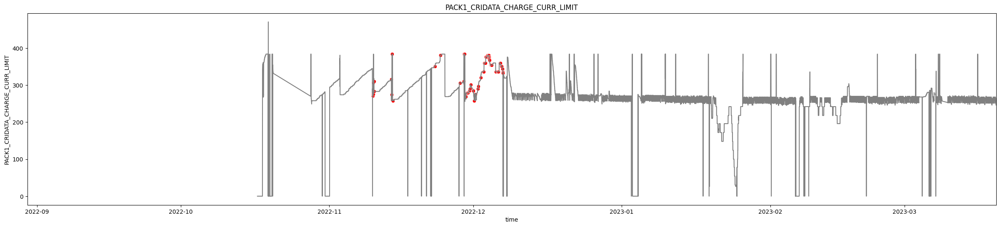

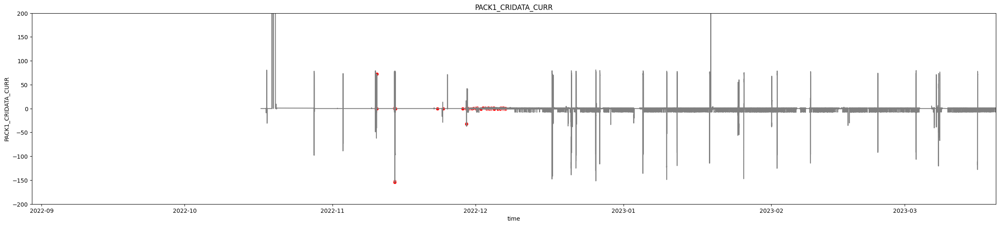

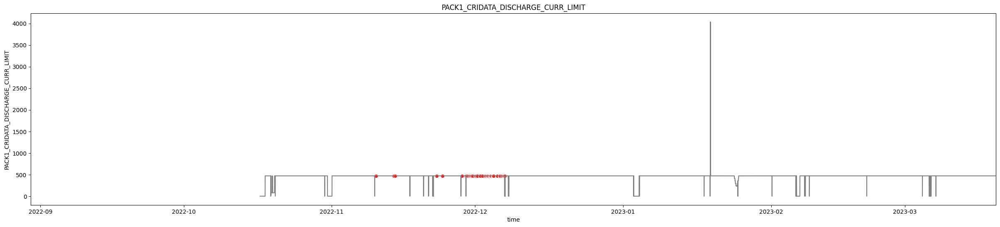

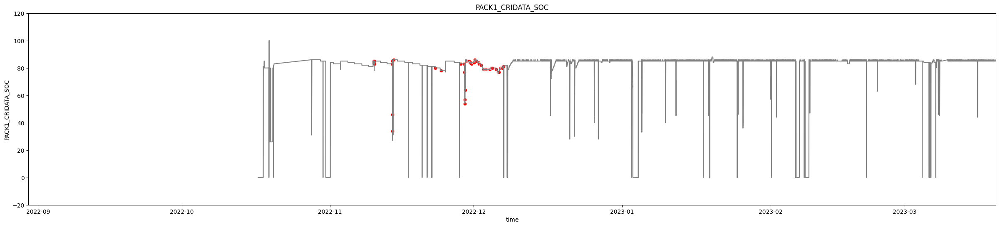

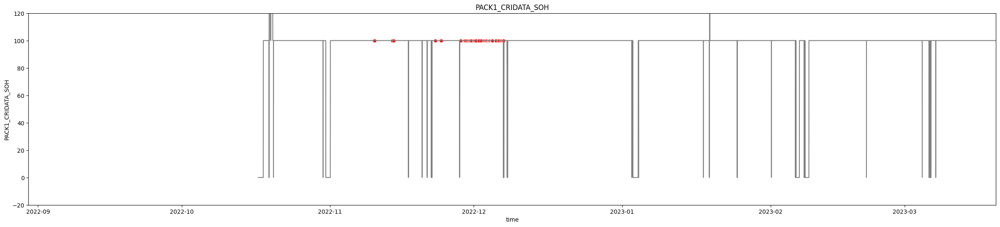

In [53]:
# pack1_list = ['BATT_ROOM_TEMP',
#  'Voltage',
#  'Current',
#  'MAX_CELL_TEMP',
#  'MAX_CELL_VOL',
#  'MAX_PACK_SOC',
#  'MAX_UNCONN_PACK_VOL',
#  'MIN_CELL_TEMP',
#  'MIN_CELL_VOL',
#  'MIN_PACK_SOC',
#  'MIN_UNCONN_PACK_VOL',
#  'NUMBER_OF_PACKS_CONN',
#  'NUMBER_OF_PACKS_FAULTED',
pack1_list = [
 'PACK1_CRIDATA_AVG_CELL_TEMP',
 'PACK1_CRIDATA_AVG_CELL_VOL',
 'PACK1_CRIDATA_BATT_VOL',
 'PACK1_CRIDATA_BUS_VOL',
 'PACK1_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_CURR',
 'PACK1_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_SOC',
 'PACK1_CRIDATA_SOH']

for i in range(len(pack1_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack1_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_1_FAULT'].fillna(False)], x='time', y=pack1_list[i], color='red', marker='o')
  if pack1_list[i] == 'PACK1_CRIDATA_CURR':
    plt.ylim(-200, 200)
  elif pack1_list[i] == 'PACK1_CRIDATA_SOC' or pack1_list[i] == 'PACK1_CRIDATA_SOH':
    plt.ylim(-20, 120)
  elif pack1_list[i] == 'PACK1_CRIDATA_AVG_CELL_TEMP':
    plt.ylim(-10, 100)
  else:
    pass
  plt.xlim(data['time'][0], data['time'][273960])
  #plt.xlim(data['time'][90400], data['time'][130000])
  plt.title(pack1_list[i])
  plt.show()

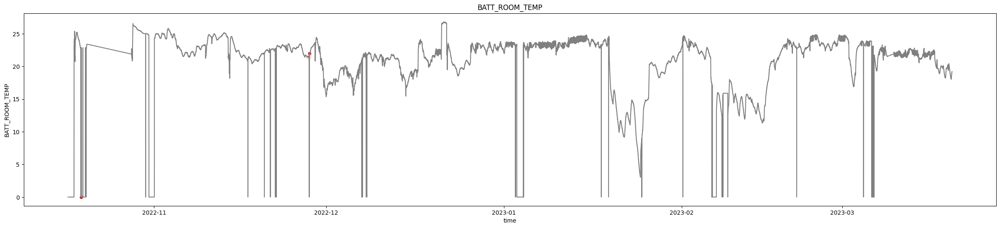

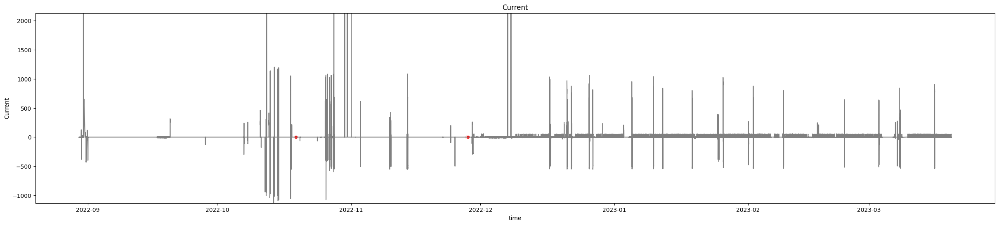

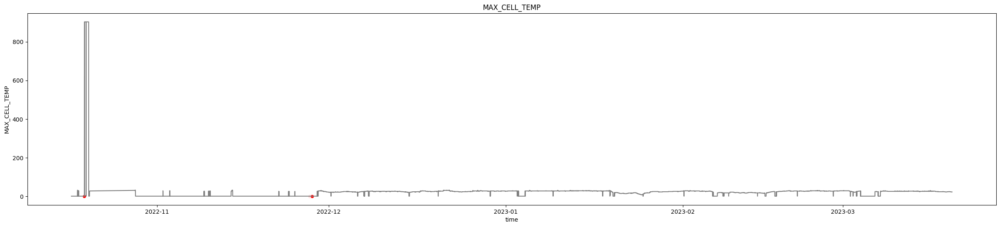

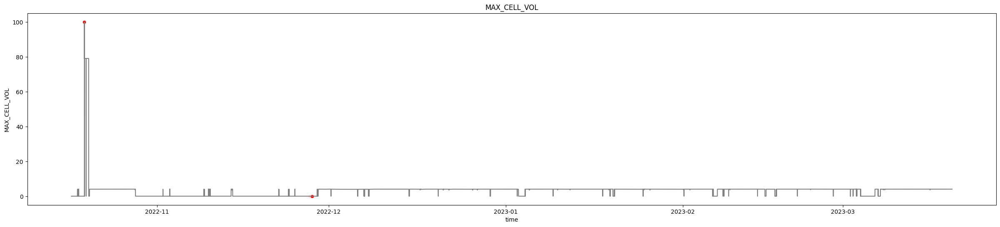

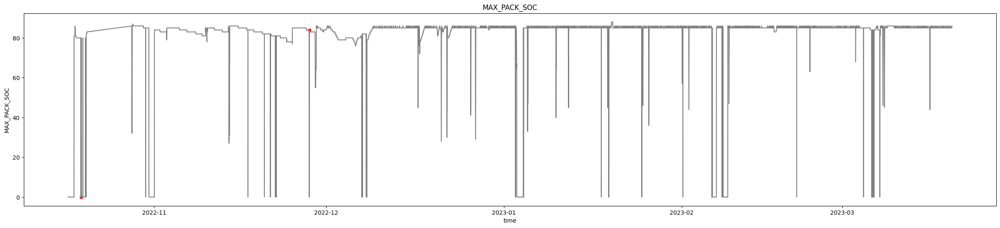

...

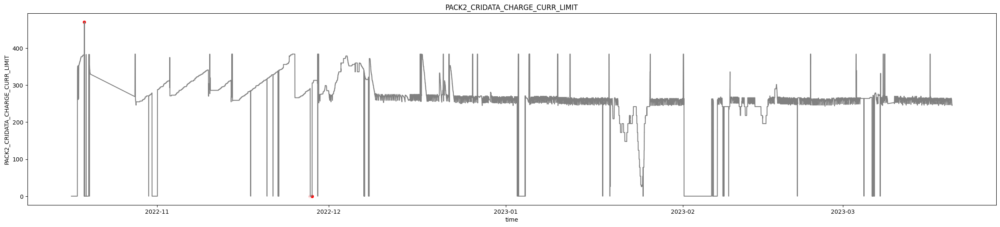

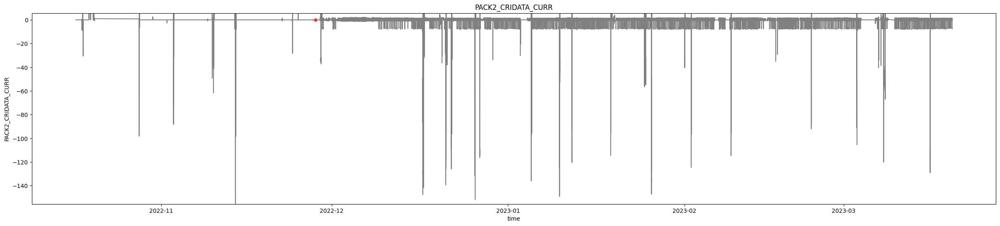

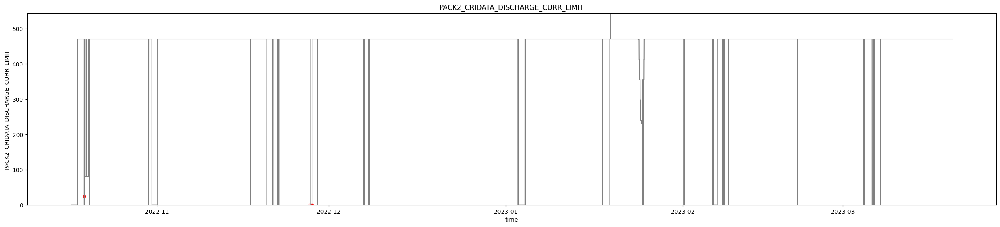

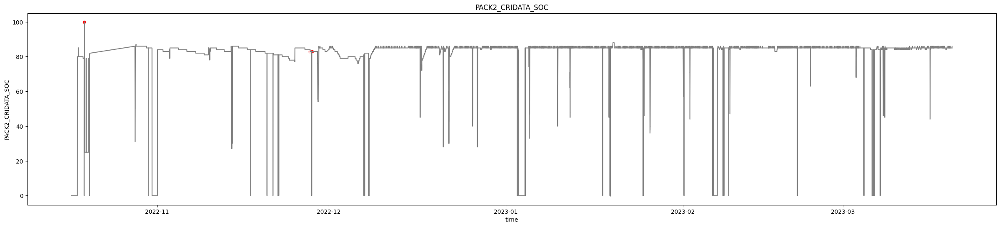

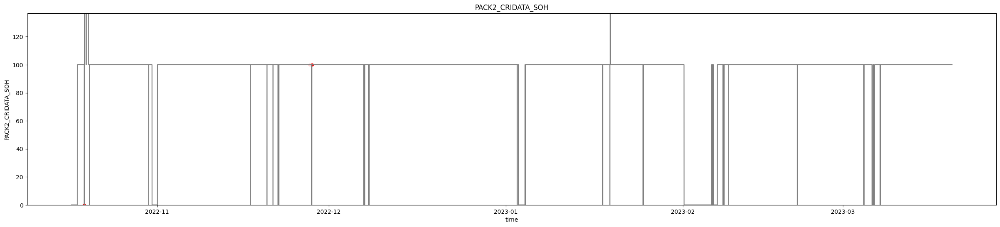

In [31]:
# @title
pack2_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK2_CRIDATA_AVG_CELL_TEMP',
 'PACK2_CRIDATA_AVG_CELL_VOL',
 'PACK2_CRIDATA_BATT_VOL',
 'PACK2_CRIDATA_BUS_VOL',
 'PACK2_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_CURR',
 'PACK2_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_SOC',
 'PACK2_CRIDATA_SOH']

for i in range(len(pack2_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack2_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_2_FAULT'].fillna(False)], x='time', y=pack2_list[i], color='red', marker='o')
  y_range = data[pack2_list[i]].max() - data[pack2_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack2_list[i]].min(), 1.2 * data[pack2_list[i]].mean())
  else:
    pass
  plt.title(pack2_list[i])
  plt.show()

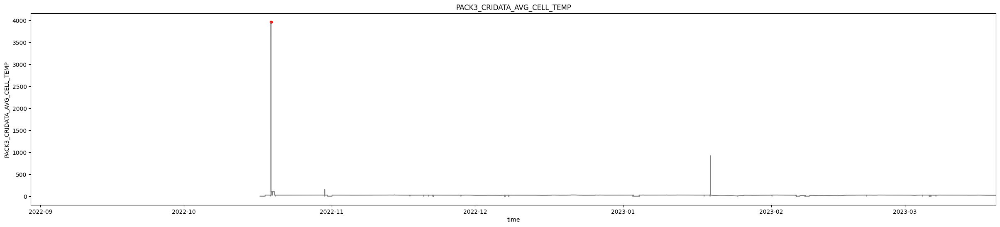

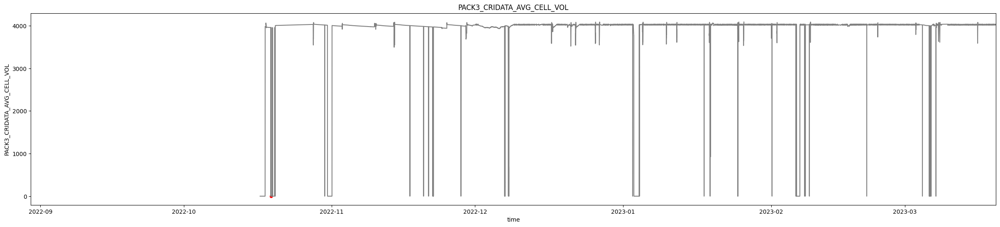

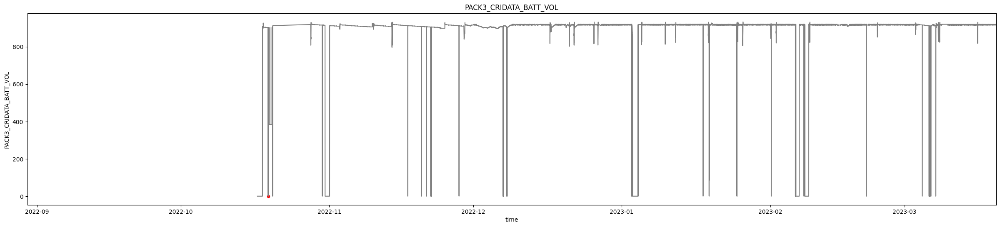

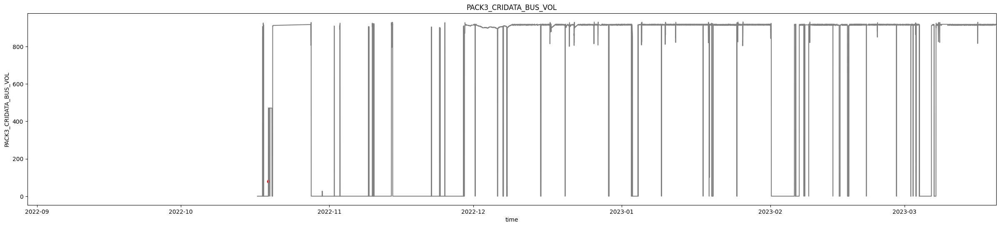

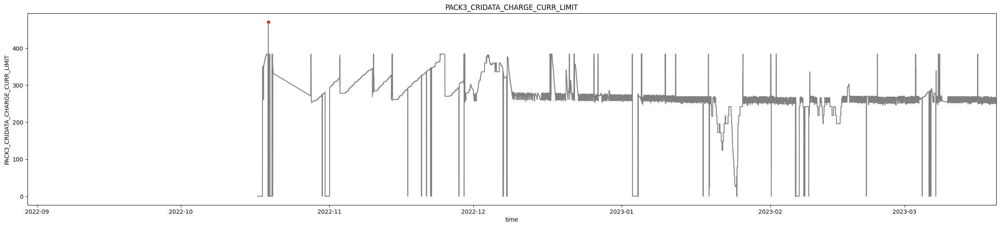

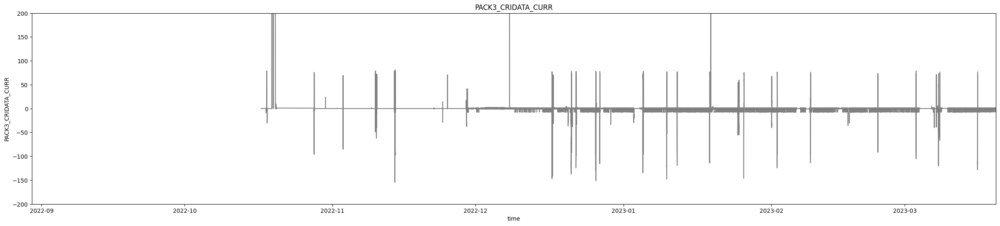

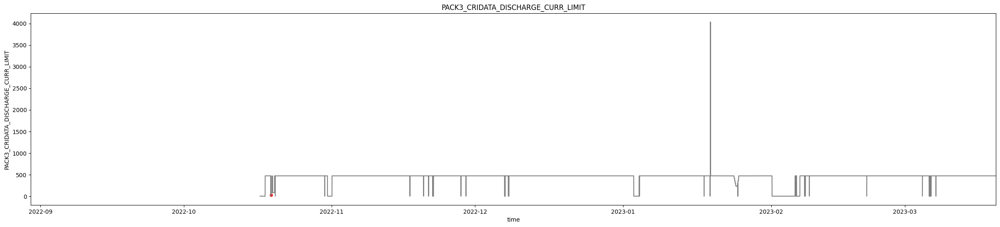

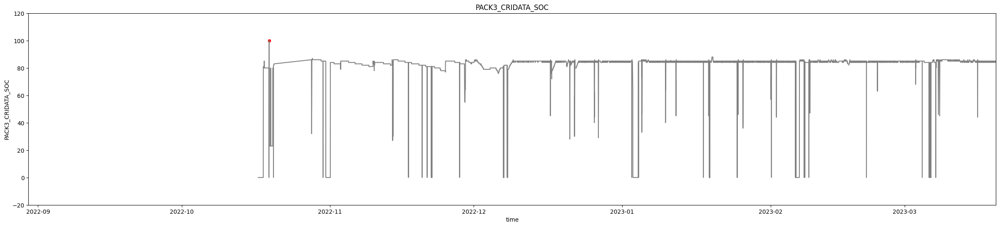

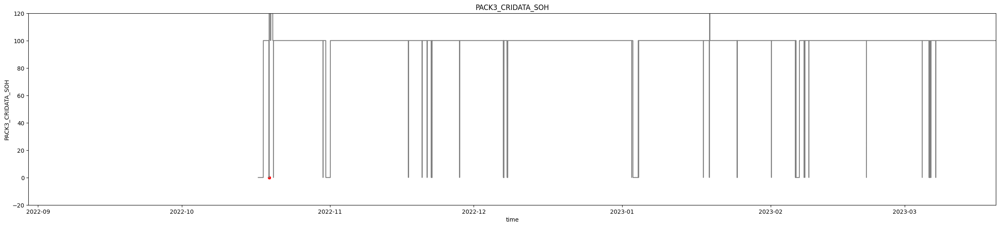

In [42]:
# @title
pack3_list = [
 'PACK3_CRIDATA_AVG_CELL_TEMP',
 'PACK3_CRIDATA_AVG_CELL_VOL',
 'PACK3_CRIDATA_BATT_VOL',
 'PACK3_CRIDATA_BUS_VOL',
 'PACK3_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_CURR',
 'PACK3_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_SOC',
 'PACK3_CRIDATA_SOH']

for i in range(len(pack3_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack3_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_3_FAULT'].fillna(False)], x='time', y=pack3_list[i], color='red', marker='o')
  if pack3_list[i] == 'PACK3_CRIDATA_CURR':
    plt.ylim(-200, 200)
  elif pack3_list[i] == 'PACK3_CRIDATA_SOC' or pack3_list[i] == 'PACK3_CRIDATA_SOH':
    plt.ylim(-20, 120)
  # elif pack3_list[i] == 'PACK3_CRIDATA_AVG_CELL_TEMP':
  #   plt.ylim(-10, 100)
  else:
    pass
  plt.xlim(data['time'][0], data['time'][273960])
  #plt.xlim(data['time'][90400], data['time'][130000])
  plt.title(pack3_list[i])
  plt.show()

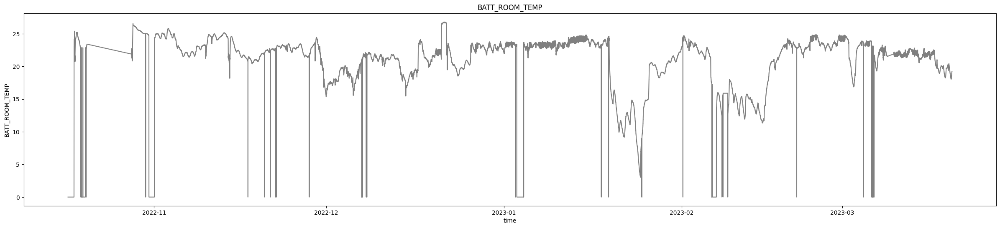

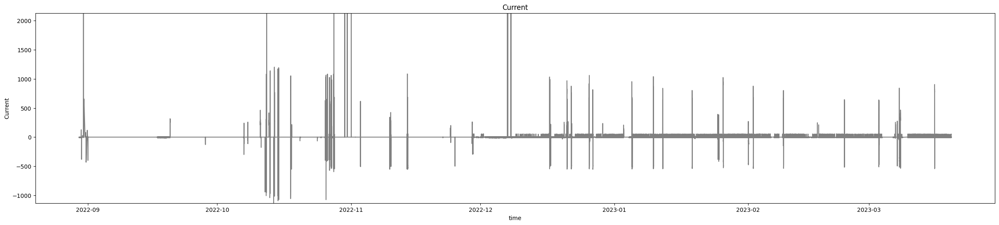

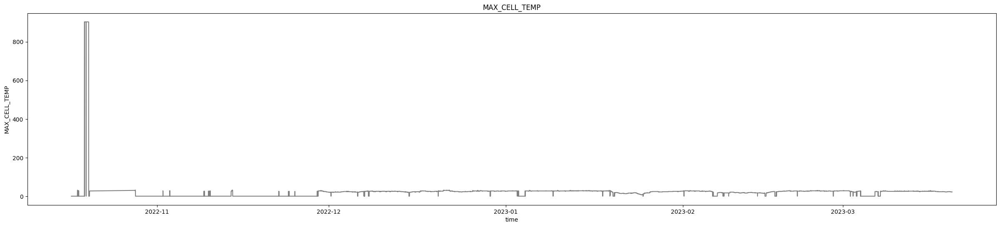

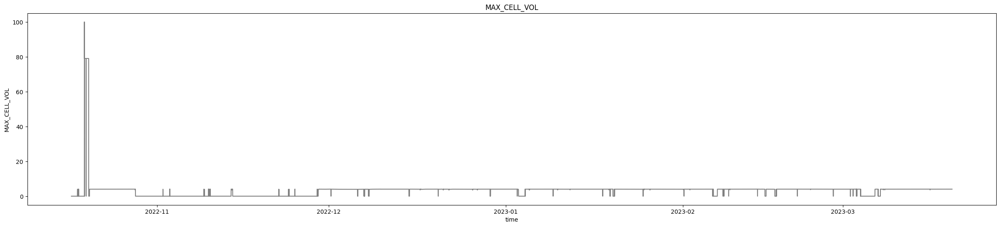

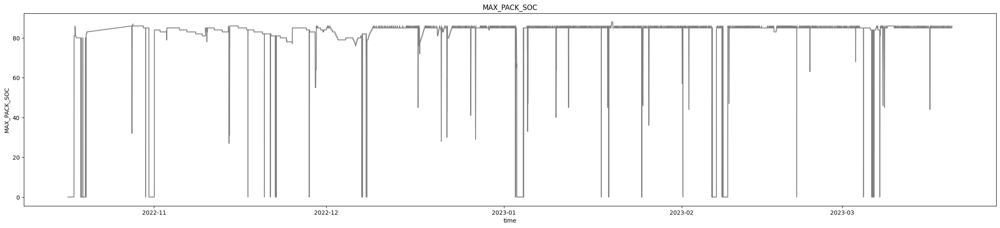

...

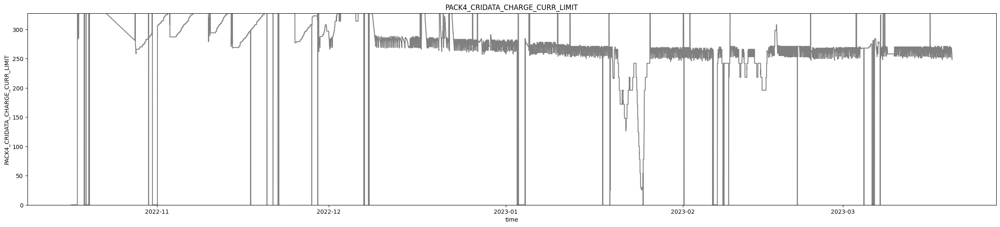

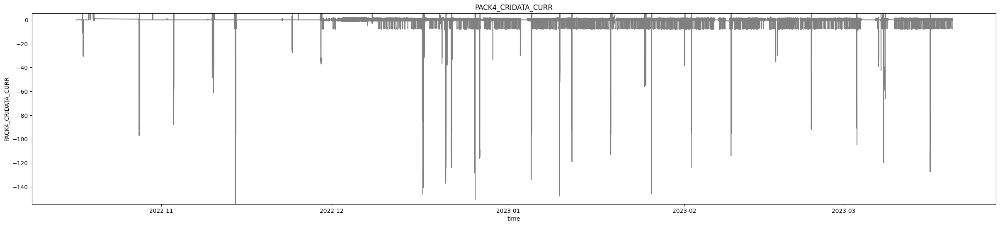

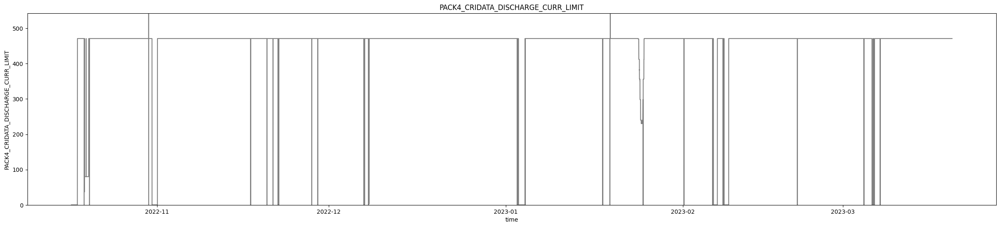

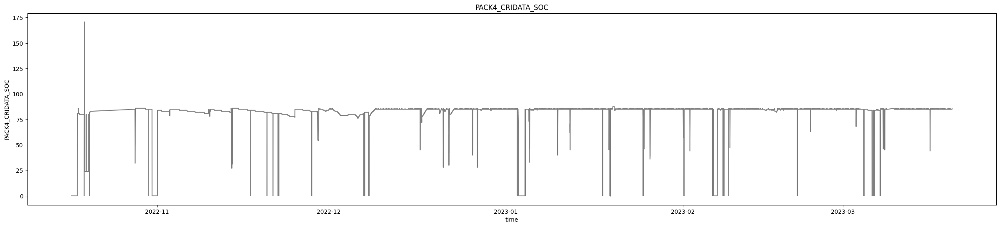

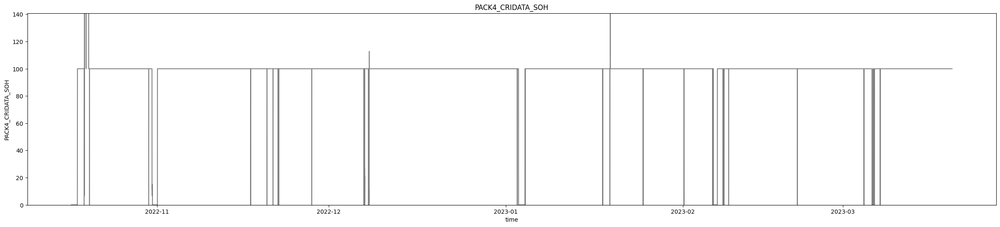

In [36]:
# @title
pack4_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK4_CRIDATA_AVG_CELL_TEMP',
 'PACK4_CRIDATA_AVG_CELL_VOL',
 'PACK4_CRIDATA_BATT_VOL',
 'PACK4_CRIDATA_BUS_VOL',
 'PACK4_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_CURR',
 'PACK4_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_SOC',
 'PACK4_CRIDATA_SOH']

for i in range(len(pack4_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack4_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_4_FAULT'].fillna(False)], x='time', y=pack4_list[i], color='red', marker='o')
  y_range = data[pack4_list[i]].max() - data[pack4_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack4_list[i]].min(), 1.2 * data[pack4_list[i]].mean())
  else:
    pass
  plt.title(pack4_list[i])
  plt.show()

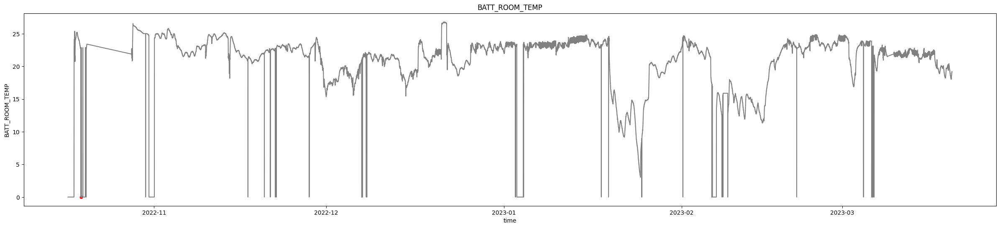

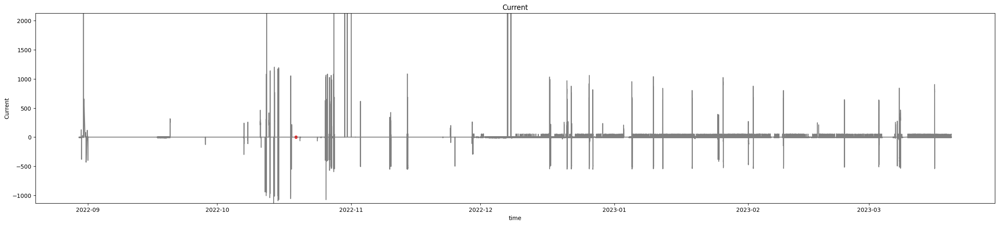

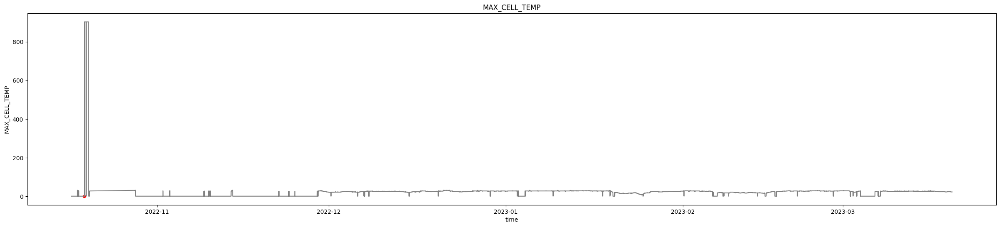

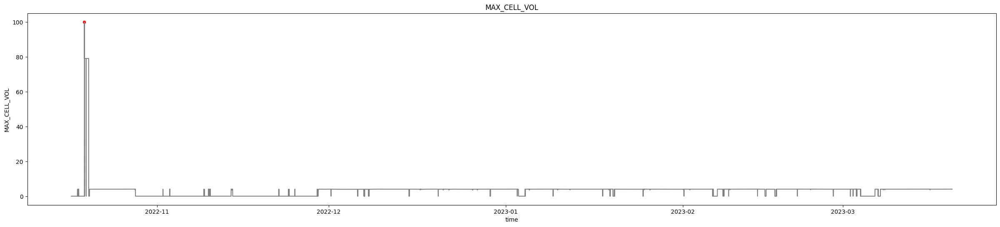

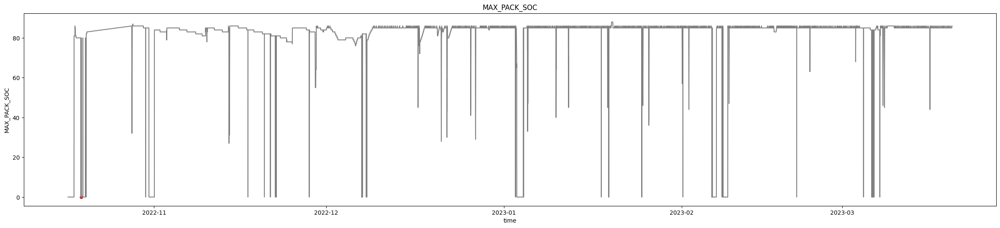

...

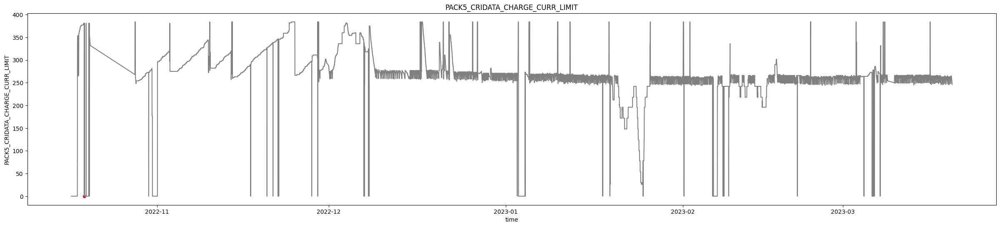

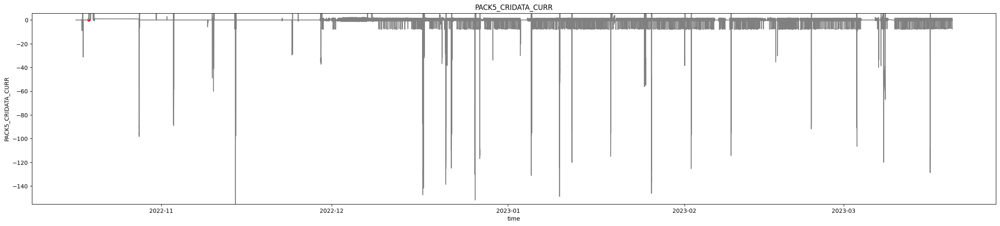

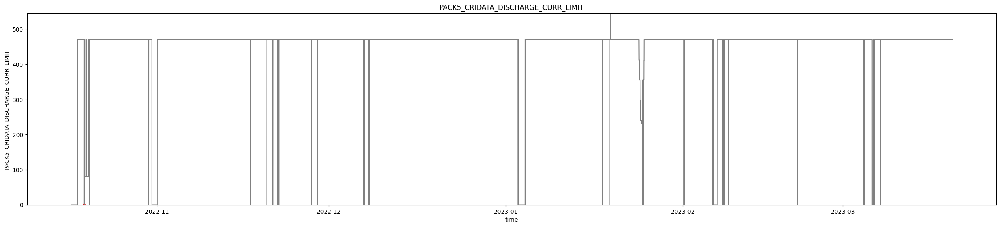

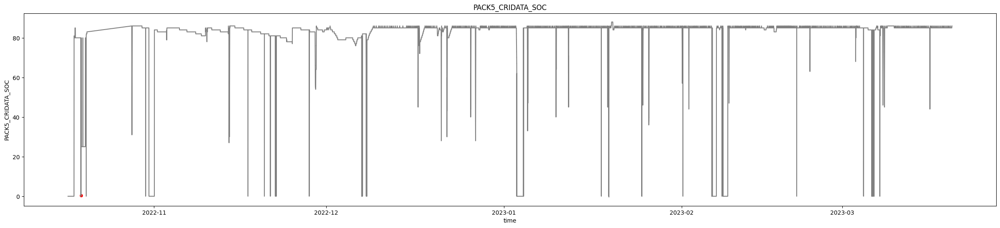

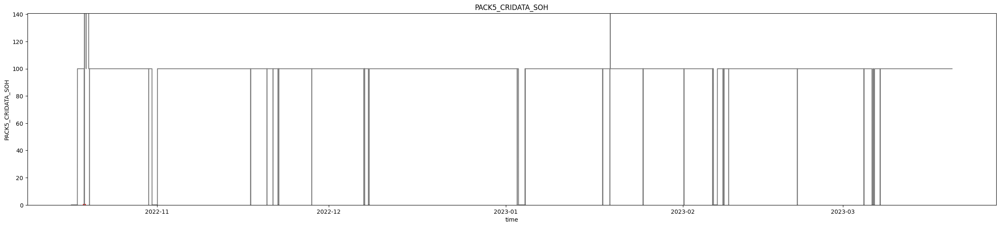

In [37]:
# @title
pack5_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK5_CRIDATA_AVG_CELL_TEMP',
 'PACK5_CRIDATA_AVG_CELL_VOL',
 'PACK5_CRIDATA_BATT_VOL',
 'PACK5_CRIDATA_BUS_VOL',
 'PACK5_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_CURR',
 'PACK5_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_SOC',
 'PACK5_CRIDATA_SOH']

for i in range(len(pack5_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack5_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_5_FAULT'].fillna(False)], x='time', y=pack5_list[i], color='red', marker='o')
  y_range = data[pack5_list[i]].max() - data[pack5_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack5_list[i]].min(), 1.2 * data[pack5_list[i]].mean())
  else:
    pass
  plt.title(pack5_list[i])
  plt.show()

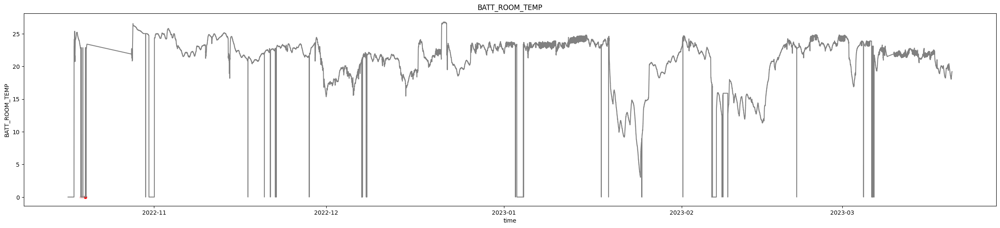

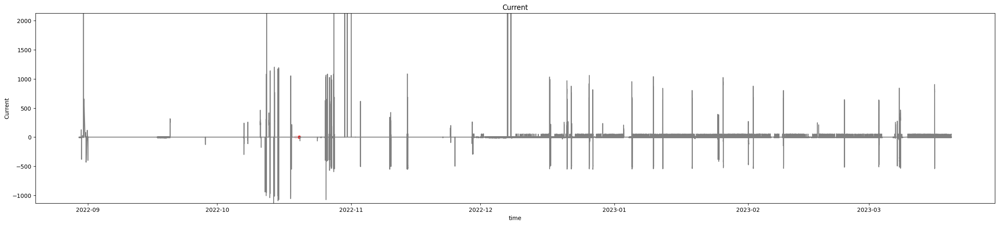

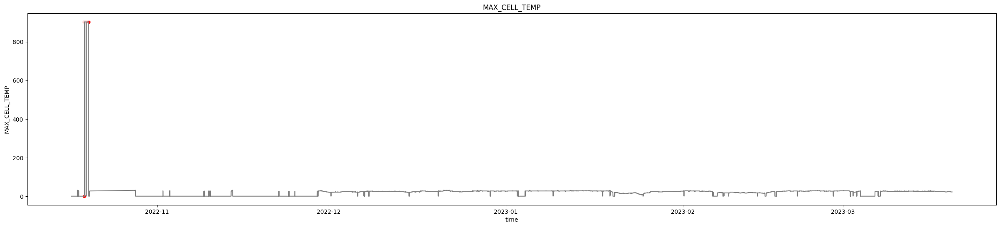

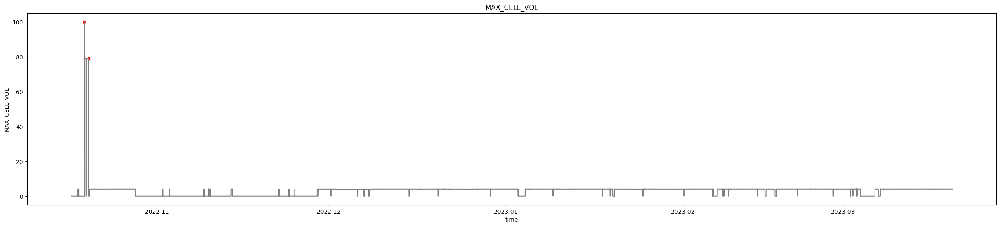

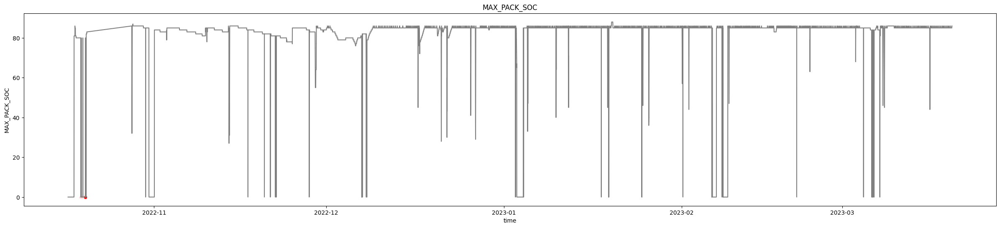

...

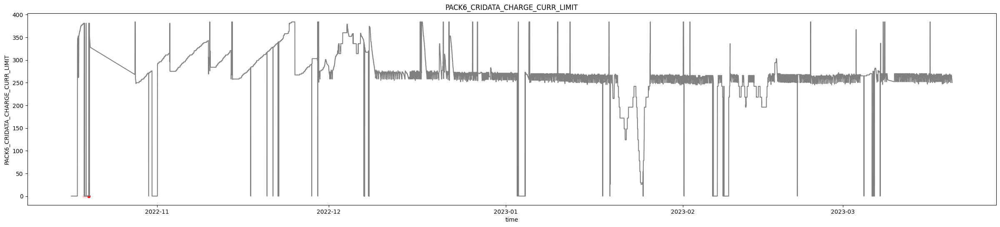

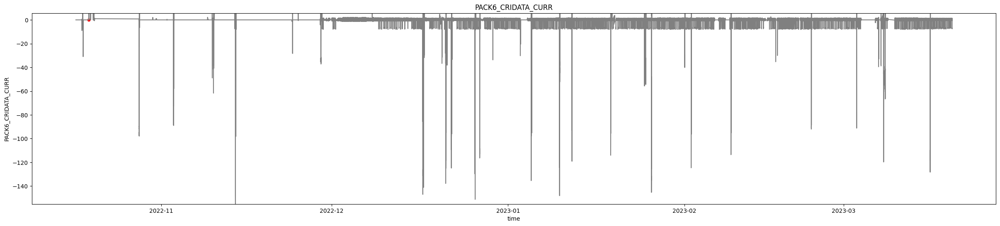

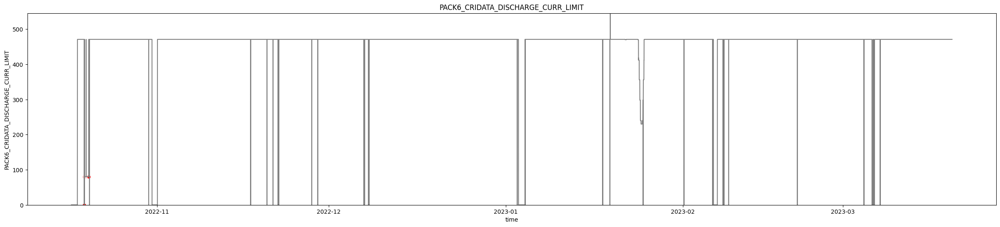

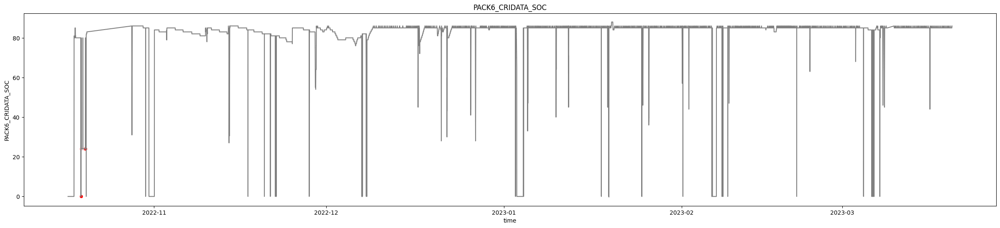

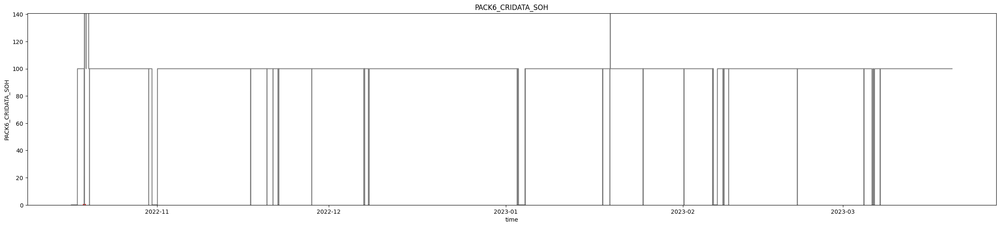

In [38]:
# @title
pack6_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK6_CRIDATA_AVG_CELL_TEMP',
 'PACK6_CRIDATA_AVG_CELL_VOL',
 'PACK6_CRIDATA_BATT_VOL',
 'PACK6_CRIDATA_BUS_VOL',
 'PACK6_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_CURR',
 'PACK6_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_SOC',
 'PACK6_CRIDATA_SOH']

for i in range(len(pack6_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack6_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_6_FAULT'].fillna(False)], x='time', y=pack6_list[i], color='red', marker='o')
  y_range = data[pack6_list[i]].max() - data[pack6_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack6_list[i]].min(), 1.2 * data[pack6_list[i]].mean())
  else:
    pass
  plt.title(pack6_list[i])
  plt.show()

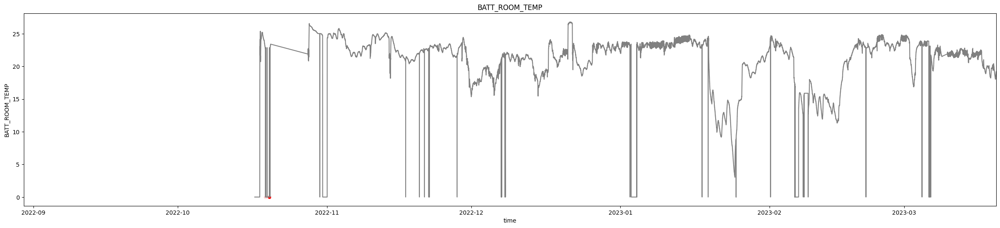

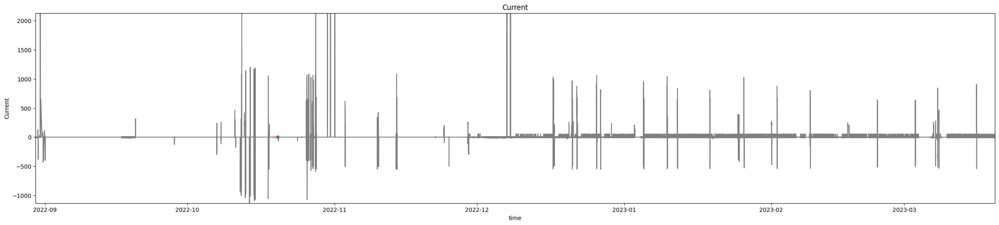

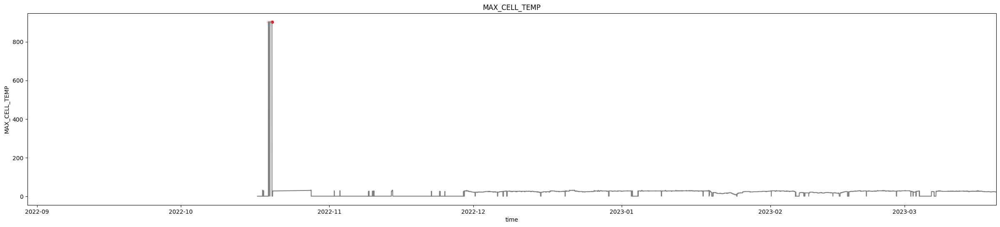

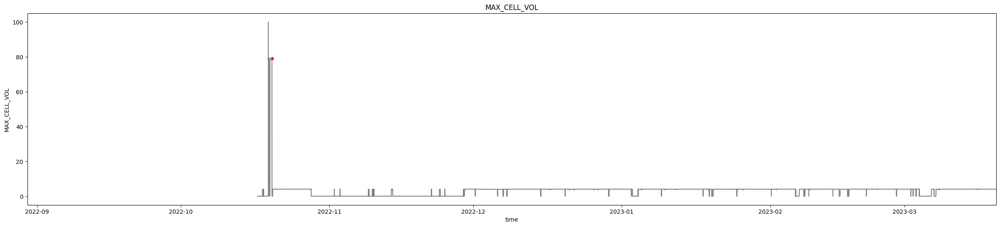

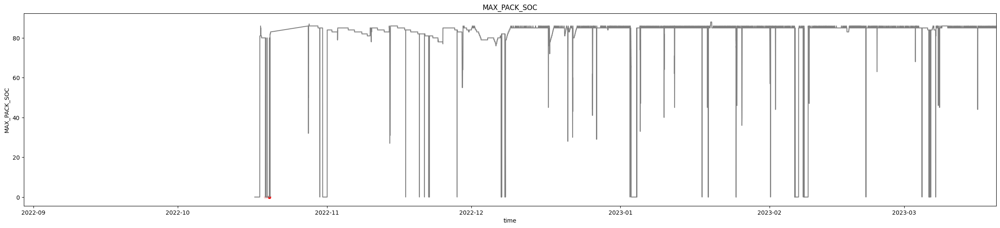

...

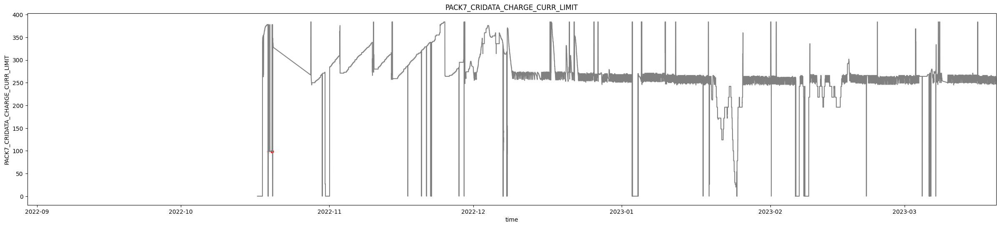

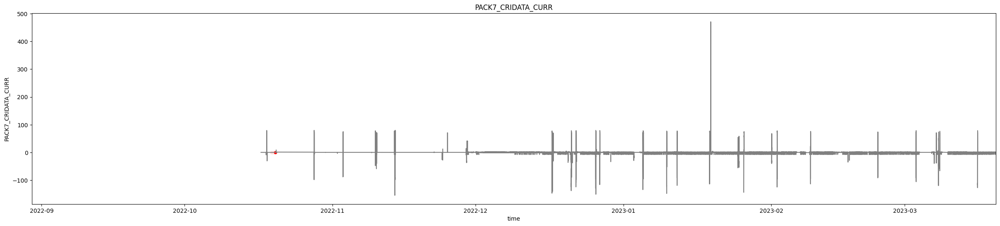

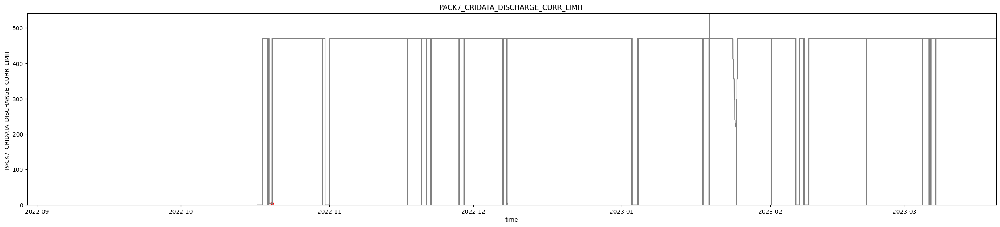

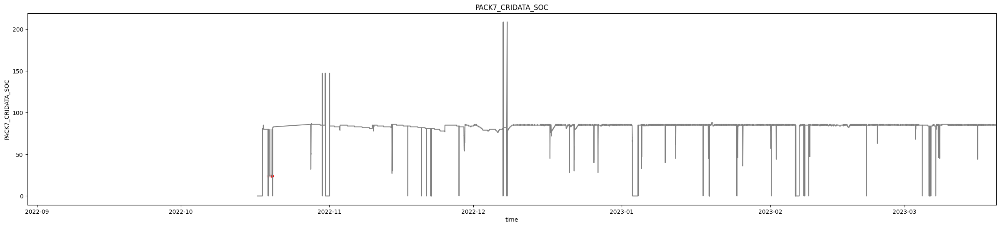

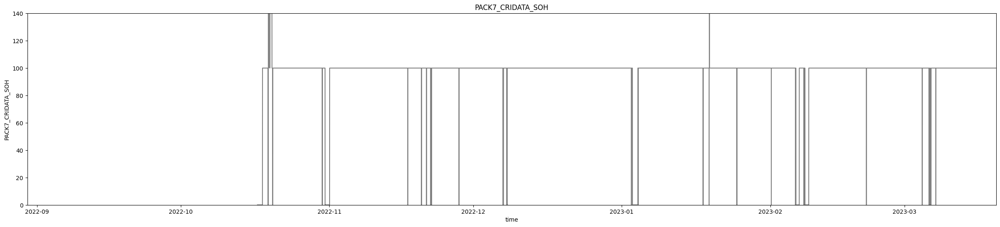

In [58]:
# @title
pack7_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK7_CRIDATA_AVG_CELL_TEMP',
 'PACK7_CRIDATA_AVG_CELL_VOL',
 'PACK7_CRIDATA_BATT_VOL',
 'PACK7_CRIDATA_BUS_VOL',
 'PACK7_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_CURR',
 'PACK7_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_SOC',
 'PACK7_CRIDATA_SOH']

for i in range(len(pack7_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack7_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_7_FAULT'].fillna(False)], x='time', y=pack7_list[i], color='red', marker='o')
  y_range = data[pack7_list[i]].max() - data[pack7_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack7_list[i]].min(), 1.2 * data[pack7_list[i]].mean())
  else:
    pass
  plt.xlim(data['time'][0], data['time'][273960])
  plt.title(pack7_list[i])
  plt.show()

In [57]:
for i in range(7):
  print(str(i+1))
  print(data['BATT_PACK_'+str(i+1)+'_FAULT'].value_counts())
  print(data['BATT_PACK_'+str(i+1)+'_FAULT'].isna().sum())

1
False    137042
True         99
Name: BATT_PACK_1_FAULT, dtype: int64
136820
2
False    194606
True        481
Name: BATT_PACK_2_FAULT, dtype: int64
78874
3
False    201997
True          1
Name: BATT_PACK_3_FAULT, dtype: int64
71963
4
False    202027
Name: BATT_PACK_4_FAULT, dtype: int64
71934
5
False    193913
True          1
Name: BATT_PACK_5_FAULT, dtype: int64
80047
6
False    200915
True       1085
Name: BATT_PACK_6_FAULT, dtype: int64
71961
7
False    201174
True       1084
Name: BATT_PACK_7_FAULT, dtype: int64
71703


In [14]:
for i in range(7):
  print(str(i+1))
  print(data['BATT_PACK_'+str(i+1)+'_DISCONN'].value_counts())
  print(data['BATT_PACK_'+str(i+1)+'_DISCONN'].isna().sum())

1
False    150260
True      51769
Name: BATT_PACK_1_DISCONN, dtype: int64
71932
2
False    143411
True      51677
Name: BATT_PACK_2_DISCONN, dtype: int64
78873
3
False    151438
True      50591
Name: BATT_PACK_3_DISCONN, dtype: int64
71932
4
False    150455
True      50633
Name: BATT_PACK_4_DISCONN, dtype: int64
72873
5
False    150267
True      50590
Name: BATT_PACK_5_DISCONN, dtype: int64
73104
6
False    151462
True      50799
Name: BATT_PACK_6_DISCONN, dtype: int64
71700
7
False    150343
True      51685
Name: BATT_PACK_7_DISCONN, dtype: int64
71933


In [15]:
for i in range(7):
  print(str(i+1))
  print(data['BATT_PACK_'+str(i+1)+'_WARN'].value_counts())
  print(data['BATT_PACK_'+str(i+1)+'_WARN'].isna().sum())

1
False    142762
True        148
Name: BATT_PACK_1_WARN, dtype: int64
131051
2
False    195061
Name: BATT_PACK_2_WARN, dtype: int64
78900
3
False    202000
True          1
Name: BATT_PACK_3_WARN, dtype: int64
71960
4
False    195086
True          1
Name: BATT_PACK_4_WARN, dtype: int64
78874
5
False    200941
True       1085
Name: BATT_PACK_5_WARN, dtype: int64
71935
6
False    192804
True       1085
Name: BATT_PACK_6_WARN, dtype: int64
80072
7
False    201173
True       1085
Name: BATT_PACK_7_WARN, dtype: int64
71703


# DISCONN

In [48]:
from functools import reduce

a = data['BATT_PACK_1_DISCONN'].fillna(False)
b = data['BATT_PACK_2_DISCONN'].fillna(False)
c = data['BATT_PACK_3_DISCONN'].fillna(False)
d = data['BATT_PACK_4_DISCONN'].fillna(False)
e = data['BATT_PACK_5_DISCONN'].fillna(False)
f = data['BATT_PACK_6_DISCONN'].fillna(False)
g = data['BATT_PACK_7_DISCONN'].fillna(False)

lists = [a, b, c, d, e, f, g]

result = reduce(lambda x, y: [x_i and y_i for x_i, y_i in zip(x, y)], lists)

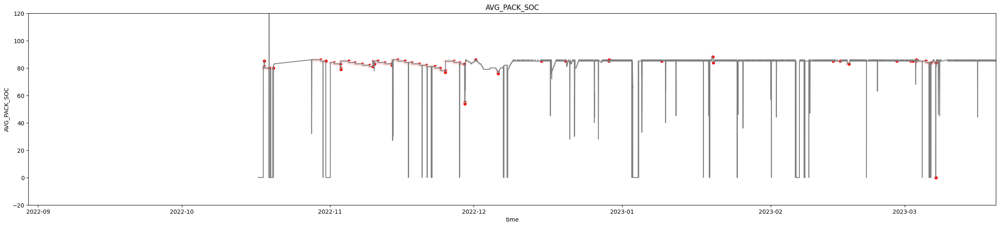

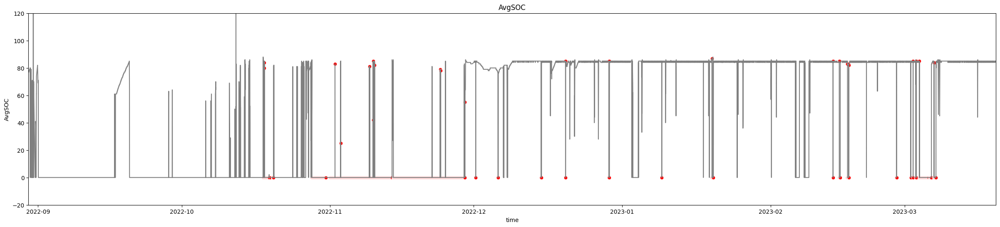

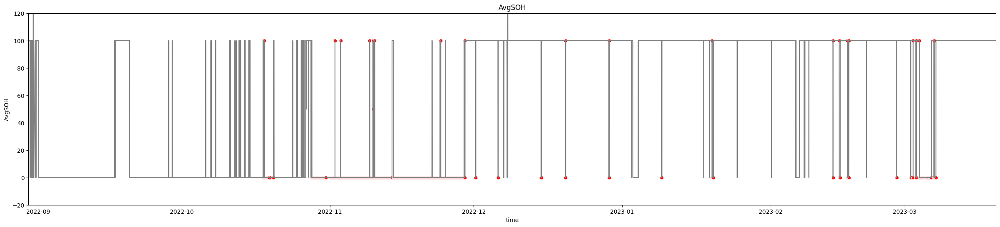

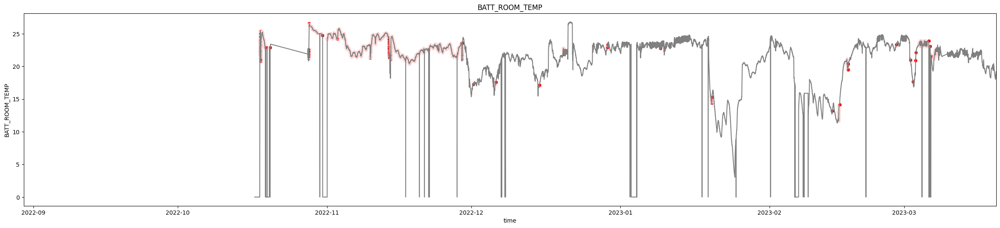

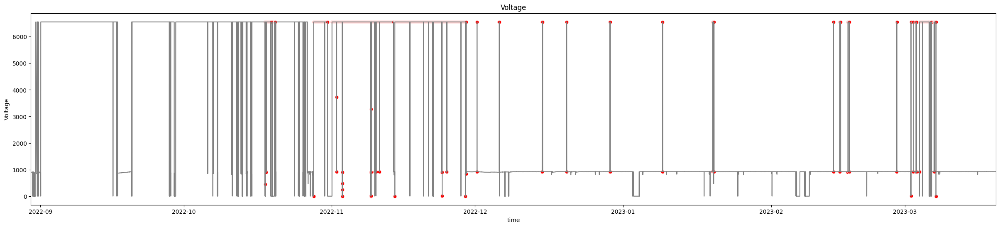

...

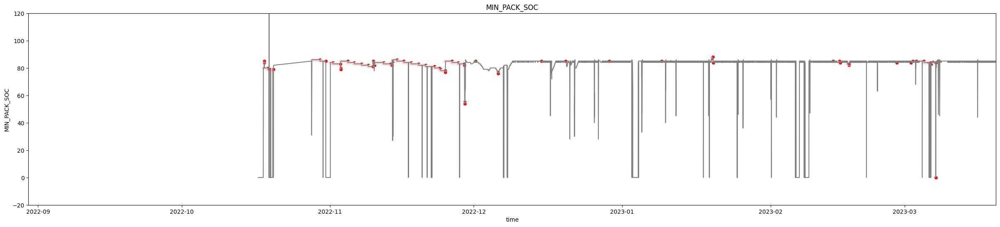

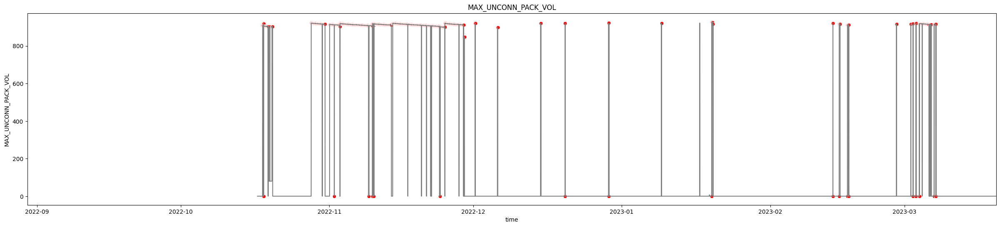

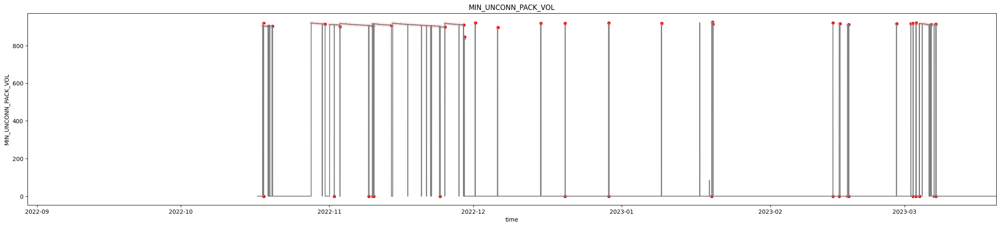

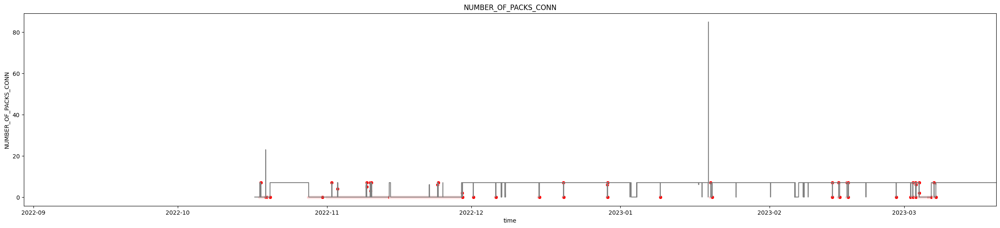

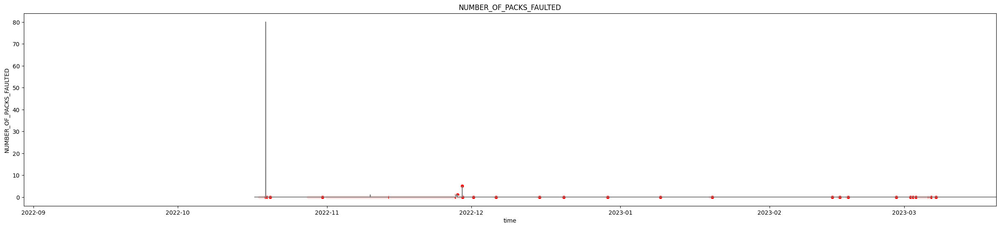

In [52]:
packs_list = ['AVG_PACK_SOC',
 'AvgSOC',
 'AvgSOH',
 'BATT_ROOM_TEMP',
 'Voltage',
 'Current',
 'MAX_CELL_TEMP', 'MIN_CELL_TEMP',
 'MAX_CELL_VOL', 'MIN_CELL_VOL',
 'MAX_PACK_SOC', 'MIN_PACK_SOC',
 'MAX_UNCONN_PACK_VOL', 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED']

for i in range(len(packs_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=packs_list[i], color='grey')
  sns.scatterplot(data=data[result], x='time', y=packs_list[i], color='red', marker='o')
  y_range = data[packs_list[i]].max() - data[packs_list[i]].min()
  if packs_list[i] == 'Current':
    plt.ylim(-500, 500)
  elif packs_list[i] == 'AVG_PACK_SOC' or packs_list[i] == 'AvgSOC' or packs_list[i] == 'AvgSOH' or packs_list[i] == 'MAX_PACK_SOC' or packs_list[i] == 'MIN_PACK_SOC':
    plt.ylim(-20, 120)
  elif packs_list[i] == 'MAX_CELL_TEMP' or packs_list[i] == 'MIN_CELL_TEMP':
    plt.ylim(-10, 80)
  else:
    pass
  # plt.xlim(data['time'][90400], data['time'][130000])
  plt.xlim(data['time'][0], data['time'][273960])
  plt.title(packs_list[i])
  plt.show()

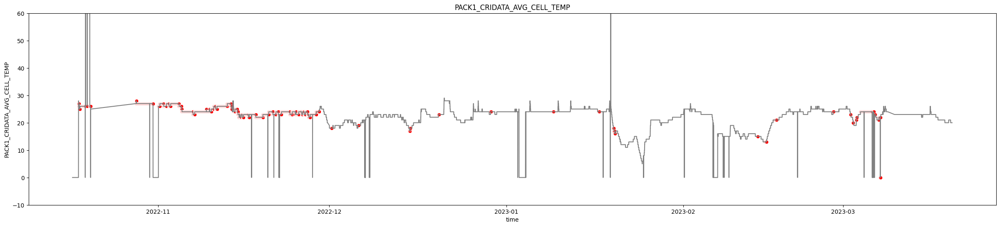

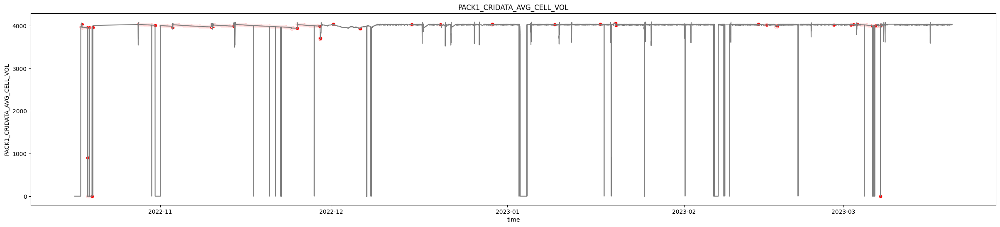

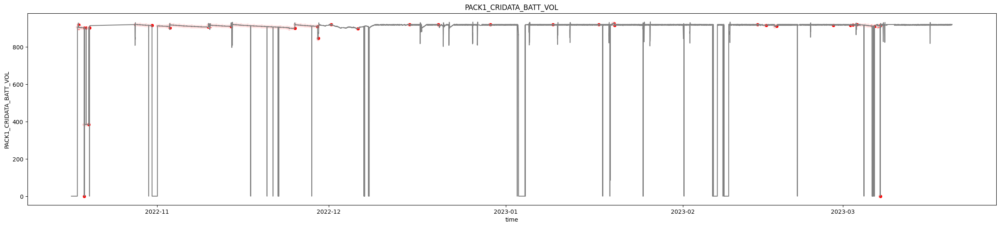

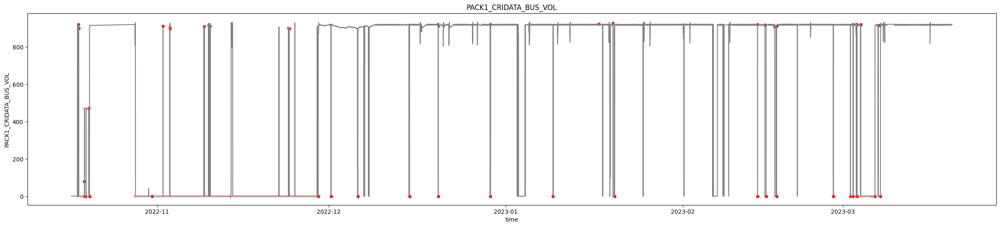

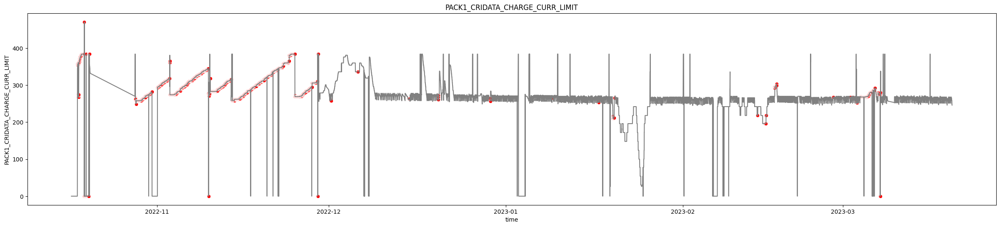

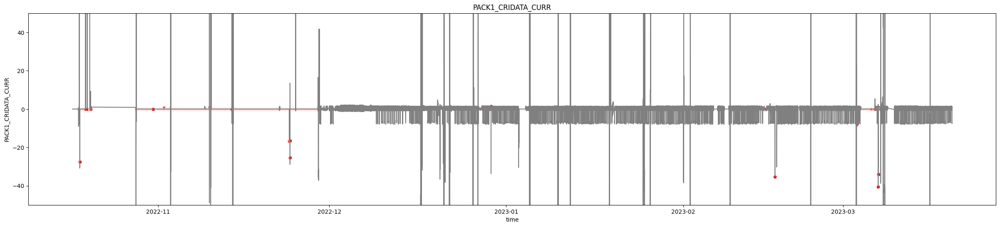

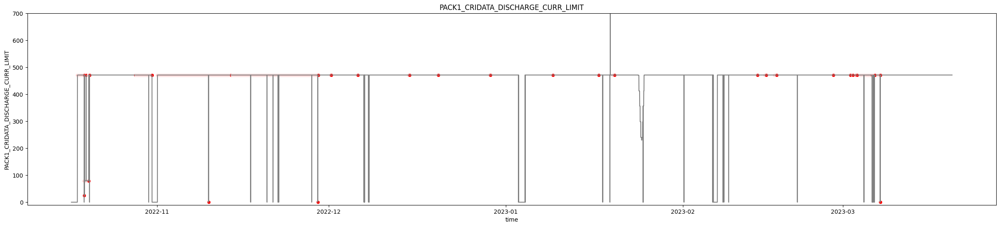

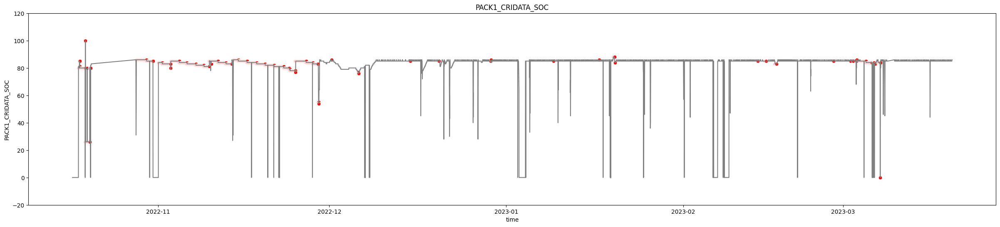

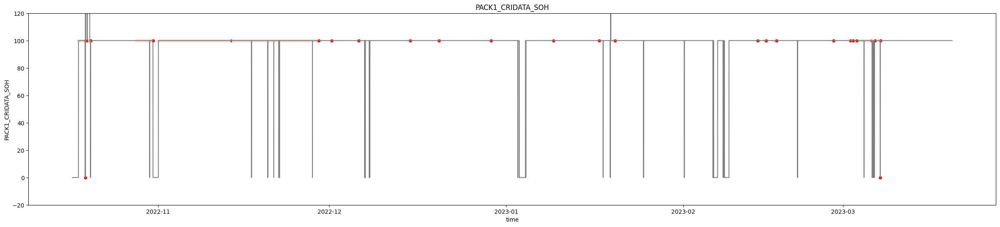

In [47]:
# pack1_list = ['BATT_ROOM_TEMP',
#  'Voltage',
#  'Current',
#  'MAX_CELL_TEMP',
#  'MAX_CELL_VOL',
#  'MAX_PACK_SOC',
#  'MAX_UNCONN_PACK_VOL',
#  'MIN_CELL_TEMP',
#  'MIN_CELL_VOL',
#  'MIN_PACK_SOC',
#  'MIN_UNCONN_PACK_VOL',
#  'NUMBER_OF_PACKS_CONN',
#  'NUMBER_OF_PACKS_FAULTED',
pack1_list = [
 'PACK1_CRIDATA_AVG_CELL_TEMP',
 'PACK1_CRIDATA_AVG_CELL_VOL',
 'PACK1_CRIDATA_BATT_VOL',
 'PACK1_CRIDATA_BUS_VOL',
 'PACK1_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_CURR',
 'PACK1_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_SOC',
 'PACK1_CRIDATA_SOH']

for i in range(len(pack1_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack1_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_1_DISCONN'].fillna(False)], x='time', y=pack1_list[i], color='red', marker='o')
  if pack1_list[i] == 'PACK1_CRIDATA_CURR':
    plt.ylim(-50, 50)
  elif pack1_list[i] == 'PACK1_CRIDATA_SOC' or pack1_list[i] == 'PACK1_CRIDATA_SOH':
    plt.ylim(-20, 120)
  elif pack1_list[i] == 'PACK1_CRIDATA_AVG_CELL_TEMP':
    plt.ylim(-10, 60)
  elif pack1_list[i] == 'PACK1_CRIDATA_DISCHARGE_CURR_LIMIT':
    plt.ylim(-10, 700)
  elif pack1_list[i] == 'PACK1_CRIDATA_BATT_VOL' or pack1_list[i] == 'PACK1_CRIDATA_BUS_VOL':
    plt.ylim(-10, 700)
  else:
    pass
  #plt.xlim(data['time'][0], data['time'][273960])
  #plt.xlim(data['time'][90400], data['time'][130000])
  plt.title(pack1_list[i])
  plt.show()

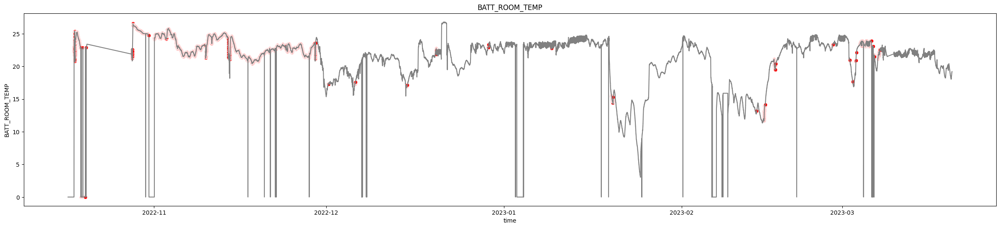

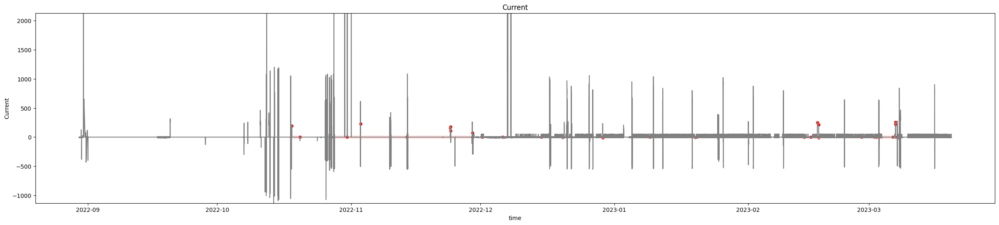

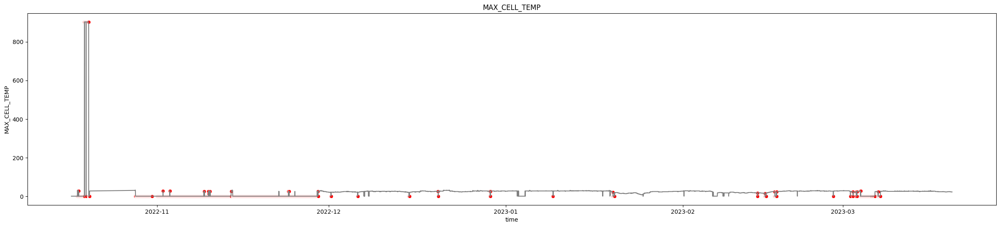

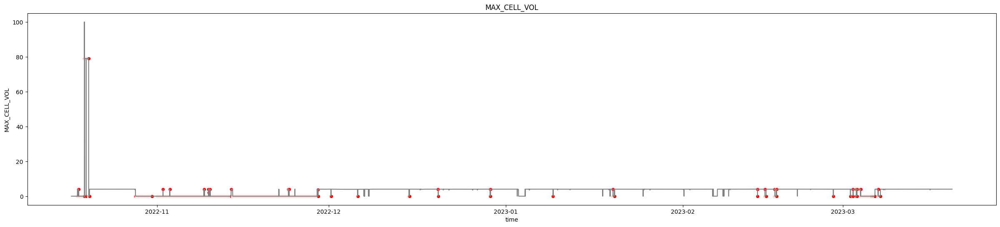

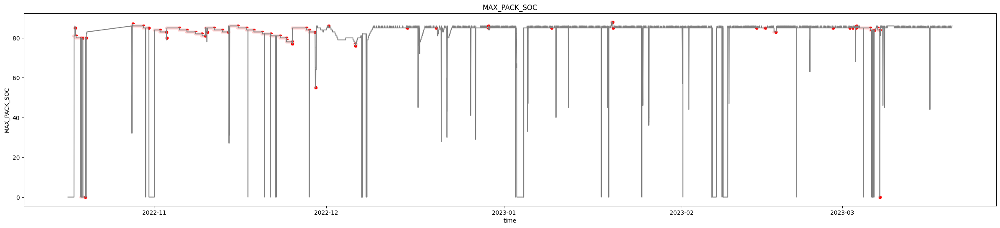

...

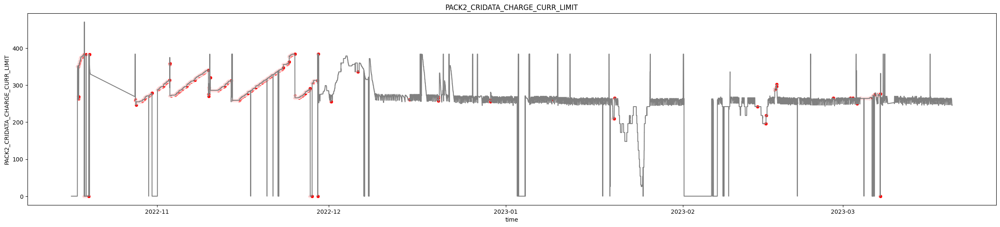

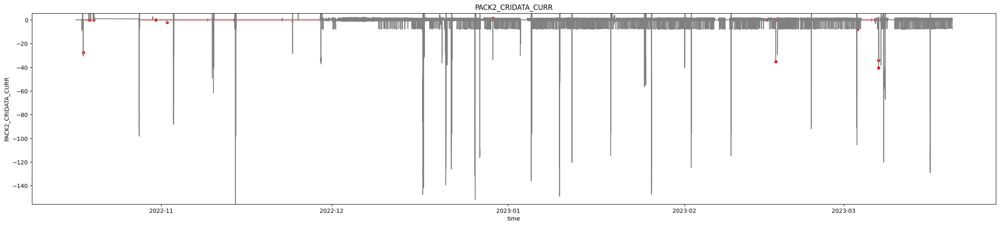

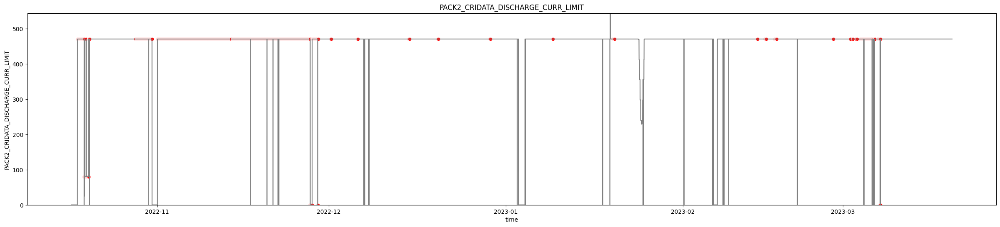

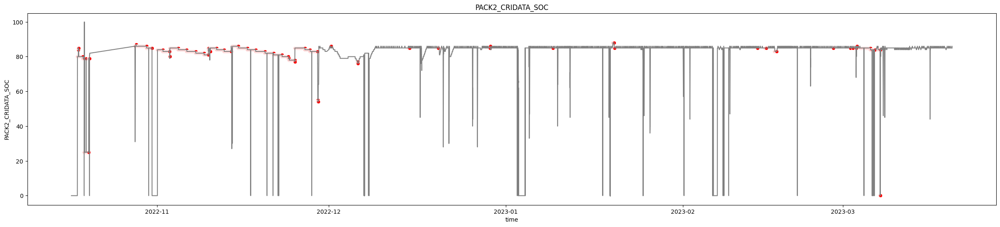

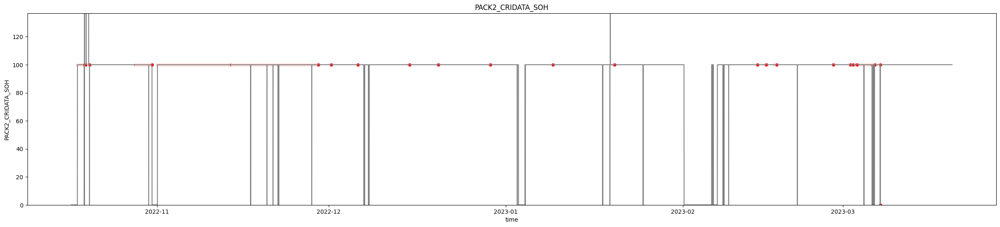

In [46]:
pack2_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK2_CRIDATA_AVG_CELL_TEMP',
 'PACK2_CRIDATA_AVG_CELL_VOL',
 'PACK2_CRIDATA_BATT_VOL',
 'PACK2_CRIDATA_BUS_VOL',
 'PACK2_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_CURR',
 'PACK2_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_SOC',
 'PACK2_CRIDATA_SOH']

for i in range(len(pack2_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack2_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_2_DISCONN'].fillna(False)], x='time', y=pack2_list[i], color='red', marker='o')
  y_range = data[pack2_list[i]].max() - data[pack2_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack2_list[i]].min(), 1.2 * data[pack2_list[i]].mean())
  else:
    pass
  plt.title(pack2_list[i])
  plt.show()

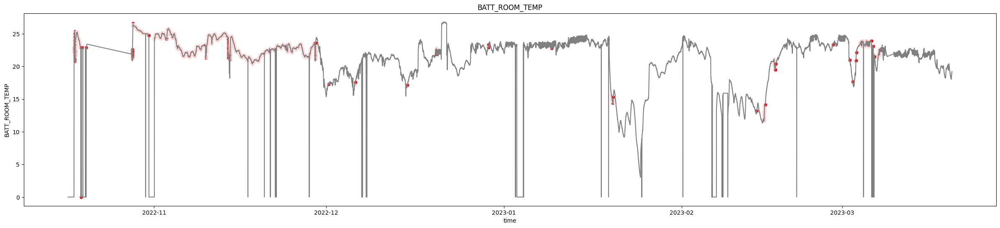

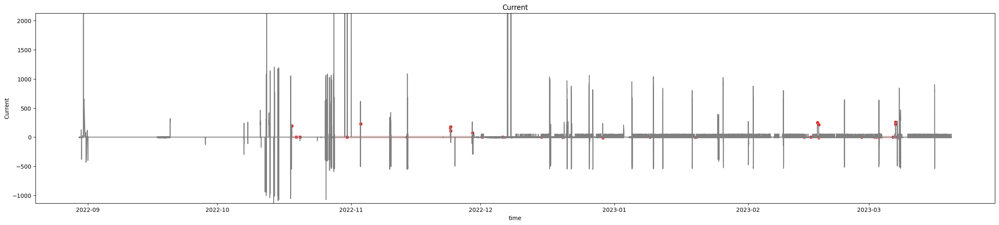

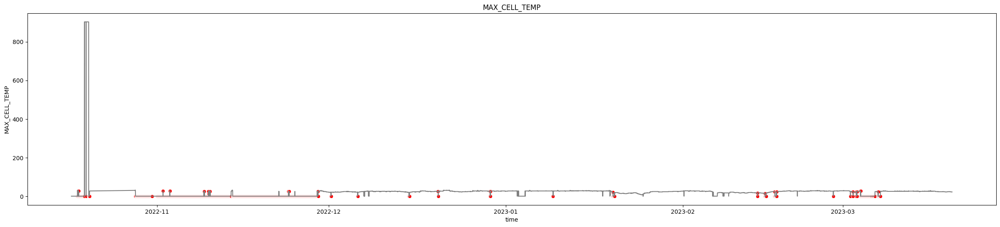

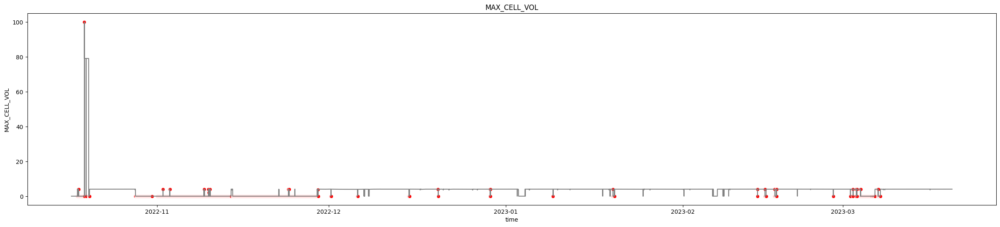

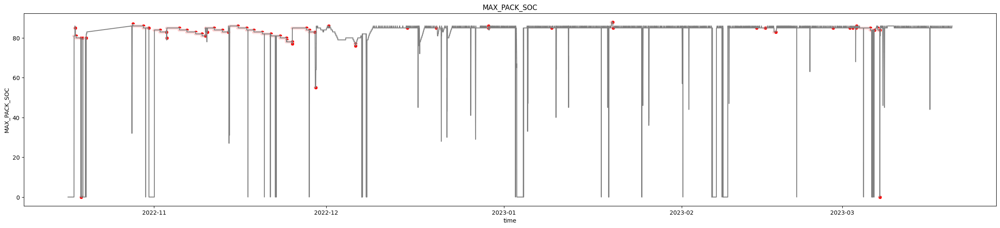

...

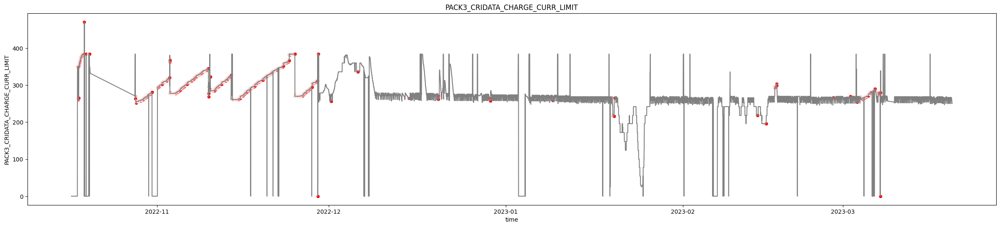

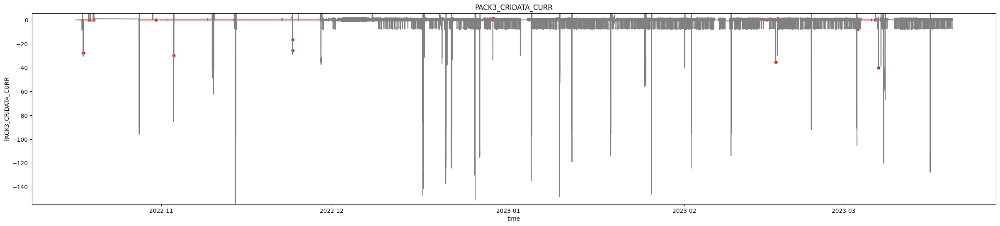

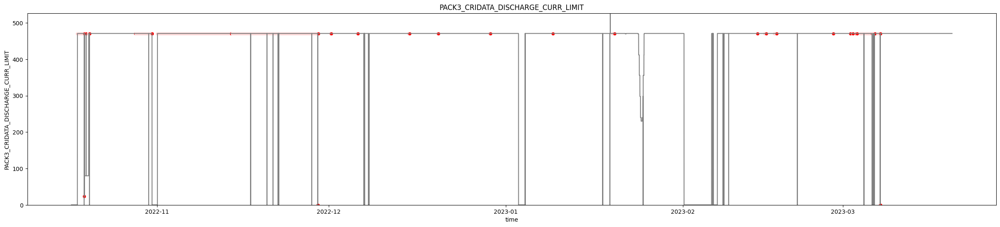

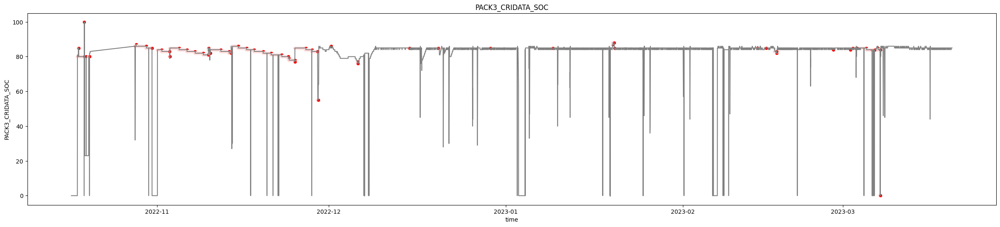

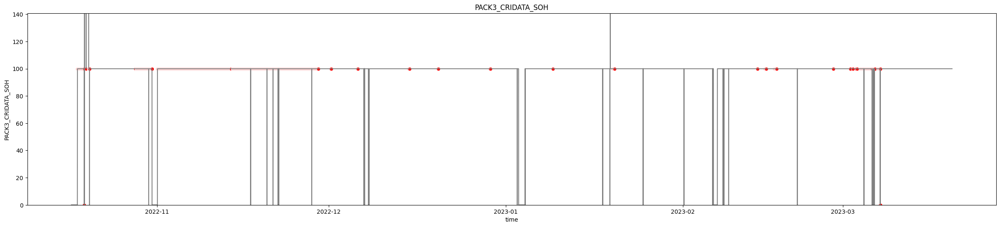

In [47]:
pack3_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK3_CRIDATA_AVG_CELL_TEMP',
 'PACK3_CRIDATA_AVG_CELL_VOL',
 'PACK3_CRIDATA_BATT_VOL',
 'PACK3_CRIDATA_BUS_VOL',
 'PACK3_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_CURR',
 'PACK3_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_SOC',
 'PACK3_CRIDATA_SOH']

for i in range(len(pack3_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack3_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_3_DISCONN'].fillna(False)], x='time', y=pack3_list[i], color='red', marker='o')
  y_range = data[pack3_list[i]].max() - data[pack3_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack3_list[i]].min(), 1.2 * data[pack3_list[i]].mean())
  else:
    pass
  plt.title(pack3_list[i])
  plt.show()

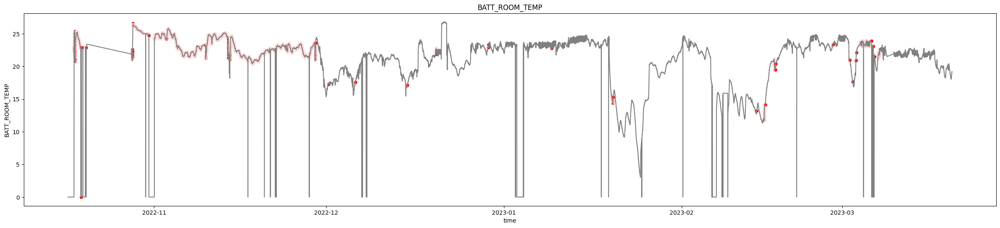

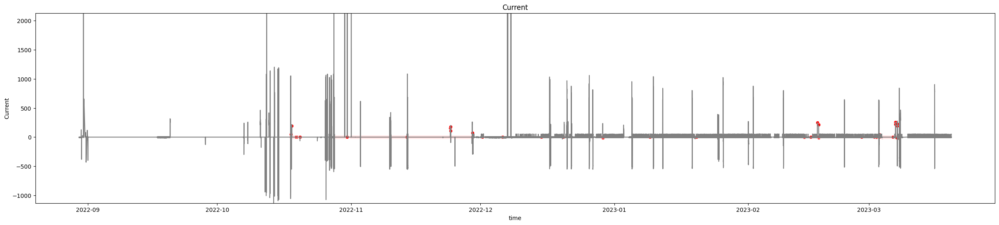

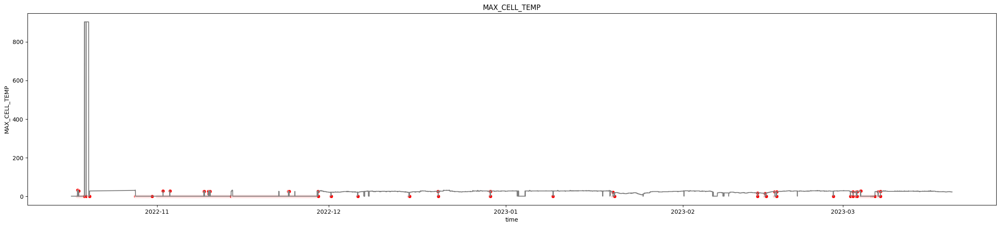

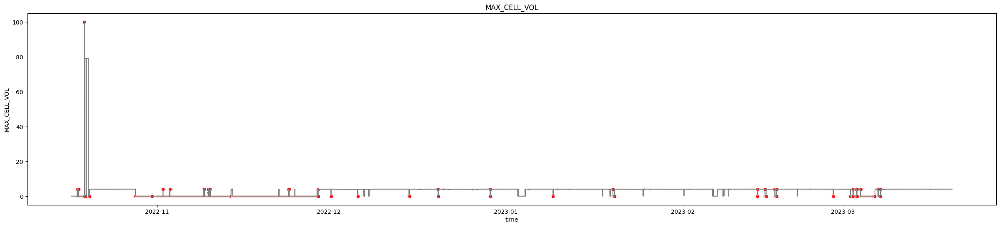

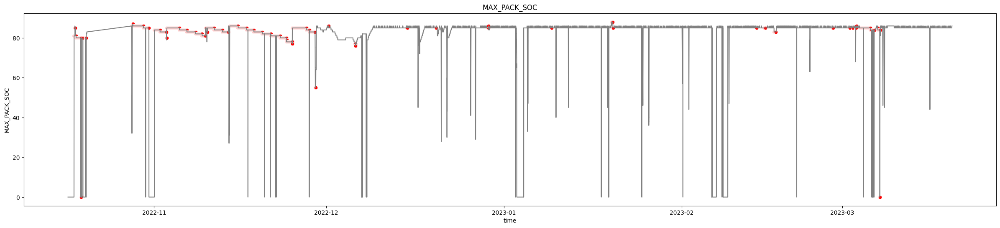

...

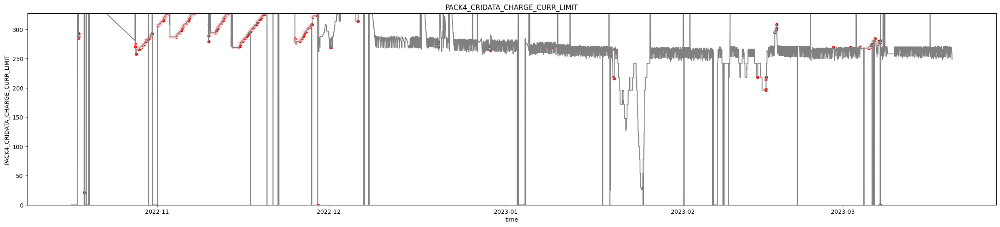

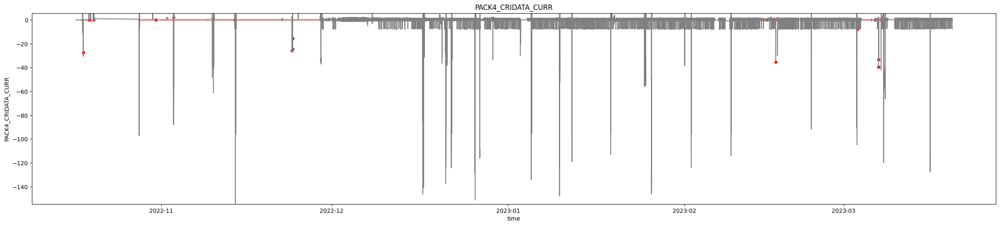

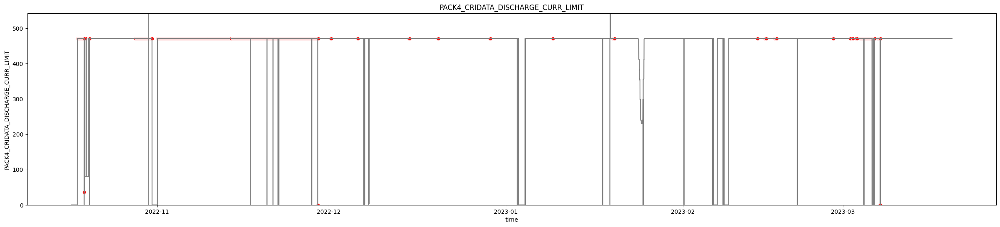

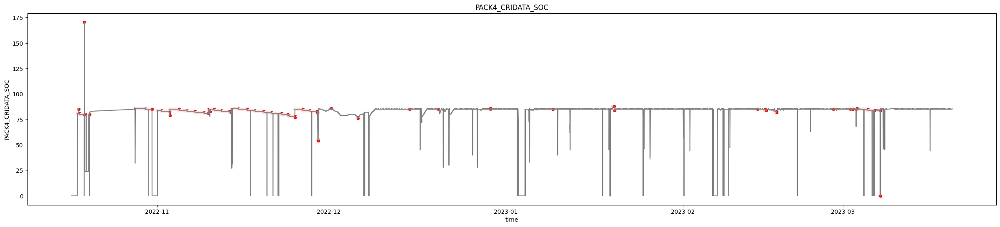

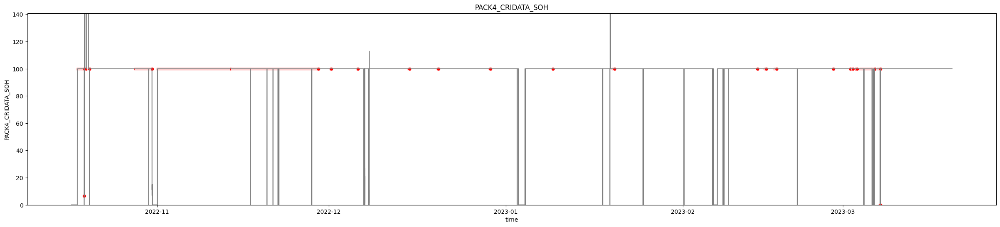

In [48]:
pack4_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK4_CRIDATA_AVG_CELL_TEMP',
 'PACK4_CRIDATA_AVG_CELL_VOL',
 'PACK4_CRIDATA_BATT_VOL',
 'PACK4_CRIDATA_BUS_VOL',
 'PACK4_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_CURR',
 'PACK4_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_SOC',
 'PACK4_CRIDATA_SOH']

for i in range(len(pack4_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack4_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_4_DISCONN'].fillna(False)], x='time', y=pack4_list[i], color='red', marker='o')
  y_range = data[pack4_list[i]].max() - data[pack4_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack4_list[i]].min(), 1.2 * data[pack4_list[i]].mean())
  else:
    pass
  plt.title(pack4_list[i])
  plt.show()

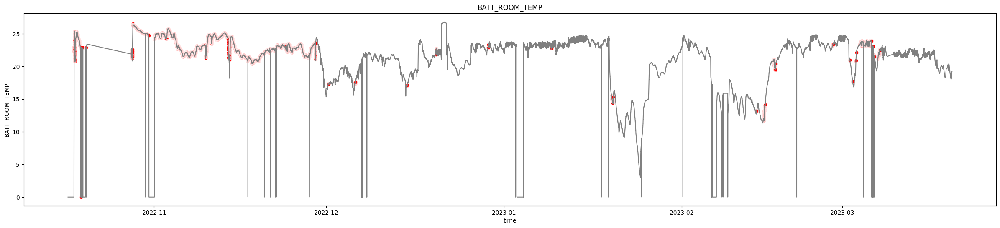

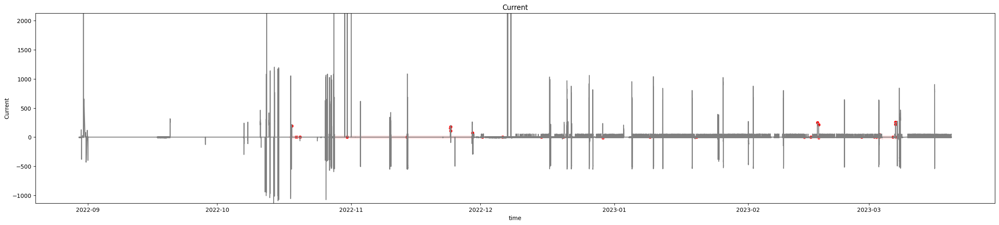

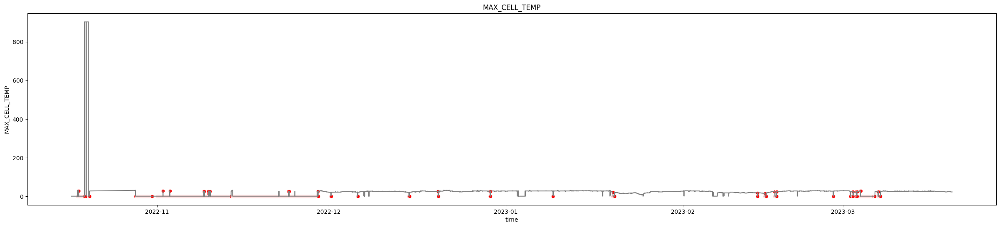

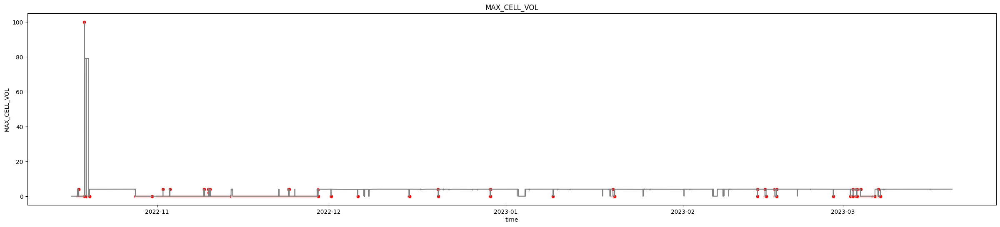

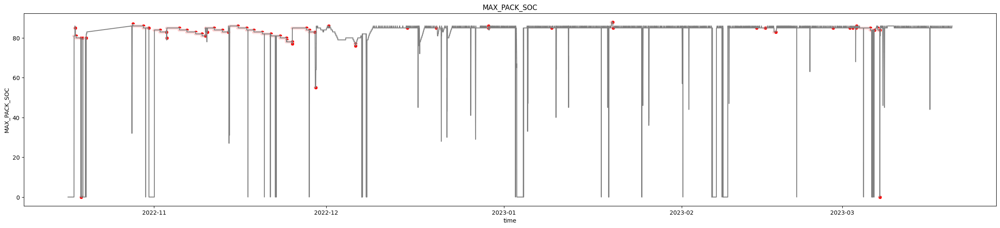

...

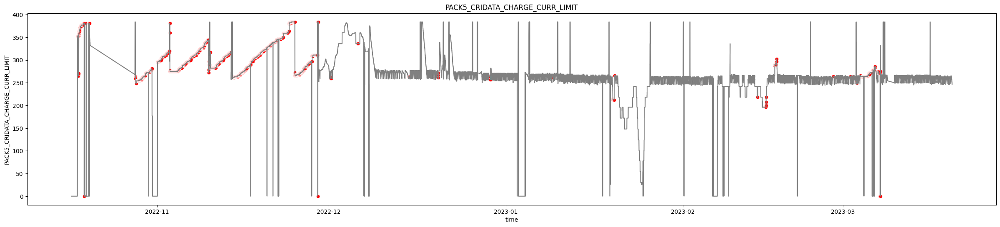

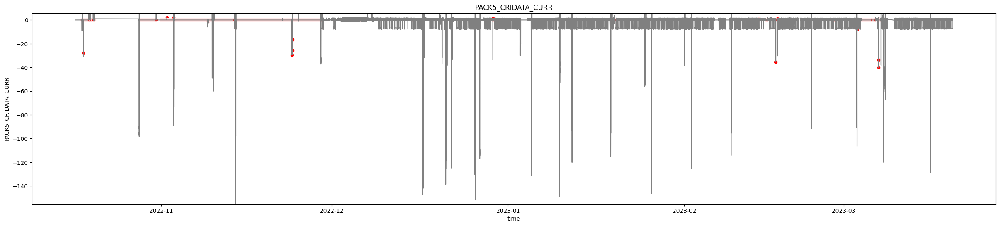

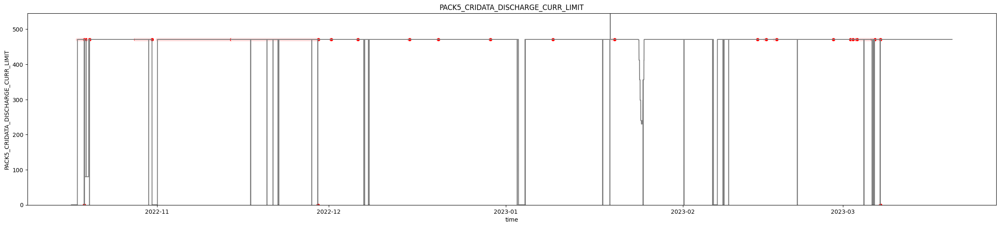

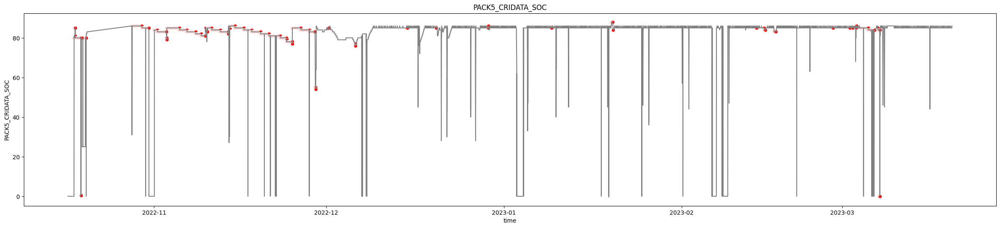

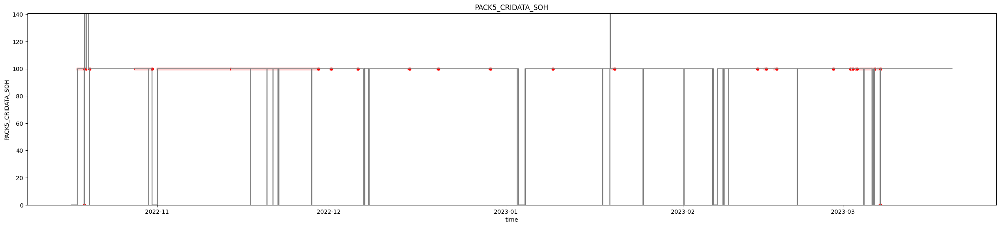

In [49]:
pack5_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK5_CRIDATA_AVG_CELL_TEMP',
 'PACK5_CRIDATA_AVG_CELL_VOL',
 'PACK5_CRIDATA_BATT_VOL',
 'PACK5_CRIDATA_BUS_VOL',
 'PACK5_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_CURR',
 'PACK5_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_SOC',
 'PACK5_CRIDATA_SOH']

for i in range(len(pack5_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack5_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_5_DISCONN'].fillna(False)], x='time', y=pack5_list[i], color='red', marker='o')
  y_range = data[pack5_list[i]].max() - data[pack5_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack5_list[i]].min(), 1.2 * data[pack5_list[i]].mean())
  else:
    pass
  plt.title(pack5_list[i])
  plt.show()

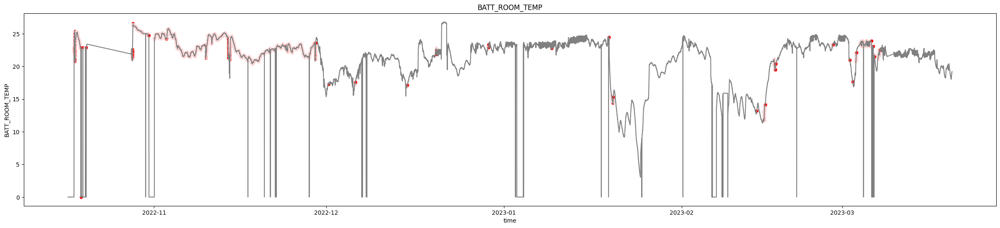

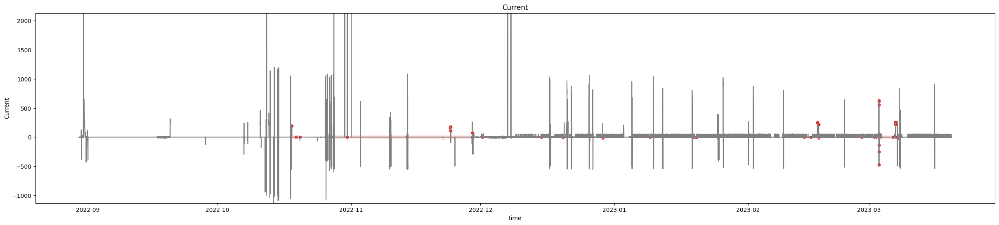

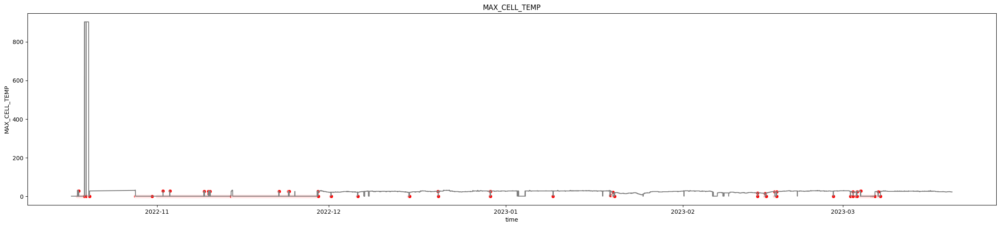

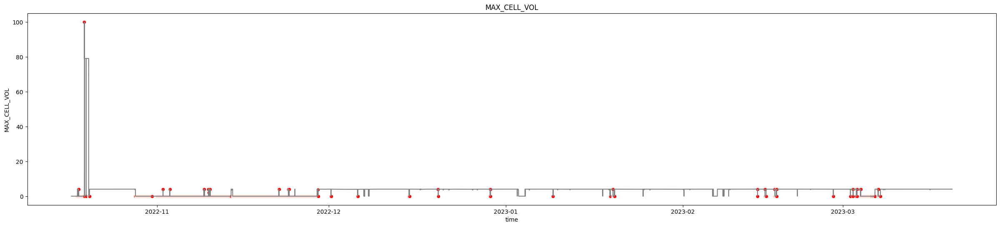

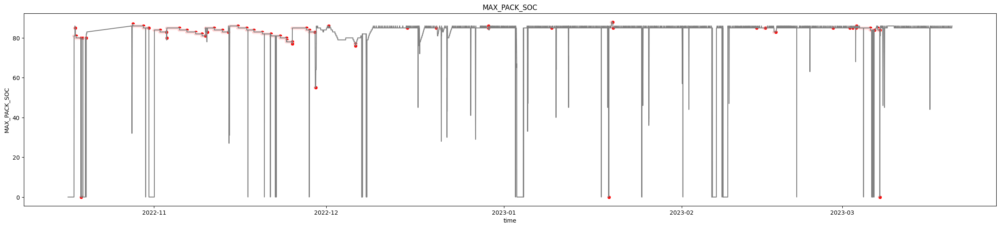

...

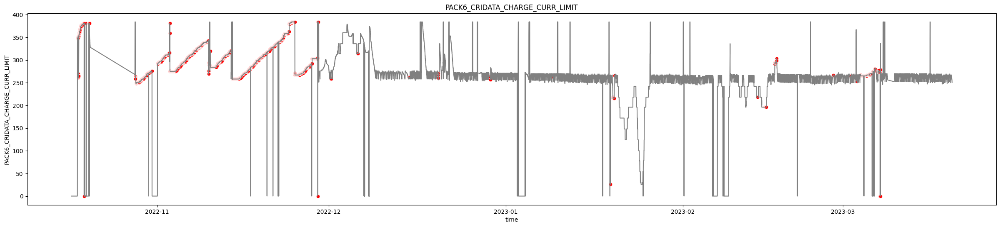

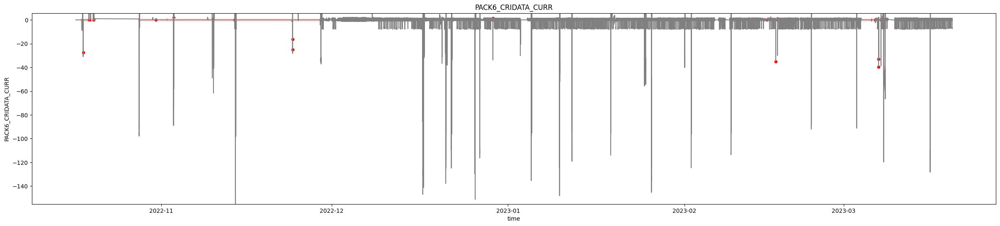

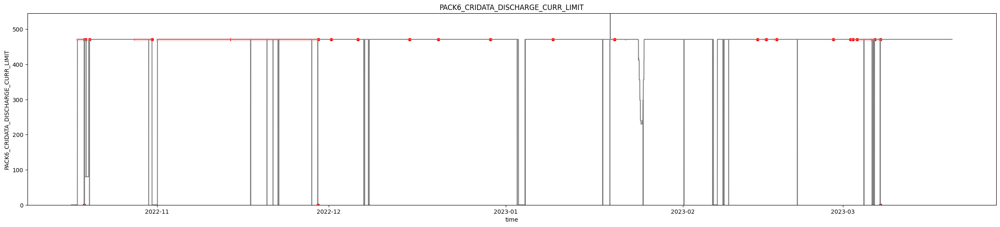

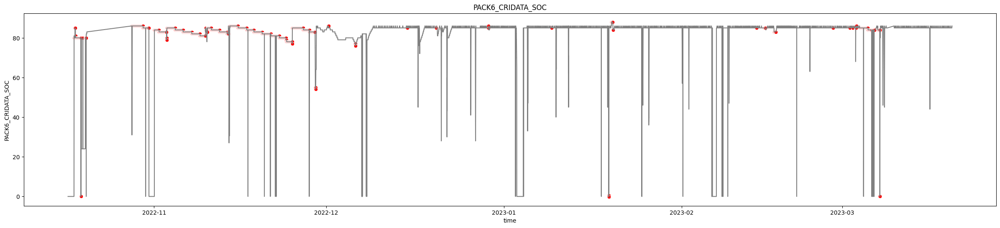

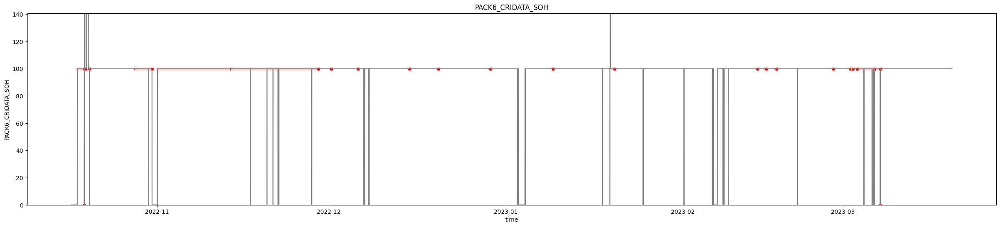

In [50]:
pack6_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK6_CRIDATA_AVG_CELL_TEMP',
 'PACK6_CRIDATA_AVG_CELL_VOL',
 'PACK6_CRIDATA_BATT_VOL',
 'PACK6_CRIDATA_BUS_VOL',
 'PACK6_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_CURR',
 'PACK6_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_SOC',
 'PACK6_CRIDATA_SOH']

for i in range(len(pack6_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack6_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_6_DISCONN'].fillna(False)], x='time', y=pack6_list[i], color='red', marker='o')
  y_range = data[pack6_list[i]].max() - data[pack6_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack6_list[i]].min(), 1.2 * data[pack6_list[i]].mean())
  else:
    pass
  plt.title(pack6_list[i])
  plt.show()

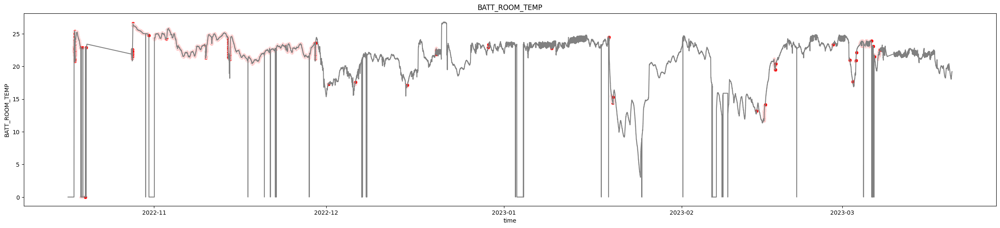

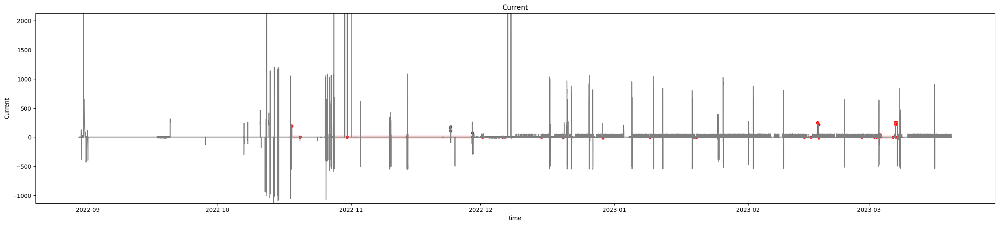

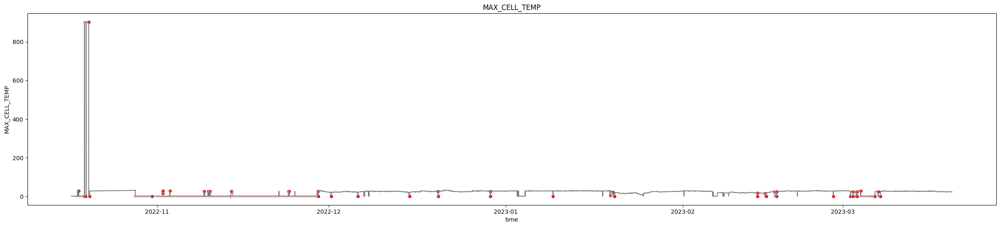

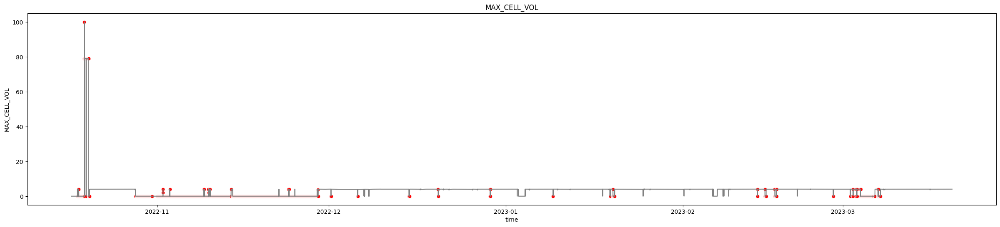

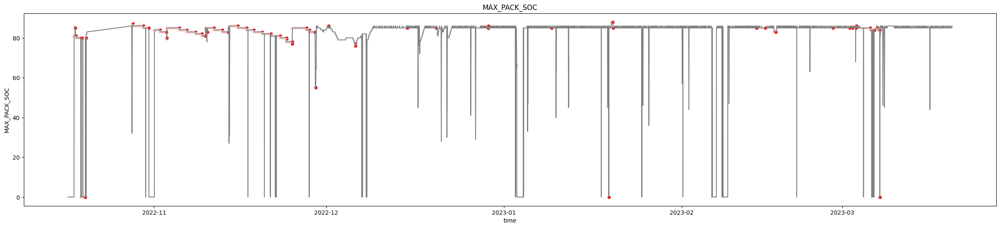

...

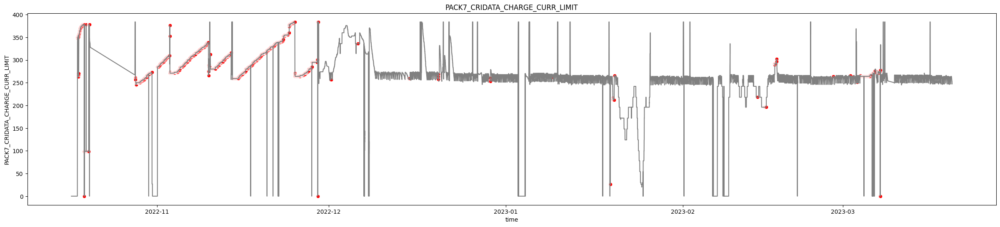

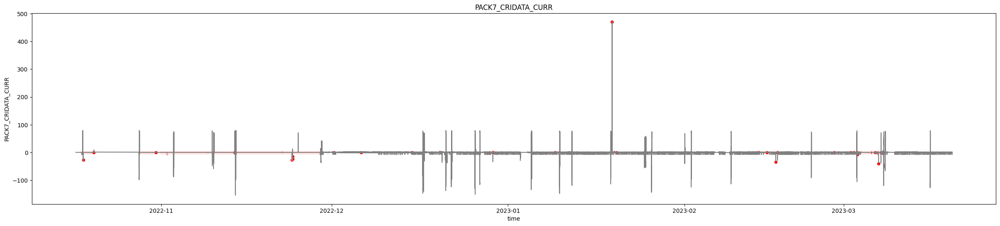

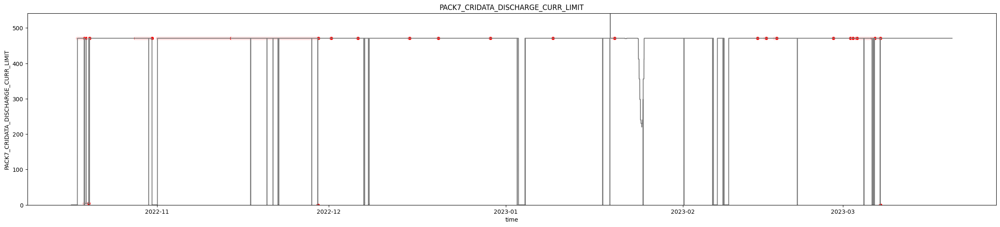

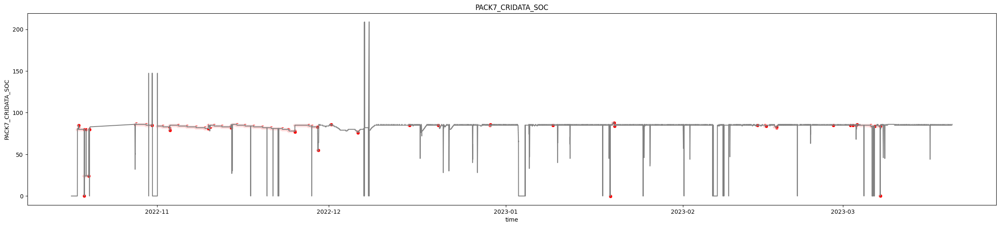

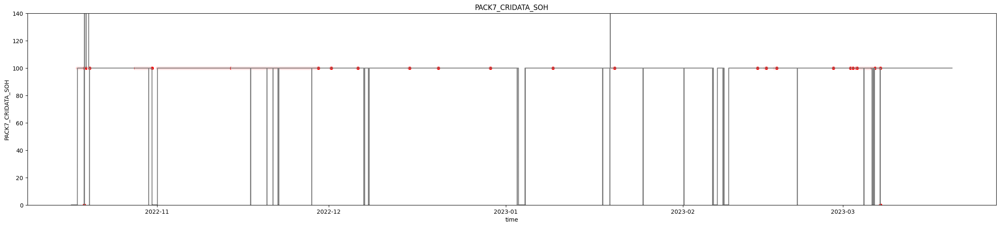

In [51]:
pack7_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK7_CRIDATA_AVG_CELL_TEMP',
 'PACK7_CRIDATA_AVG_CELL_VOL',
 'PACK7_CRIDATA_BATT_VOL',
 'PACK7_CRIDATA_BUS_VOL',
 'PACK7_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_CURR',
 'PACK7_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_SOC',
 'PACK7_CRIDATA_SOH']

for i in range(len(pack7_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack7_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_7_DISCONN'].fillna(False)], x='time', y=pack7_list[i], color='red', marker='o')
  y_range = data[pack7_list[i]].max() - data[pack7_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack7_list[i]].min(), 1.2 * data[pack7_list[i]].mean())
  else:
    pass
  plt.title(pack7_list[i])
  plt.show()

# WARN

In [52]:
from functools import reduce

a = data['BATT_PACK_1_WARN'].fillna(False)
b = data['BATT_PACK_2_WARN'].fillna(False)
c = data['BATT_PACK_3_WARN'].fillna(False)
d = data['BATT_PACK_4_WARN'].fillna(False)
e = data['BATT_PACK_5_WARN'].fillna(False)
f = data['BATT_PACK_6_WARN'].fillna(False)
g = data['BATT_PACK_7_WARN'].fillna(False)

lists = [a, b, c, d, e, f, g]

result = reduce(lambda x, y: [x_i or y_i for x_i, y_i in zip(x, y)], lists)

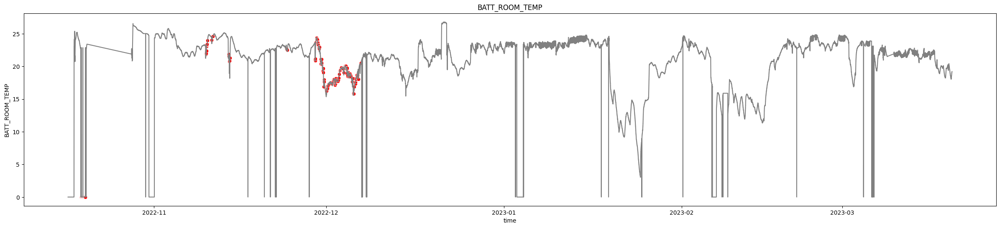

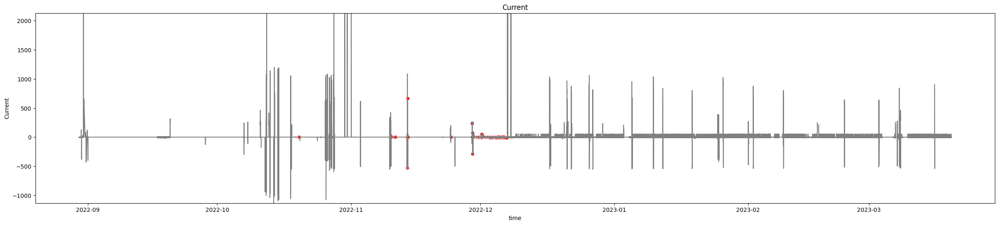

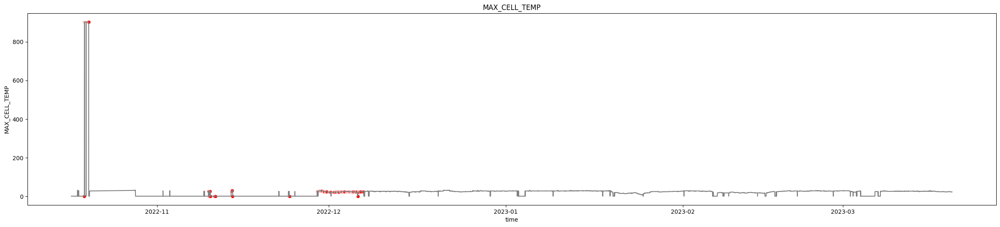

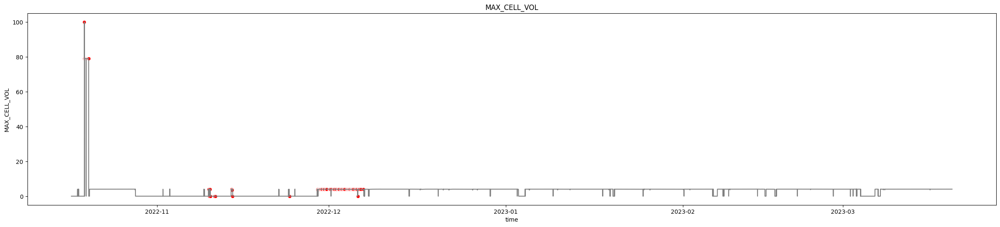

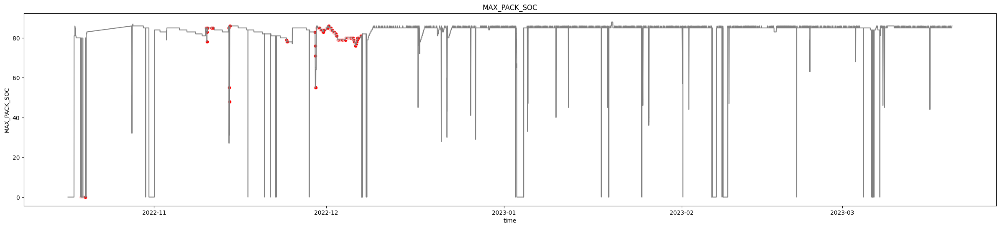

...

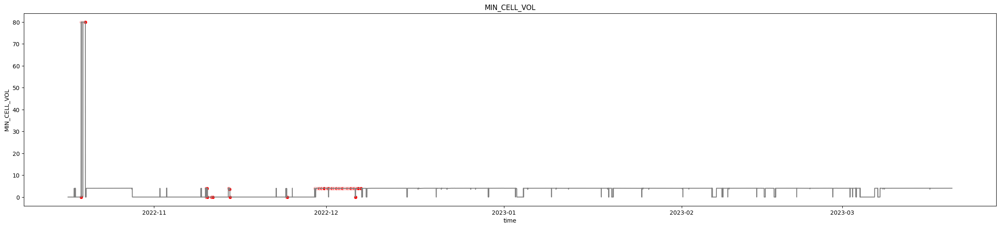

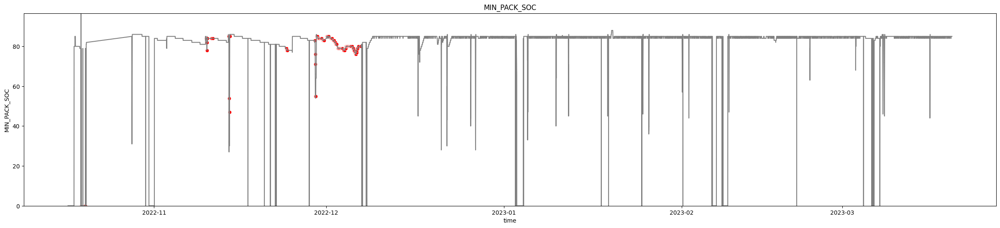

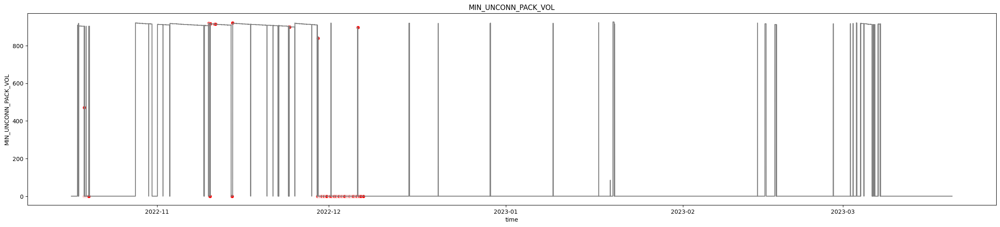

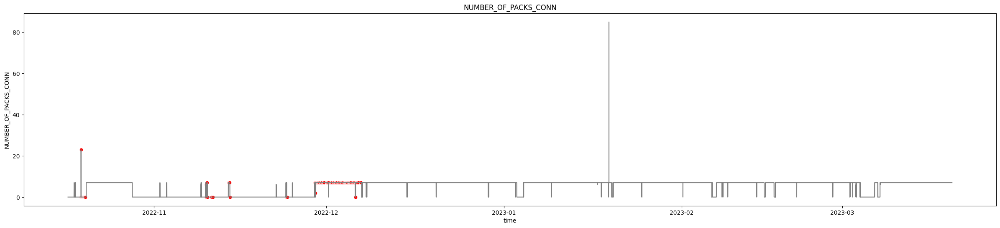

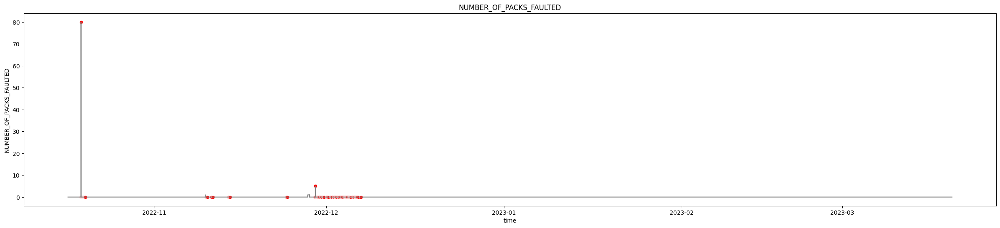

In [53]:
packs_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED']

for i in range(len(packs_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=packs_list[i], color='grey')
  sns.scatterplot(data=data[result], x='time', y=packs_list[i], color='red', marker='o')
  y_range = data[packs_list[i]].max() - data[packs_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[packs_list[i]].min(), 1.2 * data[packs_list[i]].mean())
  else:
    pass
  plt.title(packs_list[i])
  plt.show()

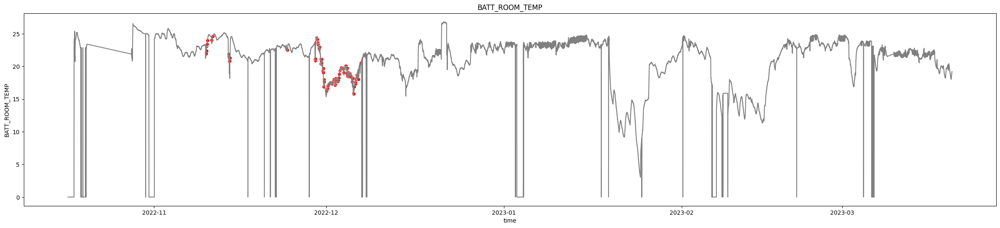

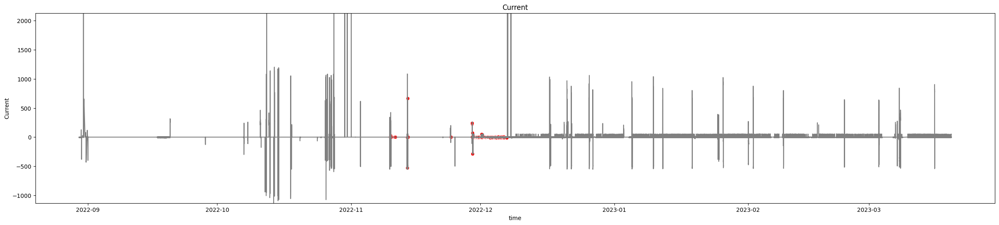

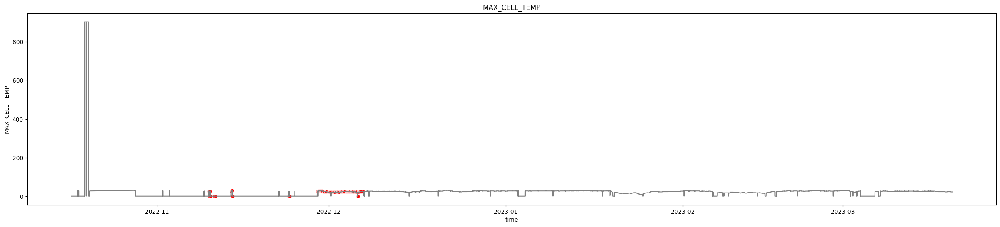

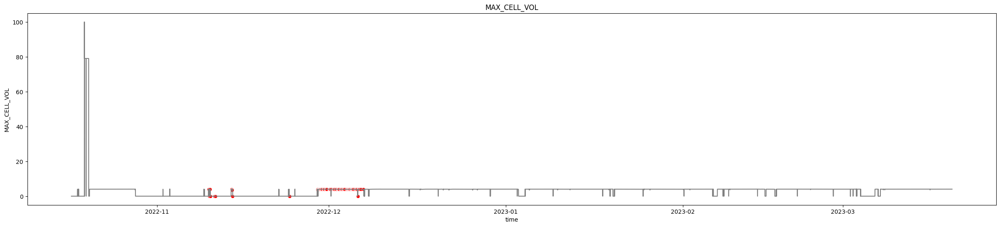

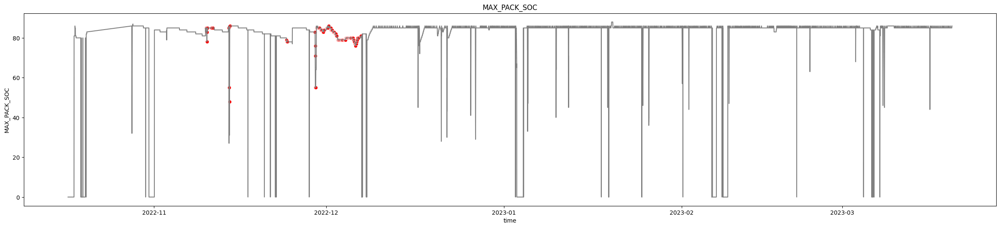

...

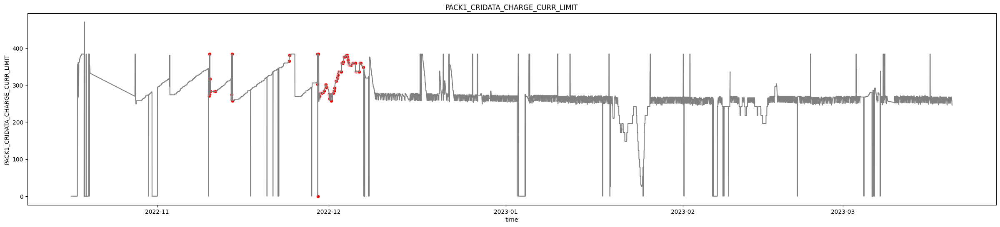

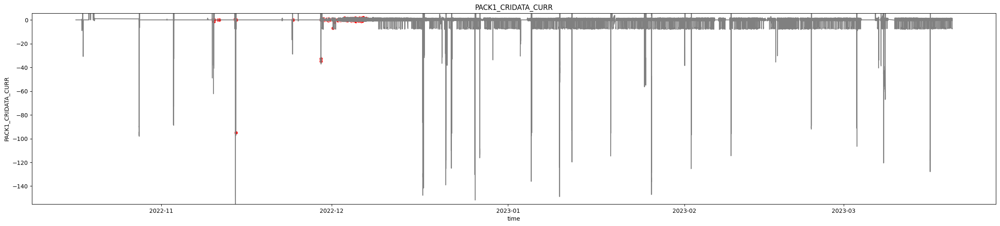

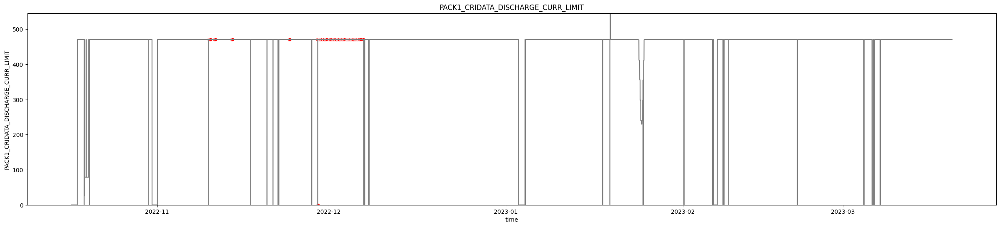

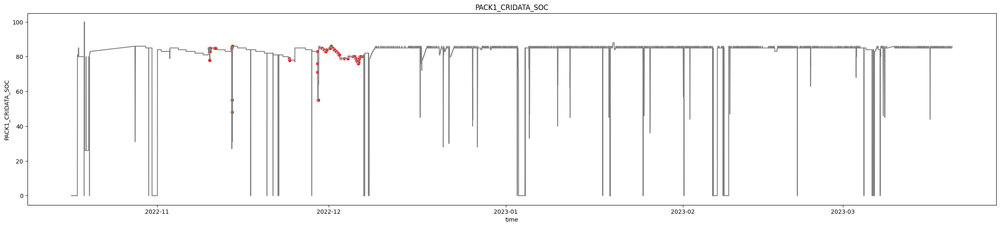

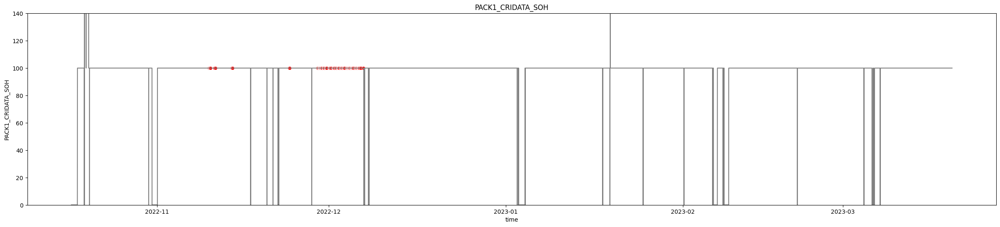

In [54]:
pack1_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK1_CRIDATA_AVG_CELL_TEMP',
 'PACK1_CRIDATA_AVG_CELL_VOL',
 'PACK1_CRIDATA_BATT_VOL',
 'PACK1_CRIDATA_BUS_VOL',
 'PACK1_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_CURR',
 'PACK1_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_SOC',
 'PACK1_CRIDATA_SOH']

for i in range(len(pack1_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack1_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_1_WARN'].fillna(False)], x='time', y=pack1_list[i], color='red', marker='o')
  y_range = data[pack1_list[i]].max() - data[pack1_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack1_list[i]].min(), 1.2 * data[pack1_list[i]].mean())
  else:
    pass
  plt.title(pack1_list[i])
  plt.show()

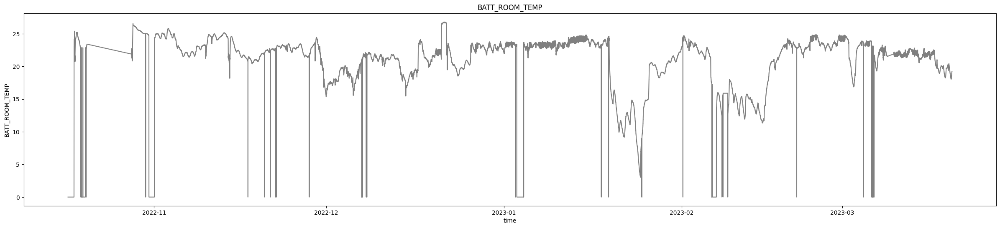

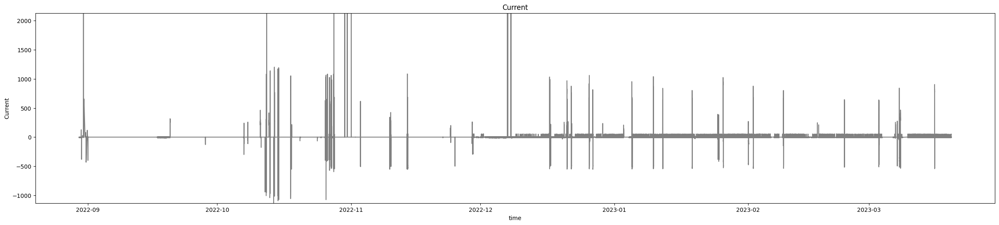

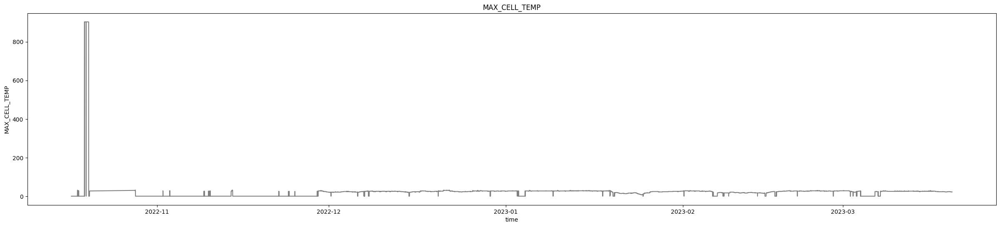

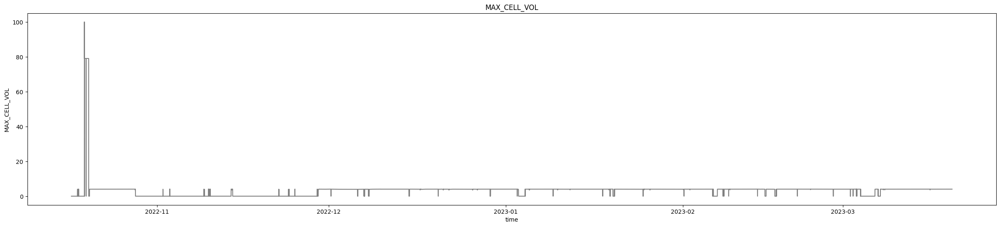

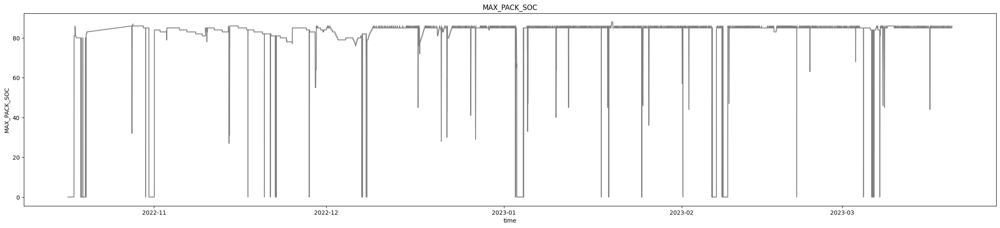

...

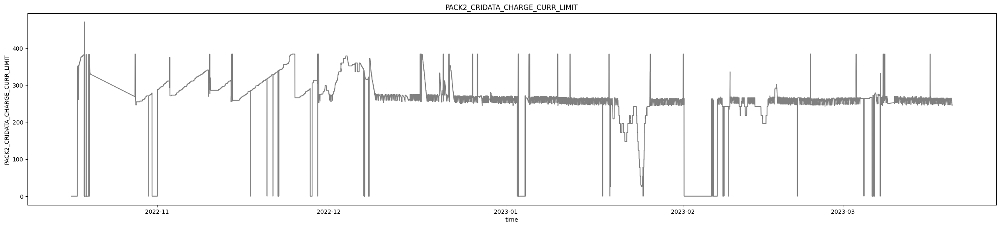

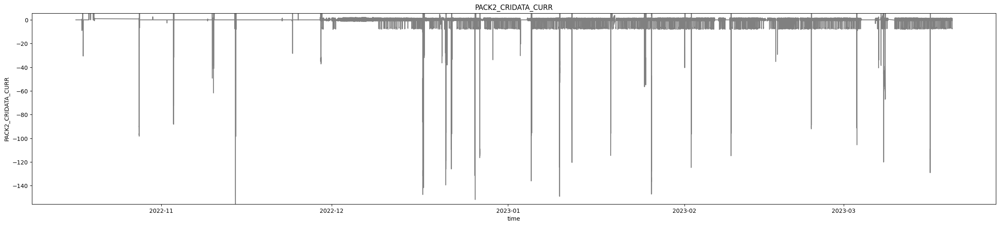

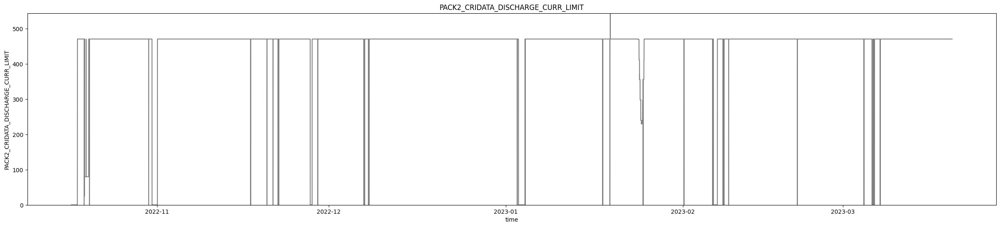

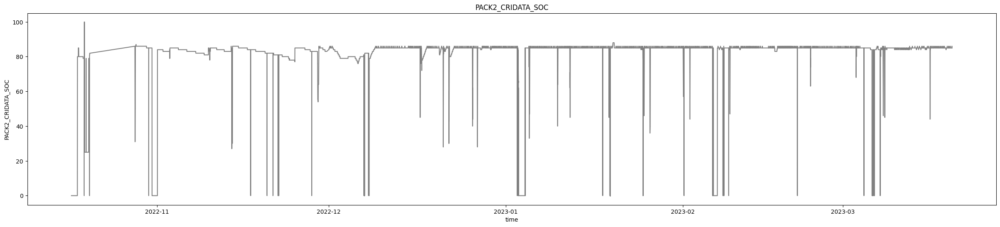

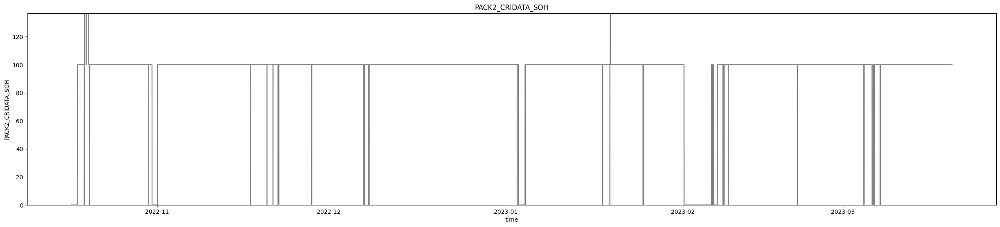

In [55]:
pack2_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK2_CRIDATA_AVG_CELL_TEMP',
 'PACK2_CRIDATA_AVG_CELL_VOL',
 'PACK2_CRIDATA_BATT_VOL',
 'PACK2_CRIDATA_BUS_VOL',
 'PACK2_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_CURR',
 'PACK2_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_SOC',
 'PACK2_CRIDATA_SOH']

for i in range(len(pack2_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack2_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_2_WARN'].fillna(False)], x='time', y=pack2_list[i], color='red', marker='o')
  y_range = data[pack2_list[i]].max() - data[pack2_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack2_list[i]].min(), 1.2 * data[pack2_list[i]].mean())
  else:
    pass
  plt.title(pack2_list[i])
  plt.show()

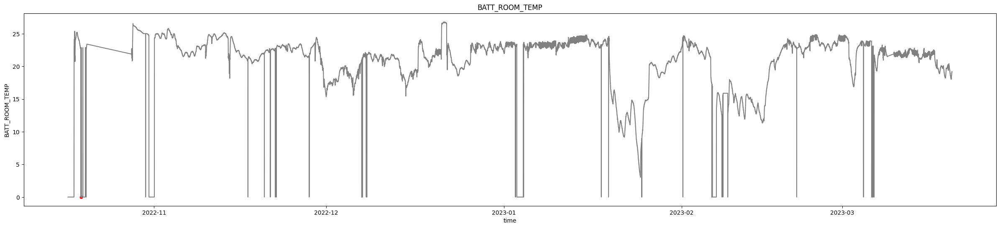

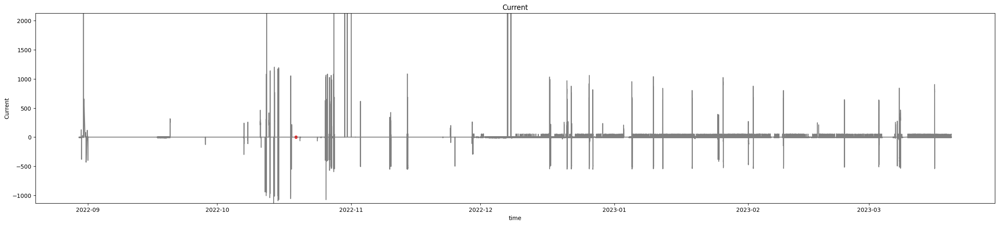

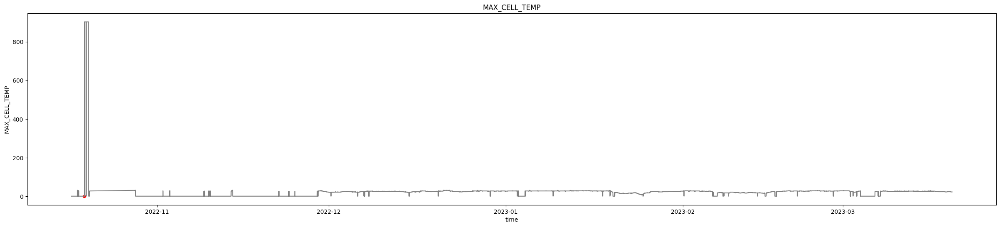

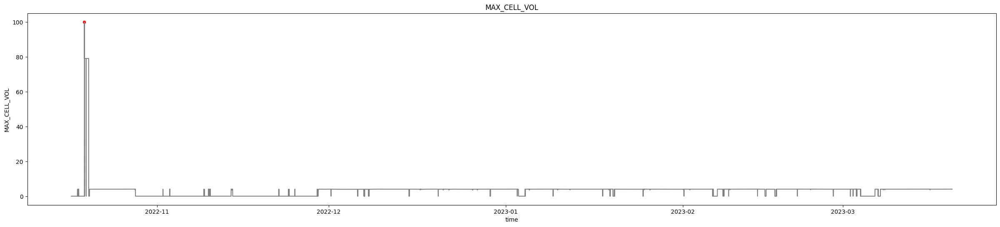

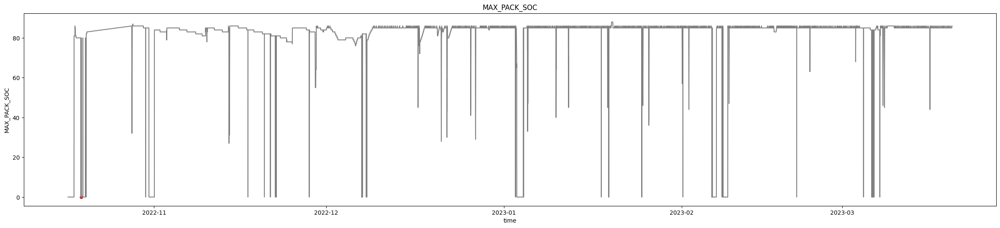

...

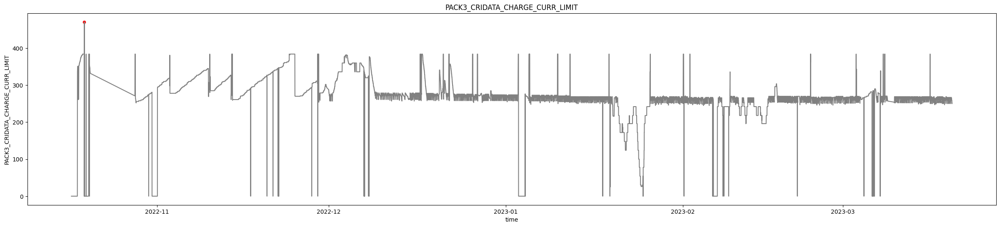

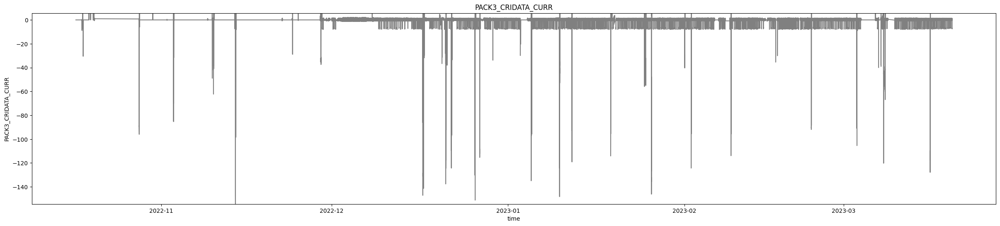

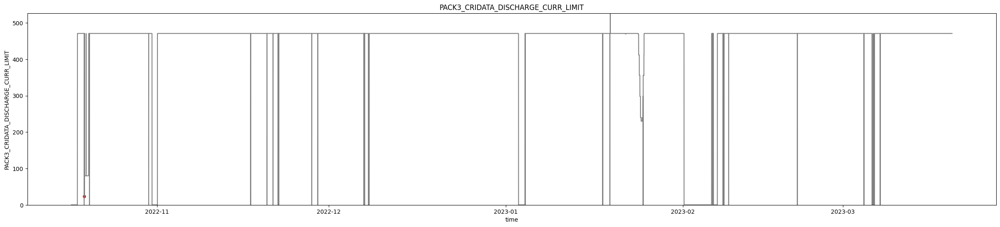

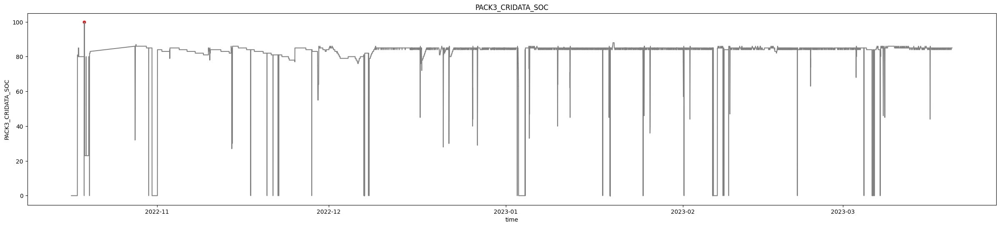

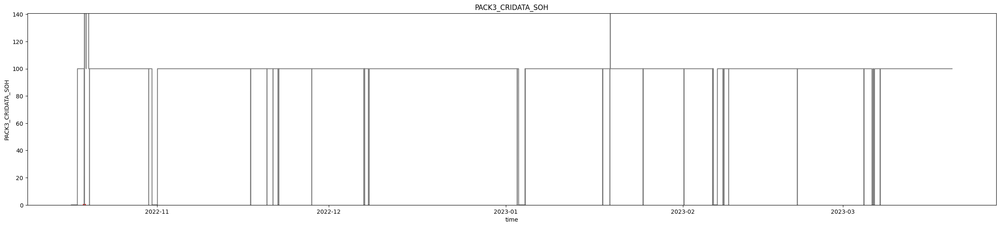

In [56]:
pack3_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK3_CRIDATA_AVG_CELL_TEMP',
 'PACK3_CRIDATA_AVG_CELL_VOL',
 'PACK3_CRIDATA_BATT_VOL',
 'PACK3_CRIDATA_BUS_VOL',
 'PACK3_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_CURR',
 'PACK3_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_SOC',
 'PACK3_CRIDATA_SOH']

for i in range(len(pack3_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack3_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_3_WARN'].fillna(False)], x='time', y=pack3_list[i], color='red', marker='o')
  y_range = data[pack3_list[i]].max() - data[pack3_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack3_list[i]].min(), 1.2 * data[pack3_list[i]].mean())
  else:
    pass
  plt.title(pack3_list[i])
  plt.show()

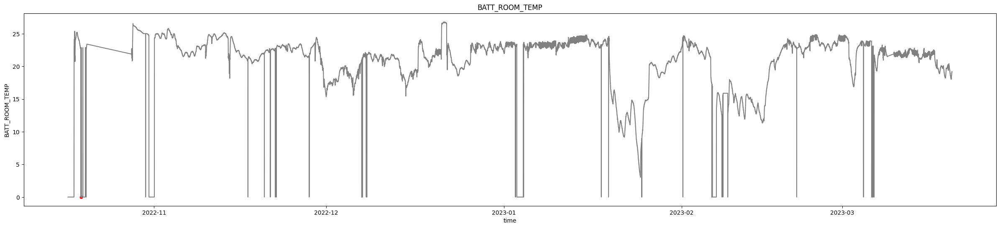

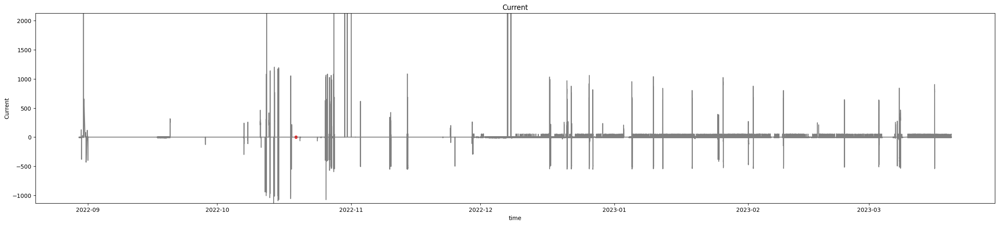

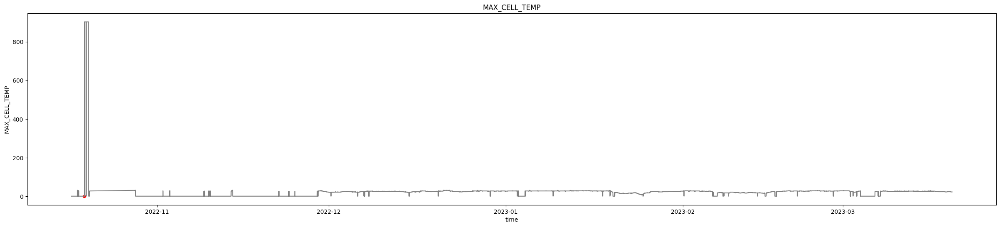

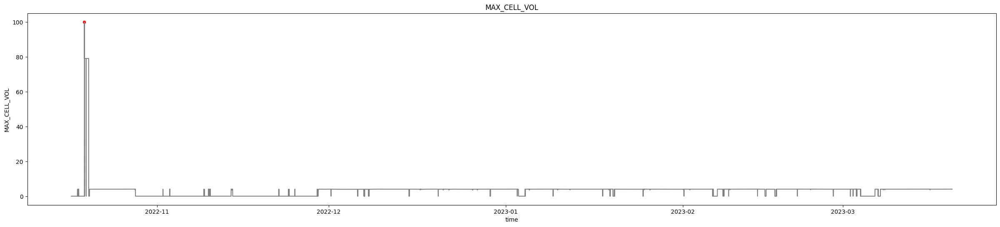

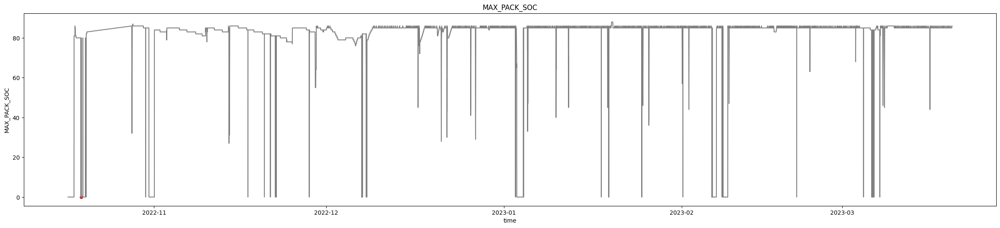

...

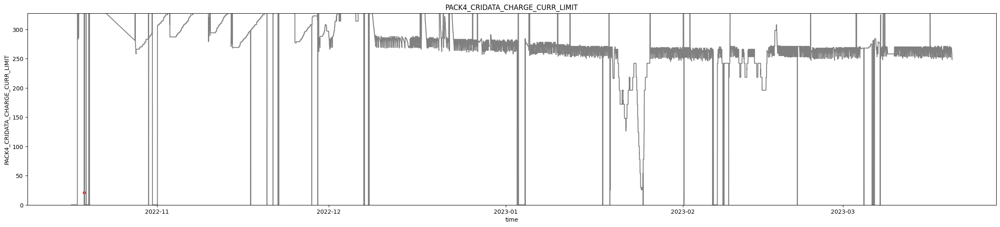

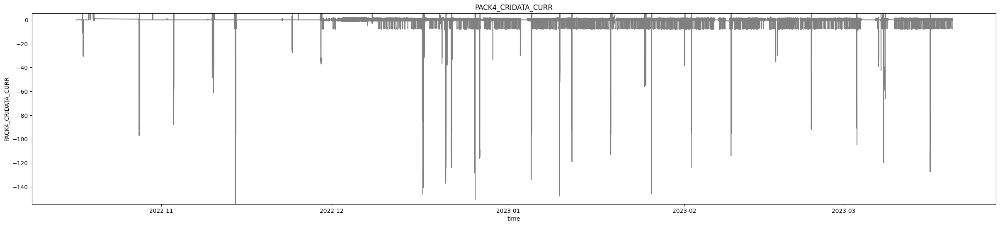

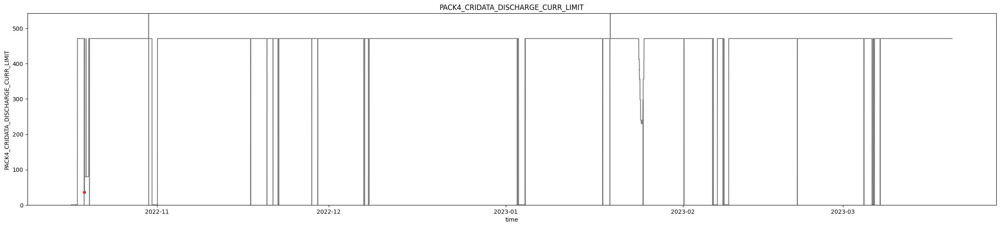

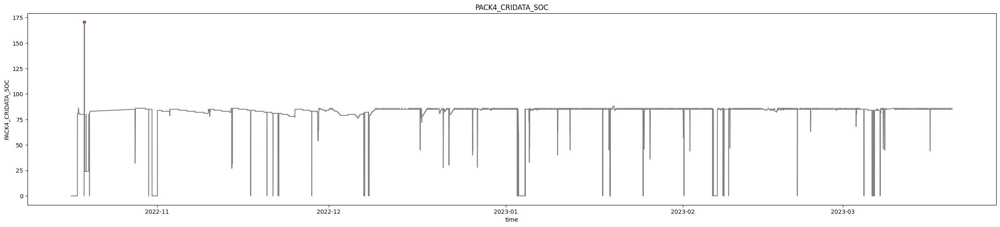

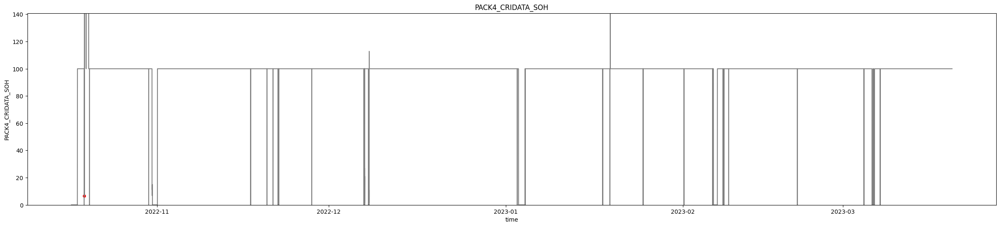

In [57]:
pack4_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK4_CRIDATA_AVG_CELL_TEMP',
 'PACK4_CRIDATA_AVG_CELL_VOL',
 'PACK4_CRIDATA_BATT_VOL',
 'PACK4_CRIDATA_BUS_VOL',
 'PACK4_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_CURR',
 'PACK4_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK4_CRIDATA_SOC',
 'PACK4_CRIDATA_SOH']

for i in range(len(pack4_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack4_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_4_WARN'].fillna(False)], x='time', y=pack4_list[i], color='red', marker='o')
  y_range = data[pack4_list[i]].max() - data[pack4_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack4_list[i]].min(), 1.2 * data[pack4_list[i]].mean())
  else:
    pass
  plt.title(pack4_list[i])
  plt.show()

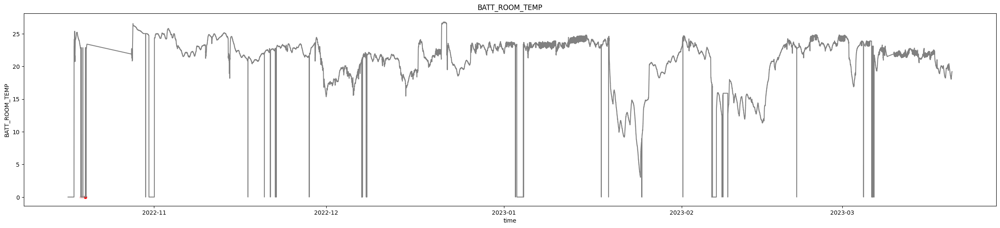

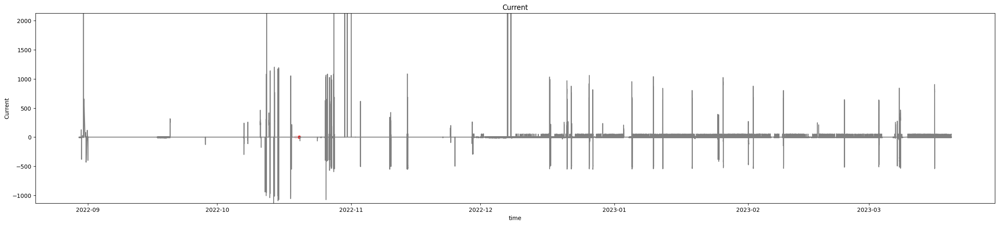

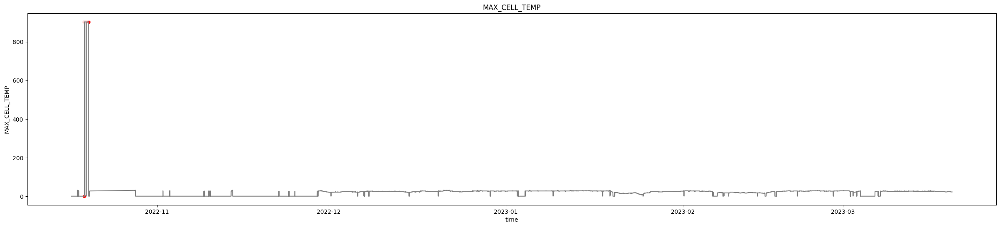

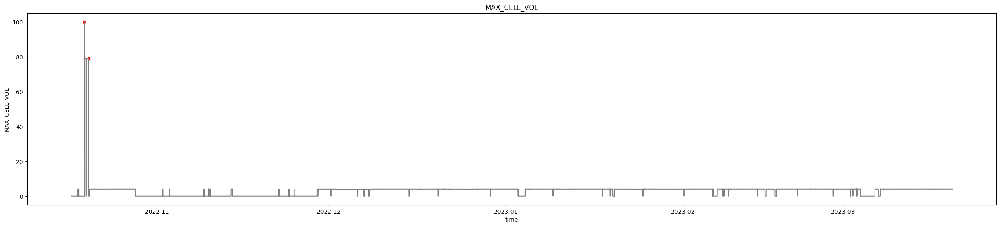

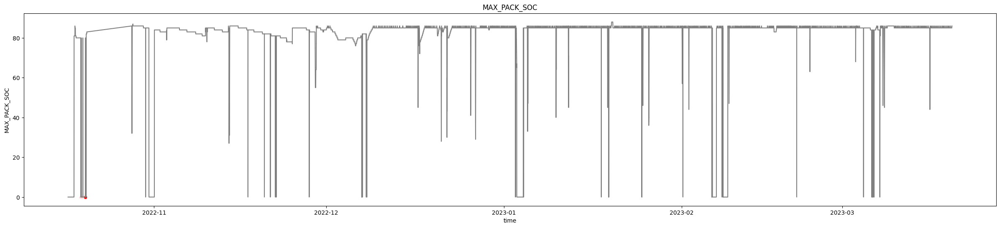

...

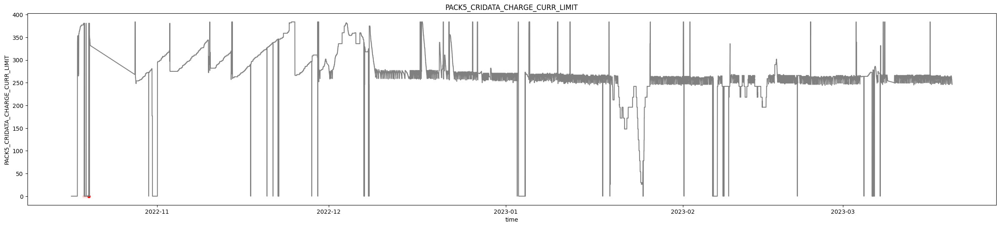

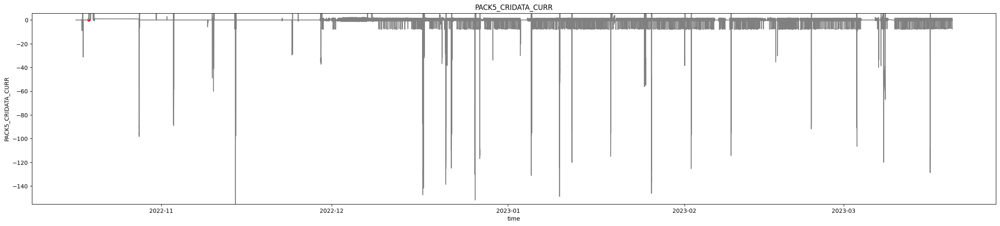

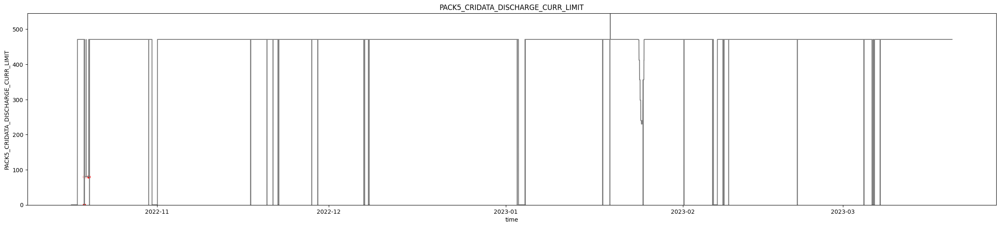

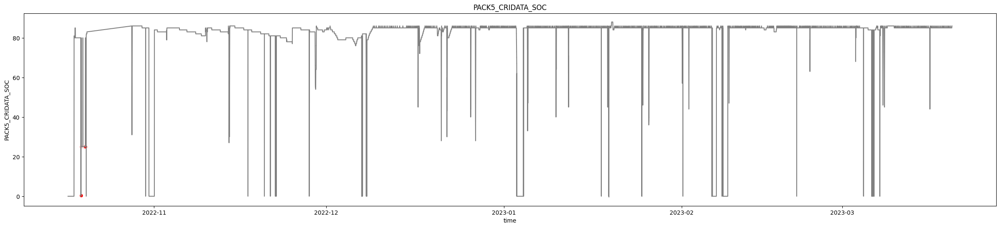

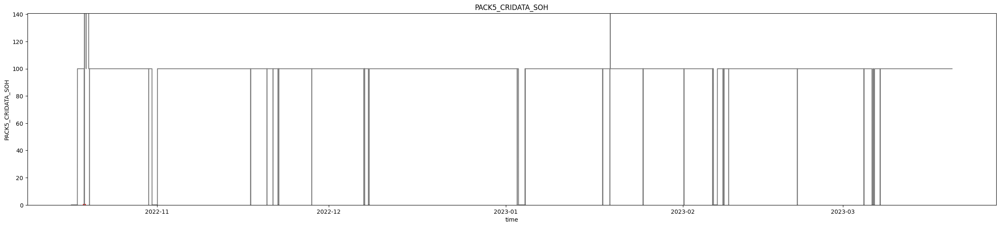

In [58]:
pack5_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK5_CRIDATA_AVG_CELL_TEMP',
 'PACK5_CRIDATA_AVG_CELL_VOL',
 'PACK5_CRIDATA_BATT_VOL',
 'PACK5_CRIDATA_BUS_VOL',
 'PACK5_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_CURR',
 'PACK5_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK5_CRIDATA_SOC',
 'PACK5_CRIDATA_SOH']

for i in range(len(pack5_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack5_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_5_WARN'].fillna(False)], x='time', y=pack5_list[i], color='red', marker='o')
  y_range = data[pack5_list[i]].max() - data[pack5_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack5_list[i]].min(), 1.2 * data[pack5_list[i]].mean())
  else:
    pass
  plt.title(pack5_list[i])
  plt.show()

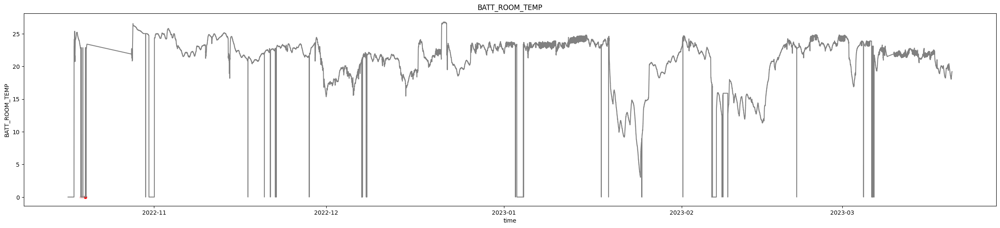

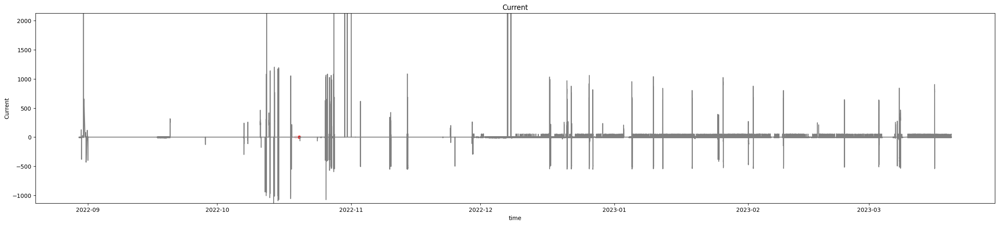

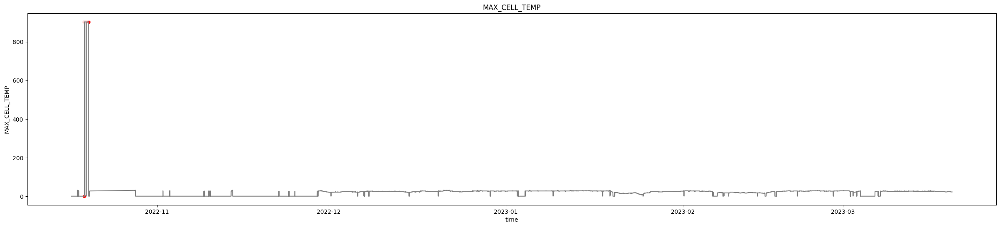

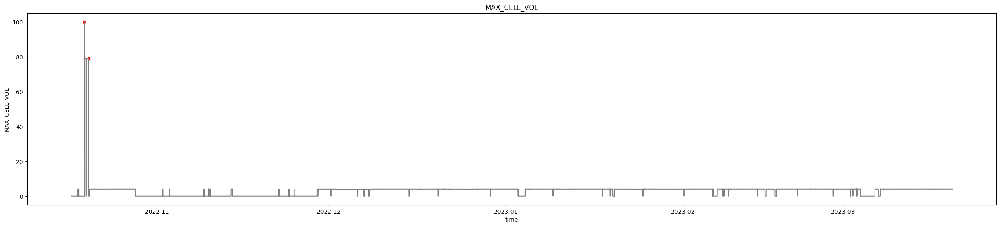

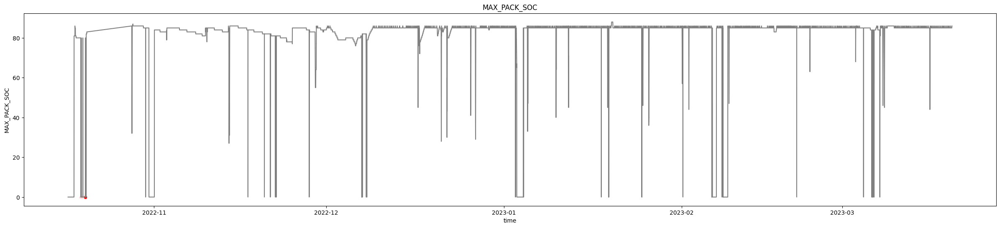

...

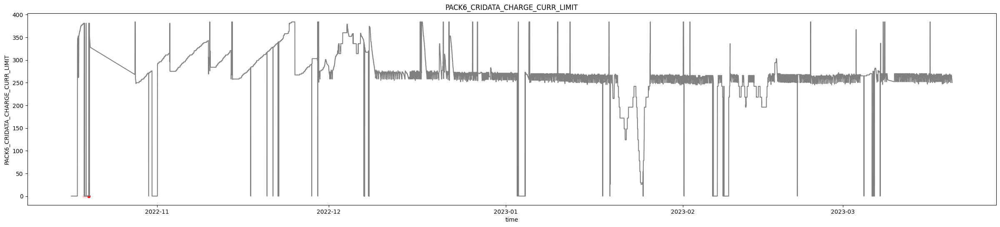

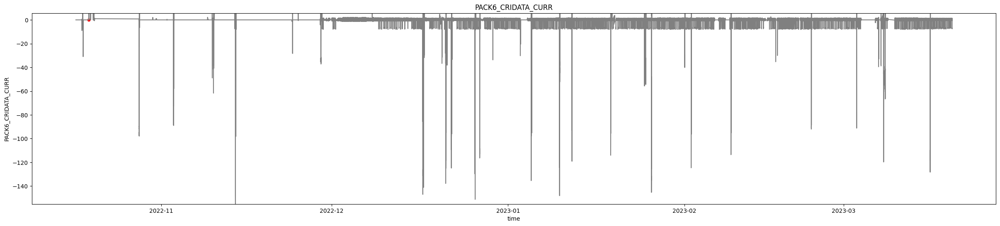

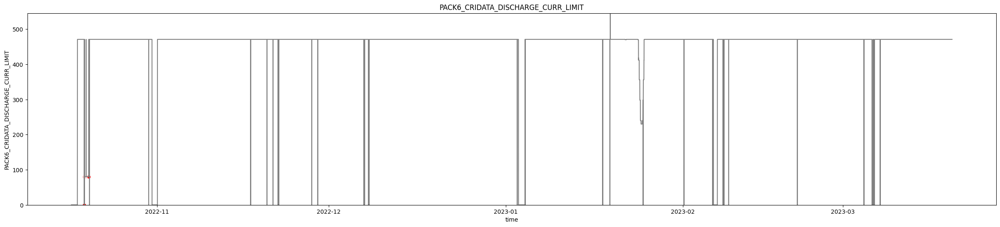

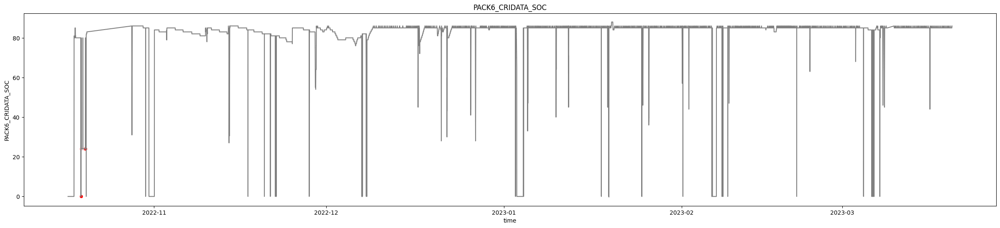

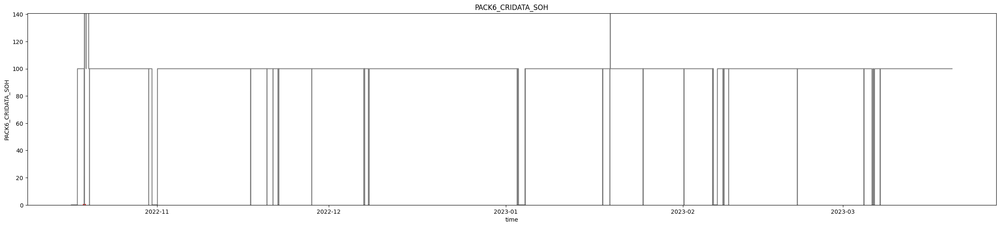

In [59]:
pack6_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK6_CRIDATA_AVG_CELL_TEMP',
 'PACK6_CRIDATA_AVG_CELL_VOL',
 'PACK6_CRIDATA_BATT_VOL',
 'PACK6_CRIDATA_BUS_VOL',
 'PACK6_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_CURR',
 'PACK6_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK6_CRIDATA_SOC',
 'PACK6_CRIDATA_SOH']

for i in range(len(pack6_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack6_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_6_WARN'].fillna(False)], x='time', y=pack6_list[i], color='red', marker='o')
  y_range = data[pack6_list[i]].max() - data[pack6_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack6_list[i]].min(), 1.2 * data[pack6_list[i]].mean())
  else:
    pass
  plt.title(pack6_list[i])
  plt.show()

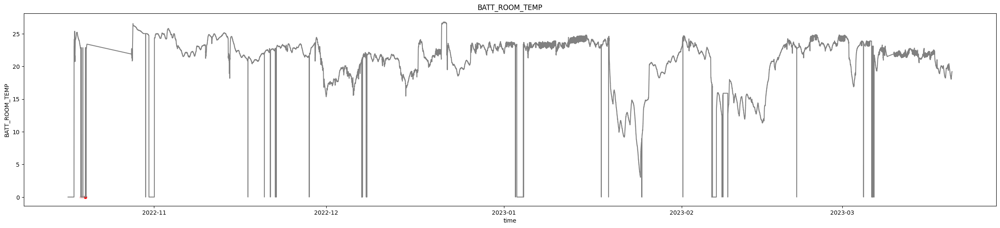

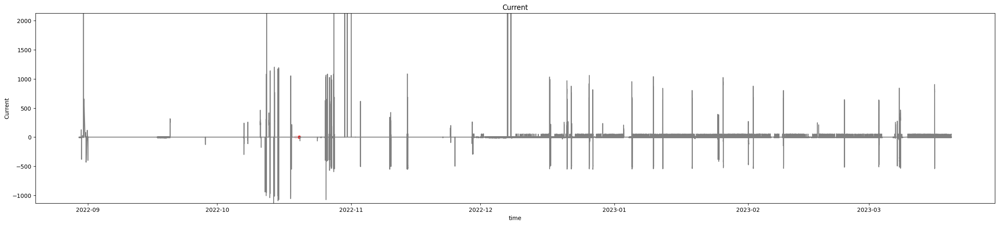

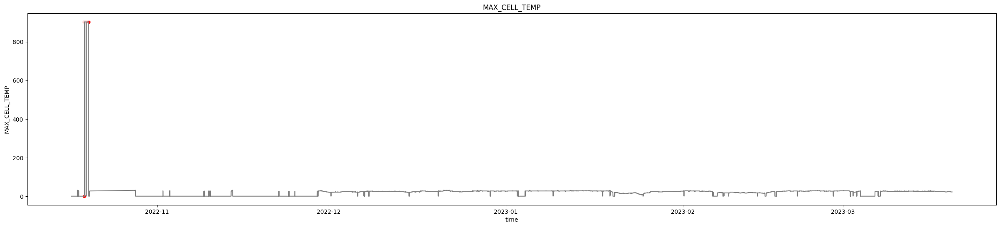

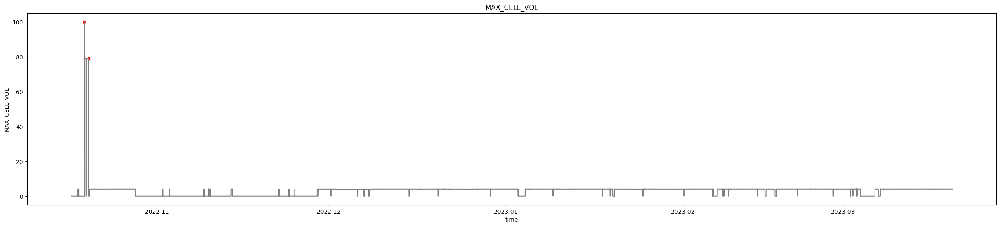

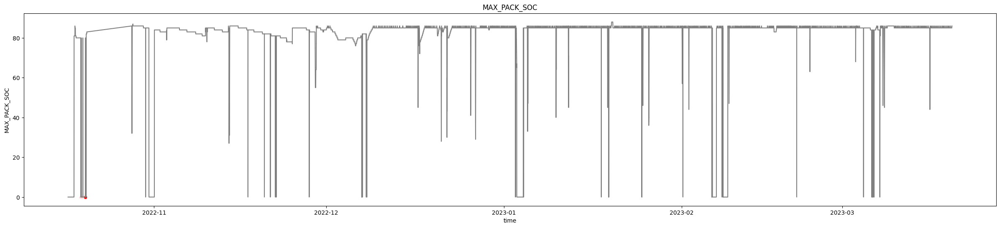

...

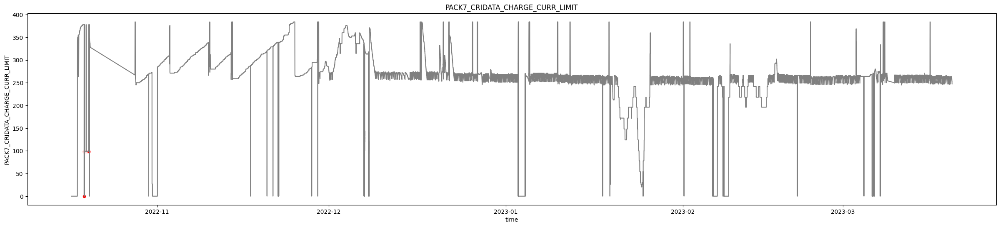

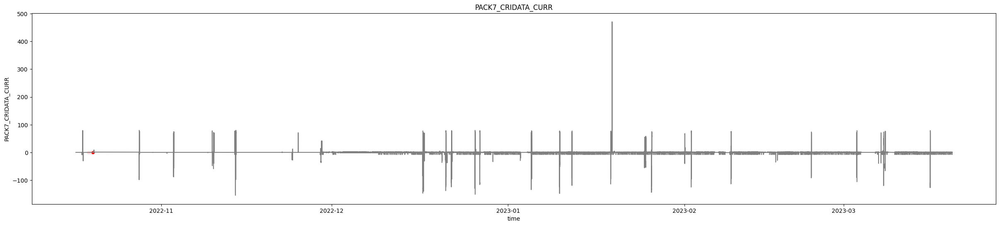

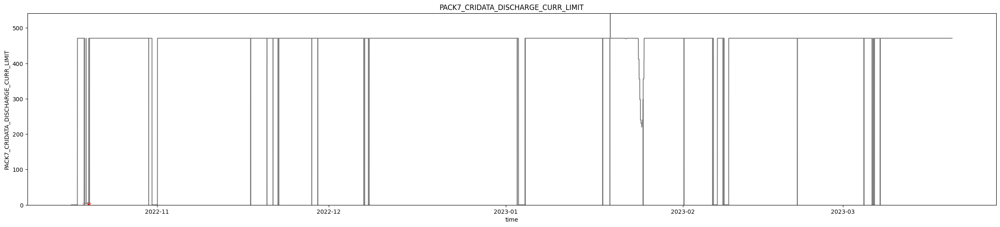

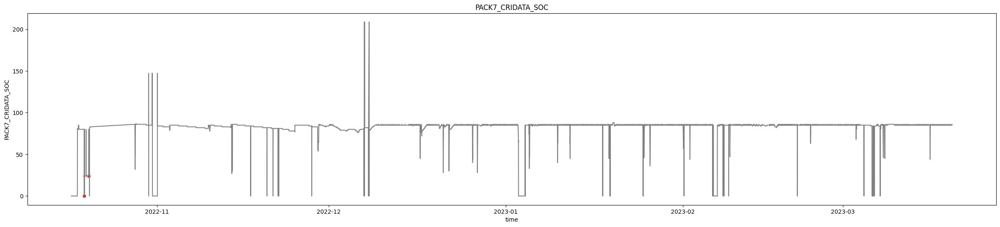

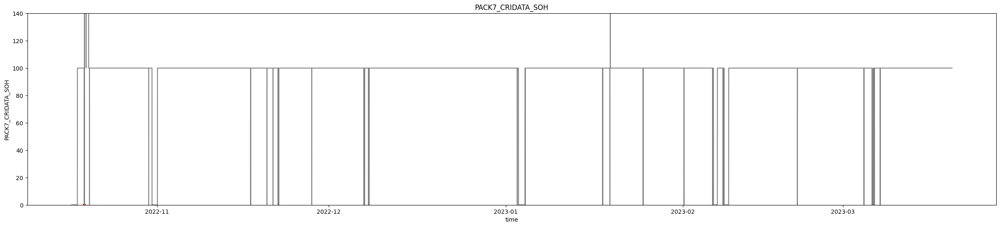

In [60]:
pack7_list = ['BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK7_CRIDATA_AVG_CELL_TEMP',
 'PACK7_CRIDATA_AVG_CELL_VOL',
 'PACK7_CRIDATA_BATT_VOL',
 'PACK7_CRIDATA_BUS_VOL',
 'PACK7_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_CURR',
 'PACK7_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK7_CRIDATA_SOC',
 'PACK7_CRIDATA_SOH']

for i in range(len(pack7_list)):

  plt.figure(figsize=(30, 6))
  ax = sns.lineplot(data=data, x='time', y=pack7_list[i], color='grey')
  sns.scatterplot(data=data[data['BATT_PACK_7_WARN'].fillna(False)], x='time', y=pack7_list[i], color='red', marker='o')
  y_range = data[pack7_list[i]].max() - data[pack7_list[i]].min()
  if y_range >= 1000:
    plt.ylim(data[pack7_list[i]].min(), 1.2 * data[pack7_list[i]].mean())
  else:
    pass
  plt.title(pack7_list[i])
  plt.show()

# 新增區段

In [ ]:
des = data.describe()
des

,AVG_PACK_SOC,AvgSOC,AvgSOH,BATT_ROOM_TEMP,Current,MAX_CELL_TEMP,MAX_CELL_VOL,MAX_PACK_SOC,MAX_UNCONN_PACK_VOL,MIN_CELL_TEMP,...,PACK7_CRIDATA_SOH,PACK_1_STATUS,PACK_2_STATUS,PACK_3_STATUS,PACK_4_STATUS,PACK_5_STATUS,PACK_6_STATUS,PACK_7_STATUS,Voltage,ITime
count,207796.000000,2.739610e+05,273961.000000,207796.000000,2.739610e+05,207796.000000,207796.000000,207796.000000,207796.000000,207796.000000,...,207795.000000,207796.000000,207796.000000,207796.000000,207796.000000,207796.000000,207796.000000,207796.000000,273961.000000,2.739610e+05
mean,81.221869,1.773910e+03,58.085927,20.519157,1.773826e+03,22.213513,3.324201,80.822003,223.953117,14.704499,...,116.769888,0.002069,0.002536,4.718103,0.002536,0.419984,0.569867,0.035626,3121.465811,1.670943e+18
std,15.580271,5.215529e+05,57.944050,5.078350,5.327049e+05,64.760203,5.768186,16.639031,392.431491,9.610119,...,279.042911,0.640069,1.033372,65.127621,1.033372,5.854998,12.368655,5.698347,2781.665774,4.779482e+15
min,0.000000,0.000000e+00,0.000000,0.000000,-1.131400e+03,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.661818e+18
25%,84.000000,0.000000e+00,0.000000,19.780500,-4.049990e+00,0.000000,0.000000,84.000000,0.000000,0.000000,...,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,918.000000,1.666804e+18
50%,85.000000,8.200000e+01,100.000000,22.096800,0.000000e+00,24.000000,4.026000,85.000000,0.000000,20.000000,...,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,920.000000,1.670959e+18
75%,85.000000,8.500000e+01,100.000000,23.305300,0.000000e+00,26.000000,4.035000,85.000000,80.000000,22.000000,...,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6553.000000,1.675070e+18
max,904.000000,1.576700e+08,15911.533333,26.796600,1.610400e+08,903.000000,100.000000,88.000000,928.000000,80.000000,...,3962.000000,274.000000,471.000000,904.000000,471.000000,471.000000,3963.000000,921.000000,6554.000000,1.679280e+18


In [ ]:
integers = list(des.columns)
integers

['AVG_PACK_SOC',
 'AvgSOC',
 'AvgSOH',
 'BATT_ROOM_TEMP',
 'Current',
 'MAX_CELL_TEMP',
 'MAX_CELL_VOL',
 'MAX_PACK_SOC',
 'MAX_UNCONN_PACK_VOL',
 'MIN_CELL_TEMP',
 'MIN_CELL_VOL',
 'MIN_PACK_SOC',
 'MIN_UNCONN_PACK_VOL',
 'NUMBER_OF_PACKS_CONN',
 'NUMBER_OF_PACKS_FAULTED',
 'PACK1_CRIDATA_AVG_CELL_TEMP',
 'PACK1_CRIDATA_AVG_CELL_VOL',
 'PACK1_CRIDATA_BATT_VOL',
 'PACK1_CRIDATA_BUS_VOL',
 'PACK1_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_CURR',
 'PACK1_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK1_CRIDATA_SOC',
 'PACK1_CRIDATA_SOH',
 'PACK2_CRIDATA_AVG_CELL_TEMP',
 'PACK2_CRIDATA_AVG_CELL_VOL',
 'PACK2_CRIDATA_BATT_VOL',
 'PACK2_CRIDATA_BUS_VOL',
 'PACK2_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_CURR',
 'PACK2_CRIDATA_DISCHARGE_CURR_LIMIT',
 'PACK2_CRIDATA_SOC',
 'PACK2_CRIDATA_SOH',
 'PACK3_CRIDATA_AVG_CELL_TEMP',
 'PACK3_CRIDATA_AVG_CELL_VOL',
 'PACK3_CRIDATA_BATT_VOL',
 'PACK3_CRIDATA_BUS_VOL',
 'PACK3_CRIDATA_CHARGE_CURR_LIMIT',
 'PACK3_CRIDATA_CURR',
 'PACK3_CRIDATA_DISCHARGE_CURR_LIM

In [ ]:
column_info = data.dtypes.reset_index()
column_info.columns = ['column', 'type']
for i in range(len(column_info)):
  if column_info['type'][i] == 'object':
    print(column_info['column'][i])

BATT_PACK_1_DISCONN
BATT_PACK_1_FAULT
BATT_PACK_1_WARN
BATT_PACK_2_DISCONN
BATT_PACK_2_FAULT
BATT_PACK_2_WARN
BATT_PACK_3_DISCONN
BATT_PACK_3_FAULT
BATT_PACK_3_WARN
BATT_PACK_4_DISCONN
BATT_PACK_4_FAULT
BATT_PACK_4_WARN
BATT_PACK_5_DISCONN
BATT_PACK_5_FAULT
BATT_PACK_5_WARN
BATT_PACK_6_DISCONN
BATT_PACK_6_FAULT
BATT_PACK_6_WARN
BATT_PACK_7_DISCONN
BATT_PACK_7_FAULT
BATT_PACK_7_WARN
RunningState
valuestreamname
